# Table of contents

# Introduction

Omdena Local Chapter Challenges are not a competition or hackathon, but a real-world project that will grow your experience to a new level.
A unique learning experience with the potential to make an impact through the outcome of the project. You will go through an entire data science project lifecycle. This covers problem scoping, data collection, and preparation, as well as modeling for deployment.
And the best part is that you will join the global and collaborative community of Omdena with tons of benefits to accelerate your career.

**The mission**
- Since its founding in May 2019, the platform has grown to more than 15000 collaborators in over 120 countries, established over 175 local chapters in 70 countries, and doesn’t stop growing.
- During this period, Omdena has worked with 200+ organizations on over 535 projects. Detecting wildfires in Brazil, fighting malaria outbreaks in Africa, and improving solar adoption in Singapore are just a tiny part of them.
- We empower the strength of the worldwide AI community and we work to bring all the talents together to develop and deploy solutions to real problems.

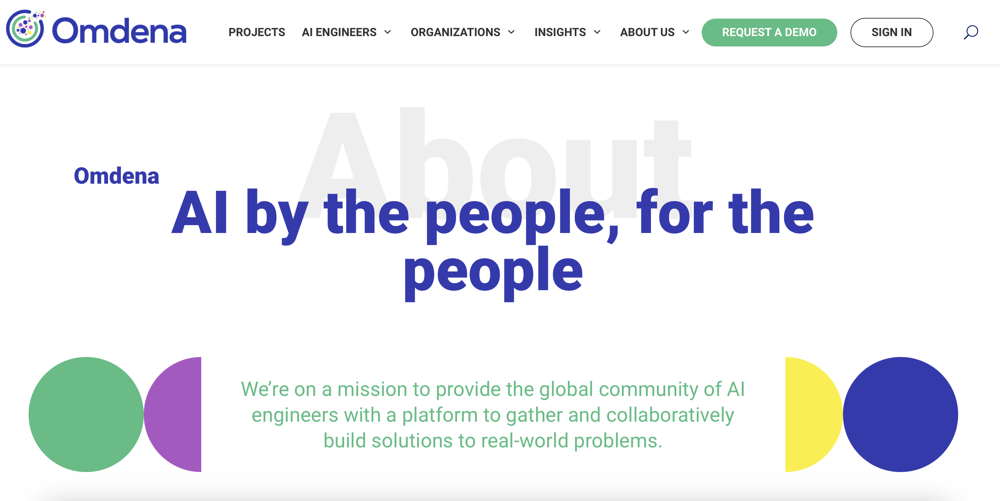

# Project Overview

Machine learning-based analysis of air quality data can provide valuable insights into the patterns, trends, and underlying factors contributing to air pollution in Gurugram. By leveraging machine learning algorithms, it is possible to develop predictive models, identify sources of pollution, and assess the effectiveness of control measures. This information can then be used to inform policy decisions and develop targeted interventions to reduce air pollution in Gurugram and other cities in India and create awareness among the general public about the severity of air pollution in the city and its effects on their health and well-being. 

The goals of this project are: 
- Identifying possible data sources
- Relevant Data Collection
- Data Cleaning and Preprocessing
- Developing AQI calculation strategy
- Evaluating trends and patterns in AQI and other parameters
- Applying machine learning modeling
- Model training and evaluation
- Deploying model as an API using FastAPI/Flask


Find more information about this project on https://omdena.com/projects/analyzing-air-quality-in-gurugram-using-machine-learning/


### Importing Libraries and settings

In [1]:
# For data cleaning and EDA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import random as rnd
import plotly.express as px 

# Machine Learning algorithms
from sklearn import datasets
from sklearn import tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.svm import SVC

import datetime

# To print multiple outputs in a single cell

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Plot settings

sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('retina')
%config InlineBackend.figure_format = 'retina'
plt.style.use('tableau-colorblind10')

# 1. Data collection

The aim of the project is to predict Air Quality Index for which we need features such as particulate matters like PM2.5 & PM10, pollutants & chemical compounds like CO, NO2, SO2 etc. We found websites like aqicn.org API, AccuWeather API, IQair API and others. We faced some issues like these APIs provide only current data but not historical data. IQair provides historical data for many states, but Gurugram (Haryana) wasn't available. We then found few government data sources like CPCB (Central Pollution Control Board) and the below websites
- https://airquality.cpcb.gov.in/ccr/#/caaqm-dashboard-all/caaqm-landing 
- https://data.gov.in/resource/real-time-air-quality-index-various-locations

We had a choice of selecting the range of time like 15 minutes, 30 minutes, 1 hour, 4 hours, 8 hours, 24 hours, annual average. We have chosen 1 hour as the time range because the data points would be increased if we consider a lesser time range. More data is always a good choice. Gurugram also had 4 stations like Vikas Sadan, Sector 51, NISE, Teri Gram. We have collected 4 separate data files for 4 stations. There were many missing columns in few stations. We also had data from 2015 to 2020 as a separate file from another source, which had AQI calculated already. 


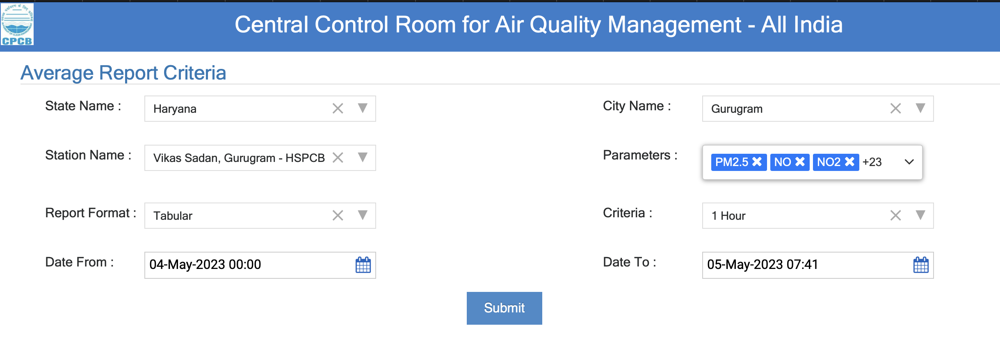

# 2. Data preprocessing

We have 4 separate files for 4 stations, also with one file that has AQI calculated already. The 4 separate files had formatting issue after downloading them. There are many columns in the data frame, but we could see only 5 of them as columns. The remaining columns were wrapped as rows. So, we had to first transform it into a proper data frame that has all the columns by splitting each dataframe into multiple dataframes and then again merge them. Repeat this for all the 4 stations. Below is the sample illustration of how we preprocessed the data.

Now, we had all the columns in the dataframes for 4 stations separately. **The task** is now to merge them again into a single dataframe that has all the 4 stations along with the data that is from 2015 to 2020.

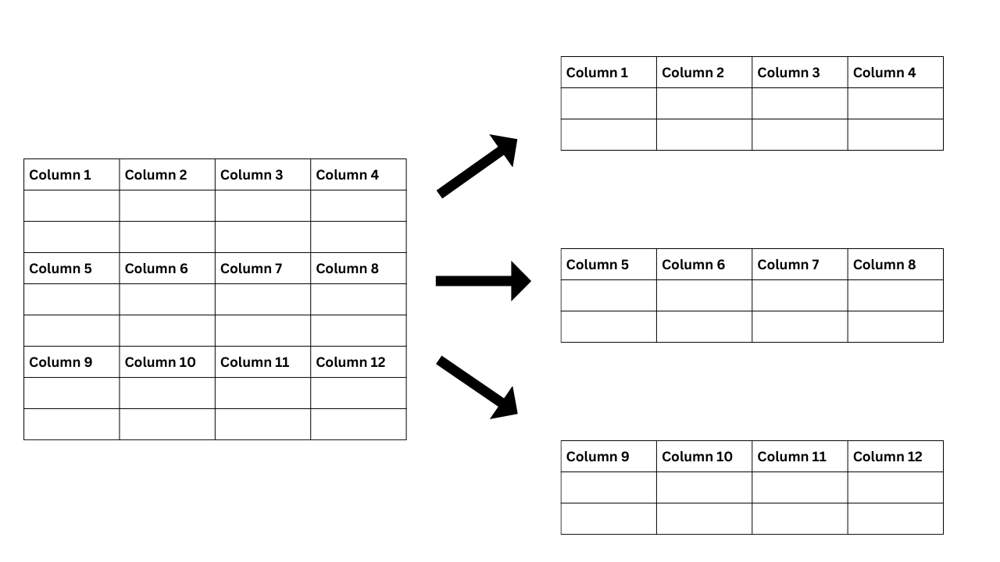

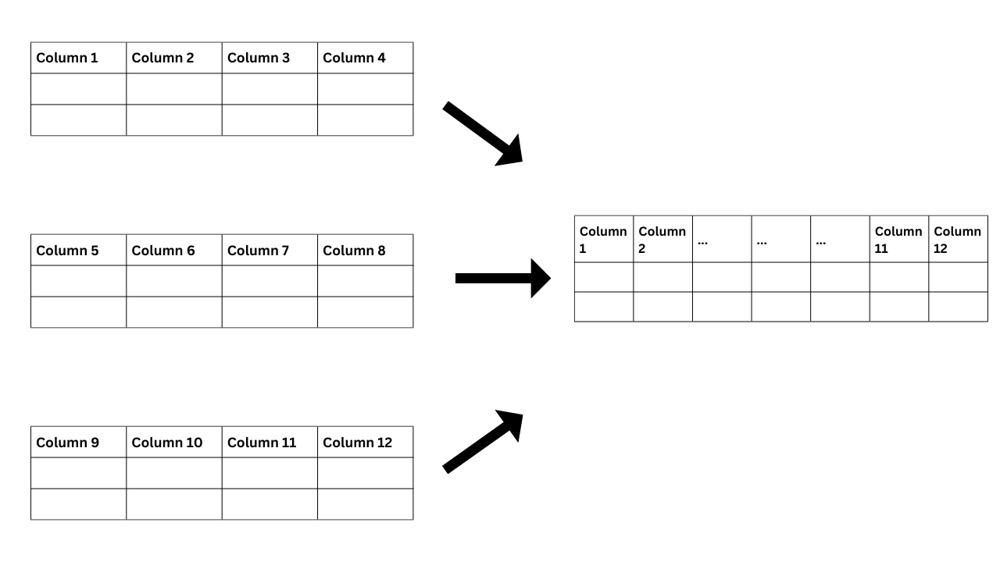

### Cleaning the data station-wise
- Vikas Sadan
- Sector 51
- Teri Gram
- NISE

### Vikas Sadan

In [4]:
# Reading the downloaded dataset

df_vikas_sadan = pd.read_excel("../../data/preprocessing_data/Vikas Sadan Hourly data from 4 March '20 to 26 March '23.xlsx")
df_vikas_sadan

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98
...,...,...,...,...,...,...,...
214558,26-03-2023 03:00,26-03-2023 04:00,0,0,NaN,NaN,NaN
214559,26-03-2023 04:00,26-03-2023 05:00,0,0,NaN,NaN,NaN
214560,26-03-2023 05:00,26-03-2023 06:00,0,0,NaN,NaN,NaN
214561,26-03-2023 06:00,26-03-2023 07:00,0,0,NaN,NaN,NaN


In [5]:
# To see all the columns that are wrapped. 

df_vikas_sadan[df_vikas_sadan['From Date'] == 'From Date']

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
26820,From Date,To Date,CO,Ozone,Benzene,Toluene,Eth-Benzene
53641,From Date,To Date,MP-Xylene,O,Temp,RH,WS
80462,From Date,To Date,WD,SR,BP,BP,BP
107283,From Date,To Date,BP,BP,BP,BP,BP
134104,From Date,To Date,VWS,Xylene,AT,RF,RF
160925,From Date,To Date,RF,RF,RF,RF,RF
187746,From Date,To Date,RF,TOT-RF,NaN,NaN,NaN


We see 6x7 columns being wrapped beneath. We have to unwrap it and make a single dataframe that contains all the columns 

In [6]:
# Checking the same with other value 'Prescribed Standards'

df_vikas_sadan[df_vikas_sadan['From Date'] == 'Prescribed Standards']

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
26817,Prescribed Standards,,0-4,0-180,0-5,0-5,0-5
53638,Prescribed Standards,,0-5,NaN,NaN,NaN,NaN
80459,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
107280,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
134101,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
160922,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
187743,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN


#### The idea is to break down single dataframe into multiple smaller dataframes, clean them, merge them all again into a single dataframe.

In [7]:
df_vikas_sadan_part_1 = df_vikas_sadan.iloc[:26816,:]
df_vikas_sadan_part_1

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98
...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,83.22,23.9,49.59,70.03,41.3
26812,26-03-2023 04:00,26-03-2023 05:00,71.96,24.25,53.15,71.91,40.56
26813,26-03-2023 05:00,26-03-2023 06:00,75.47,24.55,54.38,64.34,40.82
26814,26-03-2023 06:00,26-03-2023 07:00,69.07,23.09,54.48,72.73,39.29


In [8]:
df_vikas_sadan_part_2 = df_vikas_sadan.iloc[26817:53637,:]
df_vikas_sadan_part_2

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
26817,Prescribed Standards,,0-4,0-180,0-5,0-5,0-5
26818,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
26819,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
26820,From Date,To Date,CO,Ozone,Benzene,Toluene,Eth-Benzene
26821,04-03-2020 00:00,04-03-2020 01:00,3.01,5.08,2.04,5.98,3
...,...,...,...,...,...,...,...
53632,26-03-2023 03:00,26-03-2023 04:00,0.87,26.16,4.57,14.65,12.41
53633,26-03-2023 04:00,26-03-2023 05:00,0.66,17.46,8.22,10.45,5.4
53634,26-03-2023 05:00,26-03-2023 06:00,0.28,37.73,8.21,10.37,5.43
53635,26-03-2023 06:00,26-03-2023 07:00,0.43,22.46,8.15,10.48,5.44


In [9]:
df_vikas_sadan_part_3 = df_vikas_sadan.iloc[53638:80458 ,:]
df_vikas_sadan_part_3

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
53638,Prescribed Standards,,0-5,NaN,NaN,NaN,NaN
53639,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
53640,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
53641,From Date,To Date,MP-Xylene,O,Temp,RH,WS
53642,04-03-2020 00:00,04-03-2020 01:00,4,17.93,84.5,0.87,NaN
...,...,...,...,...,...,...,...
80453,26-03-2023 03:00,26-03-2023 04:00,23.38,20.11,81.53,0.33,NaN
80454,26-03-2023 04:00,26-03-2023 05:00,2.9,20.26,80.64,0.28,NaN
80455,26-03-2023 05:00,26-03-2023 06:00,2.92,19.96,81.06,0.3,NaN
80456,26-03-2023 06:00,26-03-2023 07:00,2.85,19.51,80.91,0.43,NaN


In [10]:
df_vikas_sadan_part_4 = df_vikas_sadan.iloc[80459:107279, :]
df_vikas_sadan_part_4

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
80459,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
80460,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
80461,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
80462,From Date,To Date,WD,SR,BP,BP,BP
80463,04-03-2020 00:00,04-03-2020 01:00,189.58,35.43,773.65,773.65,773.65
...,...,...,...,...,...,...,...
107274,26-03-2023 03:00,26-03-2023 04:00,221.25,32.58,715.7,715.7,715.7
107275,26-03-2023 04:00,26-03-2023 05:00,147.88,33.74,714.68,714.68,714.68
107276,26-03-2023 05:00,26-03-2023 06:00,72.59,31.14,715.3,715.3,715.3
107277,26-03-2023 06:00,26-03-2023 07:00,220.22,45.1,713.53,713.53,713.53


In [11]:
df_vikas_sadan_part_5 = df_vikas_sadan.iloc[107280:134100, :]
df_vikas_sadan_part_5

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
107280,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
107281,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
107282,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
107283,From Date,To Date,BP,BP,BP,BP,BP
107284,04-03-2020 00:00,04-03-2020 01:00,773.65,773.65,773.65,773.65,773.65
...,...,...,...,...,...,...,...
134095,26-03-2023 03:00,26-03-2023 04:00,715.7,715.7,715.7,715.7,715.7
134096,26-03-2023 04:00,26-03-2023 05:00,714.68,714.68,714.68,714.68,714.68
134097,26-03-2023 05:00,26-03-2023 06:00,715.3,715.3,715.3,715.3,715.3
134098,26-03-2023 06:00,26-03-2023 07:00,713.53,713.53,713.53,713.53,713.53


In [12]:
df_vikas_sadan_part_6 = df_vikas_sadan.iloc[134101:160921, :]
df_vikas_sadan_part_6

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
134101,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
134102,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
134103,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
134104,From Date,To Date,VWS,Xylene,AT,RF,RF
134105,04-03-2020 00:00,04-03-2020 01:00,-0.27,3.1,None,None,None
...,...,...,...,...,...,...,...
160916,26-03-2023 03:00,26-03-2023 04:00,-0.06,12.7,None,0,0
160917,26-03-2023 04:00,26-03-2023 05:00,-0.06,3.51,None,0,0
160918,26-03-2023 05:00,26-03-2023 06:00,-0.05,3.5,None,0,0
160919,26-03-2023 06:00,26-03-2023 07:00,-0.06,3.55,None,0,0


In [13]:
df_vikas_sadan_part_7 = df_vikas_sadan.iloc[160922:187742, :]
df_vikas_sadan_part_7

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
160922,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
160923,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
160924,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
160925,From Date,To Date,RF,RF,RF,RF,RF
160926,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None
...,...,...,...,...,...,...,...
187737,26-03-2023 03:00,26-03-2023 04:00,0,0,0,0,0
187738,26-03-2023 04:00,26-03-2023 05:00,0,0,0,0,0
187739,26-03-2023 05:00,26-03-2023 06:00,0,0,0,0,0
187740,26-03-2023 06:00,26-03-2023 07:00,0,0,0,0,0


In [14]:
df_vikas_sadan_part_8 = df_vikas_sadan.iloc[187743:, :]
df_vikas_sadan_part_8

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
187743,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
187744,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
187745,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
187746,From Date,To Date,RF,TOT-RF,NaN,NaN,NaN
187747,04-03-2020 00:00,04-03-2020 01:00,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...
214558,26-03-2023 03:00,26-03-2023 04:00,0,0,NaN,NaN,NaN
214559,26-03-2023 04:00,26-03-2023 05:00,0,0,NaN,NaN,NaN
214560,26-03-2023 05:00,26-03-2023 06:00,0,0,NaN,NaN,NaN
214561,26-03-2023 06:00,26-03-2023 07:00,0,0,NaN,NaN,NaN


In [15]:
# Looking at all the parts at a high-level

df_vikas_sadan_part_1
df_vikas_sadan_part_2
df_vikas_sadan_part_3
df_vikas_sadan_part_4
df_vikas_sadan_part_5
df_vikas_sadan_part_6
df_vikas_sadan_part_7
df_vikas_sadan_part_8

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98
...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,83.22,23.9,49.59,70.03,41.3
26812,26-03-2023 04:00,26-03-2023 05:00,71.96,24.25,53.15,71.91,40.56
26813,26-03-2023 05:00,26-03-2023 06:00,75.47,24.55,54.38,64.34,40.82
26814,26-03-2023 06:00,26-03-2023 07:00,69.07,23.09,54.48,72.73,39.29


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
26817,Prescribed Standards,,0-4,0-180,0-5,0-5,0-5
26818,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
26819,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
26820,From Date,To Date,CO,Ozone,Benzene,Toluene,Eth-Benzene
26821,04-03-2020 00:00,04-03-2020 01:00,3.01,5.08,2.04,5.98,3
...,...,...,...,...,...,...,...
53632,26-03-2023 03:00,26-03-2023 04:00,0.87,26.16,4.57,14.65,12.41
53633,26-03-2023 04:00,26-03-2023 05:00,0.66,17.46,8.22,10.45,5.4
53634,26-03-2023 05:00,26-03-2023 06:00,0.28,37.73,8.21,10.37,5.43
53635,26-03-2023 06:00,26-03-2023 07:00,0.43,22.46,8.15,10.48,5.44


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
53638,Prescribed Standards,,0-5,NaN,NaN,NaN,NaN
53639,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
53640,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
53641,From Date,To Date,MP-Xylene,O,Temp,RH,WS
53642,04-03-2020 00:00,04-03-2020 01:00,4,17.93,84.5,0.87,NaN
...,...,...,...,...,...,...,...
80453,26-03-2023 03:00,26-03-2023 04:00,23.38,20.11,81.53,0.33,NaN
80454,26-03-2023 04:00,26-03-2023 05:00,2.9,20.26,80.64,0.28,NaN
80455,26-03-2023 05:00,26-03-2023 06:00,2.92,19.96,81.06,0.3,NaN
80456,26-03-2023 06:00,26-03-2023 07:00,2.85,19.51,80.91,0.43,NaN


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
80459,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
80460,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
80461,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
80462,From Date,To Date,WD,SR,BP,BP,BP
80463,04-03-2020 00:00,04-03-2020 01:00,189.58,35.43,773.65,773.65,773.65
...,...,...,...,...,...,...,...
107274,26-03-2023 03:00,26-03-2023 04:00,221.25,32.58,715.7,715.7,715.7
107275,26-03-2023 04:00,26-03-2023 05:00,147.88,33.74,714.68,714.68,714.68
107276,26-03-2023 05:00,26-03-2023 06:00,72.59,31.14,715.3,715.3,715.3
107277,26-03-2023 06:00,26-03-2023 07:00,220.22,45.1,713.53,713.53,713.53


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
107280,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
107281,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
107282,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
107283,From Date,To Date,BP,BP,BP,BP,BP
107284,04-03-2020 00:00,04-03-2020 01:00,773.65,773.65,773.65,773.65,773.65
...,...,...,...,...,...,...,...
134095,26-03-2023 03:00,26-03-2023 04:00,715.7,715.7,715.7,715.7,715.7
134096,26-03-2023 04:00,26-03-2023 05:00,714.68,714.68,714.68,714.68,714.68
134097,26-03-2023 05:00,26-03-2023 06:00,715.3,715.3,715.3,715.3,715.3
134098,26-03-2023 06:00,26-03-2023 07:00,713.53,713.53,713.53,713.53,713.53


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
134101,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
134102,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
134103,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
134104,From Date,To Date,VWS,Xylene,AT,RF,RF
134105,04-03-2020 00:00,04-03-2020 01:00,-0.27,3.1,None,None,None
...,...,...,...,...,...,...,...
160916,26-03-2023 03:00,26-03-2023 04:00,-0.06,12.7,None,0,0
160917,26-03-2023 04:00,26-03-2023 05:00,-0.06,3.51,None,0,0
160918,26-03-2023 05:00,26-03-2023 06:00,-0.05,3.5,None,0,0
160919,26-03-2023 06:00,26-03-2023 07:00,-0.06,3.55,None,0,0


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
160922,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
160923,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
160924,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
160925,From Date,To Date,RF,RF,RF,RF,RF
160926,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None
...,...,...,...,...,...,...,...
187737,26-03-2023 03:00,26-03-2023 04:00,0,0,0,0,0
187738,26-03-2023 04:00,26-03-2023 05:00,0,0,0,0,0
187739,26-03-2023 05:00,26-03-2023 06:00,0,0,0,0,0
187740,26-03-2023 06:00,26-03-2023 07:00,0,0,0,0,0


,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
187743,Prescribed Standards,,NaN,NaN,NaN,NaN,NaN
187744,Exceeding Standards,,NaN,NaN,NaN,NaN,NaN
187745,Remarks,NaN,NaN,NaN,NaN,NaN,NaN
187746,From Date,To Date,RF,TOT-RF,NaN,NaN,NaN
187747,04-03-2020 00:00,04-03-2020 01:00,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...
214558,26-03-2023 03:00,26-03-2023 04:00,0,0,NaN,NaN,NaN
214559,26-03-2023 04:00,26-03-2023 05:00,0,0,NaN,NaN,NaN
214560,26-03-2023 05:00,26-03-2023 06:00,0,0,NaN,NaN,NaN
214561,26-03-2023 06:00,26-03-2023 07:00,0,0,NaN,NaN,NaN


In [16]:
# Making a copy of everything

df_vikas_sadan_part_1_copy = df_vikas_sadan_part_1.copy()
df_vikas_sadan_part_2_copy = df_vikas_sadan_part_2.copy()
df_vikas_sadan_part_3_copy = df_vikas_sadan_part_3.copy()
df_vikas_sadan_part_4_copy = df_vikas_sadan_part_4.copy()
df_vikas_sadan_part_5_copy = df_vikas_sadan_part_5.copy()
df_vikas_sadan_part_6_copy = df_vikas_sadan_part_6.copy()
df_vikas_sadan_part_7_copy = df_vikas_sadan_part_7.copy()
df_vikas_sadan_part_8_copy = df_vikas_sadan_part_8.copy()

In [17]:
# Removing unwanted rows in the dataframe

df_vikas_sadan_part_2_copy = df_vikas_sadan_part_2_copy.iloc[3:,:]
df_vikas_sadan_part_2_copy

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
26820,From Date,To Date,CO,Ozone,Benzene,Toluene,Eth-Benzene
26821,04-03-2020 00:00,04-03-2020 01:00,3.01,5.08,2.04,5.98,3
26822,04-03-2020 01:00,04-03-2020 02:00,5.38,6.15,2,5.97,2.98
26823,04-03-2020 02:00,04-03-2020 03:00,1.85,12.72,2.02,6.07,2.96
26824,04-03-2020 03:00,04-03-2020 04:00,1.31,11.46,1.96,6.06,2.99
...,...,...,...,...,...,...,...
53632,26-03-2023 03:00,26-03-2023 04:00,0.87,26.16,4.57,14.65,12.41
53633,26-03-2023 04:00,26-03-2023 05:00,0.66,17.46,8.22,10.45,5.4
53634,26-03-2023 05:00,26-03-2023 06:00,0.28,37.73,8.21,10.37,5.43
53635,26-03-2023 06:00,26-03-2023 07:00,0.43,22.46,8.15,10.48,5.44


In [18]:
# Part 2

df_vikas_sadan_part_2_copy.columns = df_vikas_sadan_part_2_copy.iloc[0,:].values 
df_vikas_sadan_part_2_copy.index
df_vikas_sadan_part_2_copy.columns
df_vikas_sadan_part_2_copy.drop([26820], axis = 0, inplace=True)
df_vikas_sadan_part_2_copy # Now the dataframe is clean.

RangeIndex(start=26820, stop=53637, step=1)

Index(['From Date', 'To Date', 'CO', 'Ozone', 'Benzene', 'Toluene',
       'Eth-Benzene'],
      dtype='object')

,From Date,To Date,CO,Ozone,Benzene,Toluene,Eth-Benzene
26821,04-03-2020 00:00,04-03-2020 01:00,3.01,5.08,2.04,5.98,3
26822,04-03-2020 01:00,04-03-2020 02:00,5.38,6.15,2,5.97,2.98
26823,04-03-2020 02:00,04-03-2020 03:00,1.85,12.72,2.02,6.07,2.96
26824,04-03-2020 03:00,04-03-2020 04:00,1.31,11.46,1.96,6.06,2.99
26825,04-03-2020 04:00,04-03-2020 05:00,0.63,4.76,2.01,5.93,2.96
...,...,...,...,...,...,...,...
53632,26-03-2023 03:00,26-03-2023 04:00,0.87,26.16,4.57,14.65,12.41
53633,26-03-2023 04:00,26-03-2023 05:00,0.66,17.46,8.22,10.45,5.4
53634,26-03-2023 05:00,26-03-2023 06:00,0.28,37.73,8.21,10.37,5.43
53635,26-03-2023 06:00,26-03-2023 07:00,0.43,22.46,8.15,10.48,5.44


#### Repeating the same process for all the parts

In [19]:
# Part 3

df_vikas_sadan_part_3_copy = df_vikas_sadan_part_3_copy.iloc[3:,:]
df_vikas_sadan_part_3_copy.columns = df_vikas_sadan_part_3_copy.iloc[0,:].values 
df_vikas_sadan_part_3_copy.drop([53641], axis = 0, inplace=True)
df_vikas_sadan_part_3_copy

,From Date,To Date,MP-Xylene,O,Temp,RH,WS
53642,04-03-2020 00:00,04-03-2020 01:00,4,17.93,84.5,0.87,NaN
53643,04-03-2020 01:00,04-03-2020 02:00,4.09,17.58,90.21,0.73,NaN
53644,04-03-2020 02:00,04-03-2020 03:00,3.99,17.34,91.44,0.65,NaN
53645,04-03-2020 03:00,04-03-2020 04:00,4.04,16.96,91.34,0.68,NaN
53646,04-03-2020 04:00,04-03-2020 05:00,4,16.72,91.28,0.72,NaN
...,...,...,...,...,...,...,...
80453,26-03-2023 03:00,26-03-2023 04:00,23.38,20.11,81.53,0.33,NaN
80454,26-03-2023 04:00,26-03-2023 05:00,2.9,20.26,80.64,0.28,NaN
80455,26-03-2023 05:00,26-03-2023 06:00,2.92,19.96,81.06,0.3,NaN
80456,26-03-2023 06:00,26-03-2023 07:00,2.85,19.51,80.91,0.43,NaN


In [20]:
# Part 4

df_vikas_sadan_part_4_copy = df_vikas_sadan_part_4_copy.iloc[3:,:]
df_vikas_sadan_part_4_copy.columns = df_vikas_sadan_part_4_copy.iloc[0,:].values 
df_vikas_sadan_part_4_copy.drop([80462], axis = 0, inplace=True)
df_vikas_sadan_part_4_copy

,From Date,To Date,WD,SR,BP,BP,BP
80463,04-03-2020 00:00,04-03-2020 01:00,189.58,35.43,773.65,773.65,773.65
80464,04-03-2020 01:00,04-03-2020 02:00,181.39,35.07,773.42,773.42,773.42
80465,04-03-2020 02:00,04-03-2020 03:00,168.81,34.62,772.7,772.7,772.7
80466,04-03-2020 03:00,04-03-2020 04:00,185.92,34.78,772.2,772.2,772.2
80467,04-03-2020 04:00,04-03-2020 05:00,186.83,33.48,772.15,772.15,772.15
...,...,...,...,...,...,...,...
107274,26-03-2023 03:00,26-03-2023 04:00,221.25,32.58,715.7,715.7,715.7
107275,26-03-2023 04:00,26-03-2023 05:00,147.88,33.74,714.68,714.68,714.68
107276,26-03-2023 05:00,26-03-2023 06:00,72.59,31.14,715.3,715.3,715.3
107277,26-03-2023 06:00,26-03-2023 07:00,220.22,45.1,713.53,713.53,713.53


In [21]:
# Part 5

df_vikas_sadan_part_5_copy = df_vikas_sadan_part_5.copy()
df_vikas_sadan_part_5_copy = df_vikas_sadan_part_5_copy.iloc[3:,:]
df_vikas_sadan_part_5_copy.columns = df_vikas_sadan_part_5_copy.iloc[0,:].values 
df_vikas_sadan_part_5_copy.drop([107283], axis = 0, inplace=True)
df_vikas_sadan_part_5_copy

,From Date,To Date,BP,BP,BP,BP,BP
107284,04-03-2020 00:00,04-03-2020 01:00,773.65,773.65,773.65,773.65,773.65
107285,04-03-2020 01:00,04-03-2020 02:00,773.42,773.42,773.42,773.42,773.42
107286,04-03-2020 02:00,04-03-2020 03:00,772.7,772.7,772.7,772.7,772.7
107287,04-03-2020 03:00,04-03-2020 04:00,772.2,772.2,772.2,772.2,772.2
107288,04-03-2020 04:00,04-03-2020 05:00,772.15,772.15,772.15,772.15,772.15
...,...,...,...,...,...,...,...
134095,26-03-2023 03:00,26-03-2023 04:00,715.7,715.7,715.7,715.7,715.7
134096,26-03-2023 04:00,26-03-2023 05:00,714.68,714.68,714.68,714.68,714.68
134097,26-03-2023 05:00,26-03-2023 06:00,715.3,715.3,715.3,715.3,715.3
134098,26-03-2023 06:00,26-03-2023 07:00,713.53,713.53,713.53,713.53,713.53


In [22]:
# Part 6

df_vikas_sadan_part_6_copy = df_vikas_sadan_part_6.copy()
df_vikas_sadan_part_6_copy = df_vikas_sadan_part_6_copy.iloc[3:,:]
df_vikas_sadan_part_6_copy.columns = df_vikas_sadan_part_6_copy.iloc[0,:].values 
df_vikas_sadan_part_6_copy.drop([134104], axis = 0, inplace=True)
df_vikas_sadan_part_6_copy

,From Date,To Date,VWS,Xylene,AT,RF,RF
134105,04-03-2020 00:00,04-03-2020 01:00,-0.27,3.1,None,None,None
134106,04-03-2020 01:00,04-03-2020 02:00,-0.27,3.03,None,None,None
134107,04-03-2020 02:00,04-03-2020 03:00,-0.27,3.08,None,None,None
134108,04-03-2020 03:00,04-03-2020 04:00,-0.27,3.02,None,None,None
134109,04-03-2020 04:00,04-03-2020 05:00,-0.27,2.97,None,None,None
...,...,...,...,...,...,...,...
160916,26-03-2023 03:00,26-03-2023 04:00,-0.06,12.7,None,0,0
160917,26-03-2023 04:00,26-03-2023 05:00,-0.06,3.51,None,0,0
160918,26-03-2023 05:00,26-03-2023 06:00,-0.05,3.5,None,0,0
160919,26-03-2023 06:00,26-03-2023 07:00,-0.06,3.55,None,0,0


In [23]:
# Part 7

df_vikas_sadan_part_7_copy = df_vikas_sadan_part_7.copy()
df_vikas_sadan_part_7_copy = df_vikas_sadan_part_7_copy.iloc[3:,:]
df_vikas_sadan_part_7_copy.columns = df_vikas_sadan_part_7_copy.iloc[0,:].values 
df_vikas_sadan_part_7_copy.drop([160925], axis = 0, inplace=True)
df_vikas_sadan_part_7_copy

,From Date,To Date,RF,RF,RF,RF,RF
160926,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None
160927,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None
160928,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None
160929,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None
160930,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None
...,...,...,...,...,...,...,...
187737,26-03-2023 03:00,26-03-2023 04:00,0,0,0,0,0
187738,26-03-2023 04:00,26-03-2023 05:00,0,0,0,0,0
187739,26-03-2023 05:00,26-03-2023 06:00,0,0,0,0,0
187740,26-03-2023 06:00,26-03-2023 07:00,0,0,0,0,0


In [24]:
df_vikas_sadan_part_8_copy = df_vikas_sadan_part_8.copy()
df_vikas_sadan_part_8_copy = df_vikas_sadan_part_8_copy.iloc[3:,:]
df_vikas_sadan_part_8_copy.columns = df_vikas_sadan_part_8_copy.iloc[0,:].values 
df_vikas_sadan_part_8_copy.drop([187746], axis = 0, inplace=True)
df_vikas_sadan_part_8_copy

,From Date,To Date,RF,TOT-RF,NaN,NaN,NaN
187747,04-03-2020 00:00,04-03-2020 01:00,None,0,NaN,NaN,NaN
187748,04-03-2020 01:00,04-03-2020 02:00,None,0,NaN,NaN,NaN
187749,04-03-2020 02:00,04-03-2020 03:00,None,0,NaN,NaN,NaN
187750,04-03-2020 03:00,04-03-2020 04:00,None,0,NaN,NaN,NaN
187751,04-03-2020 04:00,04-03-2020 05:00,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...
214558,26-03-2023 03:00,26-03-2023 04:00,0,0,NaN,NaN,NaN
214559,26-03-2023 04:00,26-03-2023 05:00,0,0,NaN,NaN,NaN
214560,26-03-2023 05:00,26-03-2023 06:00,0,0,NaN,NaN,NaN
214561,26-03-2023 06:00,26-03-2023 07:00,0,0,NaN,NaN,NaN


In [25]:
# Reviewing all the dataframes 

df_vikas_sadan_part_1_copy
df_vikas_sadan_part_2_copy
df_vikas_sadan_part_3_copy
df_vikas_sadan_part_4_copy
df_vikas_sadan_part_5_copy
df_vikas_sadan_part_6_copy
df_vikas_sadan_part_7_copy
df_vikas_sadan_part_8_copy

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98
...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,83.22,23.9,49.59,70.03,41.3
26812,26-03-2023 04:00,26-03-2023 05:00,71.96,24.25,53.15,71.91,40.56
26813,26-03-2023 05:00,26-03-2023 06:00,75.47,24.55,54.38,64.34,40.82
26814,26-03-2023 06:00,26-03-2023 07:00,69.07,23.09,54.48,72.73,39.29


,From Date,To Date,CO,Ozone,Benzene,Toluene,Eth-Benzene
26821,04-03-2020 00:00,04-03-2020 01:00,3.01,5.08,2.04,5.98,3
26822,04-03-2020 01:00,04-03-2020 02:00,5.38,6.15,2,5.97,2.98
26823,04-03-2020 02:00,04-03-2020 03:00,1.85,12.72,2.02,6.07,2.96
26824,04-03-2020 03:00,04-03-2020 04:00,1.31,11.46,1.96,6.06,2.99
26825,04-03-2020 04:00,04-03-2020 05:00,0.63,4.76,2.01,5.93,2.96
...,...,...,...,...,...,...,...
53632,26-03-2023 03:00,26-03-2023 04:00,0.87,26.16,4.57,14.65,12.41
53633,26-03-2023 04:00,26-03-2023 05:00,0.66,17.46,8.22,10.45,5.4
53634,26-03-2023 05:00,26-03-2023 06:00,0.28,37.73,8.21,10.37,5.43
53635,26-03-2023 06:00,26-03-2023 07:00,0.43,22.46,8.15,10.48,5.44


,From Date,To Date,MP-Xylene,O,Temp,RH,WS
53642,04-03-2020 00:00,04-03-2020 01:00,4,17.93,84.5,0.87,NaN
53643,04-03-2020 01:00,04-03-2020 02:00,4.09,17.58,90.21,0.73,NaN
53644,04-03-2020 02:00,04-03-2020 03:00,3.99,17.34,91.44,0.65,NaN
53645,04-03-2020 03:00,04-03-2020 04:00,4.04,16.96,91.34,0.68,NaN
53646,04-03-2020 04:00,04-03-2020 05:00,4,16.72,91.28,0.72,NaN
...,...,...,...,...,...,...,...
80453,26-03-2023 03:00,26-03-2023 04:00,23.38,20.11,81.53,0.33,NaN
80454,26-03-2023 04:00,26-03-2023 05:00,2.9,20.26,80.64,0.28,NaN
80455,26-03-2023 05:00,26-03-2023 06:00,2.92,19.96,81.06,0.3,NaN
80456,26-03-2023 06:00,26-03-2023 07:00,2.85,19.51,80.91,0.43,NaN


,From Date,To Date,WD,SR,BP,BP,BP
80463,04-03-2020 00:00,04-03-2020 01:00,189.58,35.43,773.65,773.65,773.65
80464,04-03-2020 01:00,04-03-2020 02:00,181.39,35.07,773.42,773.42,773.42
80465,04-03-2020 02:00,04-03-2020 03:00,168.81,34.62,772.7,772.7,772.7
80466,04-03-2020 03:00,04-03-2020 04:00,185.92,34.78,772.2,772.2,772.2
80467,04-03-2020 04:00,04-03-2020 05:00,186.83,33.48,772.15,772.15,772.15
...,...,...,...,...,...,...,...
107274,26-03-2023 03:00,26-03-2023 04:00,221.25,32.58,715.7,715.7,715.7
107275,26-03-2023 04:00,26-03-2023 05:00,147.88,33.74,714.68,714.68,714.68
107276,26-03-2023 05:00,26-03-2023 06:00,72.59,31.14,715.3,715.3,715.3
107277,26-03-2023 06:00,26-03-2023 07:00,220.22,45.1,713.53,713.53,713.53


,From Date,To Date,BP,BP,BP,BP,BP
107284,04-03-2020 00:00,04-03-2020 01:00,773.65,773.65,773.65,773.65,773.65
107285,04-03-2020 01:00,04-03-2020 02:00,773.42,773.42,773.42,773.42,773.42
107286,04-03-2020 02:00,04-03-2020 03:00,772.7,772.7,772.7,772.7,772.7
107287,04-03-2020 03:00,04-03-2020 04:00,772.2,772.2,772.2,772.2,772.2
107288,04-03-2020 04:00,04-03-2020 05:00,772.15,772.15,772.15,772.15,772.15
...,...,...,...,...,...,...,...
134095,26-03-2023 03:00,26-03-2023 04:00,715.7,715.7,715.7,715.7,715.7
134096,26-03-2023 04:00,26-03-2023 05:00,714.68,714.68,714.68,714.68,714.68
134097,26-03-2023 05:00,26-03-2023 06:00,715.3,715.3,715.3,715.3,715.3
134098,26-03-2023 06:00,26-03-2023 07:00,713.53,713.53,713.53,713.53,713.53


,From Date,To Date,VWS,Xylene,AT,RF,RF
134105,04-03-2020 00:00,04-03-2020 01:00,-0.27,3.1,None,None,None
134106,04-03-2020 01:00,04-03-2020 02:00,-0.27,3.03,None,None,None
134107,04-03-2020 02:00,04-03-2020 03:00,-0.27,3.08,None,None,None
134108,04-03-2020 03:00,04-03-2020 04:00,-0.27,3.02,None,None,None
134109,04-03-2020 04:00,04-03-2020 05:00,-0.27,2.97,None,None,None
...,...,...,...,...,...,...,...
160916,26-03-2023 03:00,26-03-2023 04:00,-0.06,12.7,None,0,0
160917,26-03-2023 04:00,26-03-2023 05:00,-0.06,3.51,None,0,0
160918,26-03-2023 05:00,26-03-2023 06:00,-0.05,3.5,None,0,0
160919,26-03-2023 06:00,26-03-2023 07:00,-0.06,3.55,None,0,0


,From Date,To Date,RF,RF,RF,RF,RF
160926,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None
160927,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None
160928,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None
160929,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None
160930,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None
...,...,...,...,...,...,...,...
187737,26-03-2023 03:00,26-03-2023 04:00,0,0,0,0,0
187738,26-03-2023 04:00,26-03-2023 05:00,0,0,0,0,0
187739,26-03-2023 05:00,26-03-2023 06:00,0,0,0,0,0
187740,26-03-2023 06:00,26-03-2023 07:00,0,0,0,0,0


,From Date,To Date,RF,TOT-RF,NaN,NaN,NaN
187747,04-03-2020 00:00,04-03-2020 01:00,None,0,NaN,NaN,NaN
187748,04-03-2020 01:00,04-03-2020 02:00,None,0,NaN,NaN,NaN
187749,04-03-2020 02:00,04-03-2020 03:00,None,0,NaN,NaN,NaN
187750,04-03-2020 03:00,04-03-2020 04:00,None,0,NaN,NaN,NaN
187751,04-03-2020 04:00,04-03-2020 05:00,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...
214558,26-03-2023 03:00,26-03-2023 04:00,0,0,NaN,NaN,NaN
214559,26-03-2023 04:00,26-03-2023 05:00,0,0,NaN,NaN,NaN
214560,26-03-2023 05:00,26-03-2023 06:00,0,0,NaN,NaN,NaN
214561,26-03-2023 06:00,26-03-2023 07:00,0,0,NaN,NaN,NaN


In [26]:
# Fixing the indexing part of dataframes

df_vikas_sadan_part_1_copy_reindex = df_vikas_sadan_part_1_copy.copy().reset_index()
df_vikas_sadan_part_2_copy_reindex = df_vikas_sadan_part_2_copy.copy().reset_index()
df_vikas_sadan_part_3_copy_reindex = df_vikas_sadan_part_3_copy.copy().reset_index()
df_vikas_sadan_part_4_copy_reindex = df_vikas_sadan_part_4_copy.copy().reset_index()
df_vikas_sadan_part_5_copy_reindex = df_vikas_sadan_part_5_copy.copy().reset_index()
df_vikas_sadan_part_6_copy_reindex = df_vikas_sadan_part_6_copy.copy().reset_index()
df_vikas_sadan_part_7_copy_reindex = df_vikas_sadan_part_7_copy.copy().reset_index()
df_vikas_sadan_part_8_copy_reindex = df_vikas_sadan_part_8_copy.copy().reset_index()

In [27]:
frames = [
    df_vikas_sadan_part_1_copy_reindex,
    df_vikas_sadan_part_2_copy_reindex,
    df_vikas_sadan_part_3_copy_reindex,
    df_vikas_sadan_part_4_copy_reindex,
    df_vikas_sadan_part_5_copy_reindex,
    df_vikas_sadan_part_6_copy_reindex,
    df_vikas_sadan_part_7_copy_reindex,
    df_vikas_sadan_part_8_copy_reindex
]
df_vikas_sadan_combined = pd.concat(frames, axis = 1)
df_vikas_sadan_combined.drop(['index'], axis = 1, inplace = True)
df_vikas_sadan_combined

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2,From Date,To Date,CO,...,RF,RF,RF,From Date,To Date,RF,TOT-RF,NaN,NaN,NaN
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5,04-03-2020 00:00,04-03-2020 01:00,3.01,...,None,None,None,04-03-2020 00:00,04-03-2020 01:00,None,0,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64,04-03-2020 01:00,04-03-2020 02:00,5.38,...,None,None,None,04-03-2020 01:00,04-03-2020 02:00,None,0,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6,04-03-2020 02:00,04-03-2020 03:00,1.85,...,None,None,None,04-03-2020 02:00,04-03-2020 03:00,None,0,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53,04-03-2020 03:00,04-03-2020 04:00,1.31,...,None,None,None,04-03-2020 03:00,04-03-2020 04:00,None,0,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98,04-03-2020 04:00,04-03-2020 05:00,0.63,...,None,None,None,04-03-2020 04:00,04-03-2020 05:00,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,83.22,23.9,49.59,70.03,41.3,26-03-2023 03:00,26-03-2023 04:00,0.87,...,0,0,0,26-03-2023 03:00,26-03-2023 04:00,0,0,NaN,NaN,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,71.96,24.25,53.15,71.91,40.56,26-03-2023 04:00,26-03-2023 05:00,0.66,...,0,0,0,26-03-2023 04:00,26-03-2023 05:00,0,0,NaN,NaN,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,75.47,24.55,54.38,64.34,40.82,26-03-2023 05:00,26-03-2023 06:00,0.28,...,0,0,0,26-03-2023 05:00,26-03-2023 06:00,0,0,NaN,NaN,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,69.07,23.09,54.48,72.73,39.29,26-03-2023 06:00,26-03-2023 07:00,0.43,...,0,0,0,26-03-2023 06:00,26-03-2023 07:00,0,0,NaN,NaN,NaN


### Sector 51

In [28]:
df_sector_51 = pd.read_excel("../../data/preprocessing_data/Sector 51 Hourly data from 4 March '20 to 26 March '23.xlsx")
df_sector_51

,From Date,To Date,PM2.5,PM10,NO,NO2,NOx
0,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None
1,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None
2,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None
3,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None
4,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None
...,...,...,...,...,...,...,...
134140,26-03-2023 12:00,26-03-2023 13:00,0,NaN,NaN,NaN,NaN
134141,26-03-2023 13:00,26-03-2023 14:00,0,NaN,NaN,NaN,NaN
134142,26-03-2023 14:00,26-03-2023 15:00,0,NaN,NaN,NaN,NaN
134143,26-03-2023 15:00,26-03-2023 16:00,0,NaN,NaN,NaN,NaN


In [29]:
df_sector_51_part_1 = df_sector_51.iloc[:26825,:]
df_sector_51_part_2 = df_sector_51.iloc[26829:53655,:]
df_sector_51_part_3 = df_sector_51.iloc[53659:80485,:]
df_sector_51_part_4 = df_sector_51.iloc[80489:107315,:]
df_sector_51_part_5 = df_sector_51.iloc[107319:,:]

df_sector_51_part_2.columns = df_sector_51_part_2.iloc[0,:].values
df_sector_51_part_2 = df_sector_51_part_2.iloc[1:,:]

df_sector_51_part_3.columns = df_sector_51_part_3.iloc[0,:].values
df_sector_51_part_3 = df_sector_51_part_3.iloc[1:,:]


df_sector_51_part_4.columns = df_sector_51_part_4.iloc[0,:].values
df_sector_51_part_4 = df_sector_51_part_4.iloc[1:,:]

df_sector_51_part_5.columns = df_sector_51_part_5.iloc[0,:].values
df_sector_51_part_5 = df_sector_51_part_5.iloc[1:,:]

df_sector_51_part_2 = df_sector_51_part_2.reset_index()
df_sector_51_part_2.drop(['index'], axis = 1, inplace = True)

df_sector_51_part_3 = df_sector_51_part_3.reset_index()
df_sector_51_part_3.drop(['index'], axis = 1, inplace = True)

df_sector_51_part_4 = df_sector_51_part_4.reset_index()
df_sector_51_part_4.drop(['index'], axis = 1, inplace = True)

df_sector_51_part_5 = df_sector_51_part_5.reset_index()
df_sector_51_part_5.drop(['index'], axis = 1, inplace = True)

frames = [
        df_sector_51_part_1,
        df_sector_51_part_2,
        df_sector_51_part_3,
        df_sector_51_part_4,
        df_sector_51_part_5
    ]

df_sector_51_combined = pd.concat(frames, axis = 1)
df_sector_51_combined

,From Date,To Date,PM2.5,PM10,NO,NO2,NOx,From Date,To Date,NH3,...,Xylene,AT,RF,From Date,To Date,TOT-RF,NaN,NaN,NaN,NaN
0,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None,04-03-2020 00:00,04-03-2020 01:00,None,...,None,None,None,04-03-2020 00:00,04-03-2020 01:00,0,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None,04-03-2020 01:00,04-03-2020 02:00,None,...,None,None,None,04-03-2020 01:00,04-03-2020 02:00,0,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None,04-03-2020 02:00,04-03-2020 03:00,None,...,None,None,None,04-03-2020 02:00,04-03-2020 03:00,0,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None,04-03-2020 03:00,04-03-2020 04:00,None,...,None,None,None,04-03-2020 03:00,04-03-2020 04:00,0,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None,04-03-2020 04:00,04-03-2020 05:00,None,...,None,None,None,04-03-2020 04:00,04-03-2020 05:00,0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26820,26-03-2023 12:00,26-03-2023 13:00,79.9,147.95,12.23,30.99,24.74,26-03-2023 12:00,26-03-2023 13:00,100.09,...,None,27.93,0,26-03-2023 12:00,26-03-2023 13:00,0,NaN,NaN,NaN,NaN
26821,26-03-2023 13:00,26-03-2023 14:00,86.35,159.93,7.93,31.41,21.17,26-03-2023 13:00,26-03-2023 14:00,101.46,...,None,28.23,0,26-03-2023 13:00,26-03-2023 14:00,0,NaN,NaN,NaN,NaN
26822,26-03-2023 14:00,26-03-2023 15:00,85.3,158,5.51,31.52,12.85,26-03-2023 14:00,26-03-2023 15:00,101.81,...,None,28.48,0,26-03-2023 14:00,26-03-2023 15:00,0,NaN,NaN,NaN,NaN
26823,26-03-2023 15:00,26-03-2023 16:00,86.78,160.78,2.86,27.01,14.85,26-03-2023 15:00,26-03-2023 16:00,87.24,...,None,None,0,26-03-2023 15:00,26-03-2023 16:00,0,NaN,NaN,NaN,NaN


### Teri Gram

In [30]:
df_teri_gram = pd.read_excel("../../data/preprocessing_data/Teri Gram Hourly data from 4 March '20 to 26 March '23.xlsx")
df_teri_gram_part_1 = df_teri_gram.iloc[:26816,:]
df_teri_gram_part_2 = df_teri_gram.iloc[26820:53637,:]
df_teri_gram_part_3 = df_teri_gram.iloc[53641:80458,:]
df_teri_gram_part_4 = df_teri_gram.iloc[80462:107279,:]
df_teri_gram_part_5 = df_teri_gram.iloc[107283:,:]

df_teri_gram_part_2.columns = df_teri_gram_part_2.iloc[0,:].values
df_teri_gram_part_2 = df_teri_gram_part_2.iloc[1:,:]

df_teri_gram_part_3.columns = df_teri_gram_part_3.iloc[0,:].values
df_teri_gram_part_3 = df_teri_gram_part_3.iloc[1:,:]


df_teri_gram_part_4.columns = df_teri_gram_part_4.iloc[0,:].values
df_teri_gram_part_4 = df_teri_gram_part_4.iloc[1:,:]

df_teri_gram_part_5.columns = df_teri_gram_part_5.iloc[0,:].values
df_teri_gram_part_5 = df_teri_gram_part_5.iloc[1:,:]

df_teri_gram_part_2 = df_teri_gram_part_2.reset_index()
df_teri_gram_part_2.drop(['index'], axis = 1, inplace = True)

df_teri_gram_part_3 = df_teri_gram_part_3.reset_index()
df_teri_gram_part_3.drop(['index'], axis = 1, inplace = True)

df_teri_gram_part_4 = df_teri_gram_part_4.reset_index()
df_teri_gram_part_4.drop(['index'], axis = 1, inplace = True)

df_teri_gram_part_5 = df_teri_gram_part_5.reset_index()
df_teri_gram_part_5.drop(['index'], axis = 1, inplace = True)

frames = [
        df_teri_gram_part_1,
        df_teri_gram_part_2,
        df_teri_gram_part_3,
        df_teri_gram_part_4,
        df_teri_gram_part_5
    ]

df_teri_gram_combined = pd.concat(frames, axis = 1)
df_teri_gram_combined

,From Date,To Date,PM2.5,PM10,NO,NO2,NOx,From Date,To Date,NH3,...,Xylene,AT,RF,From Date,To Date,TOT-RF,NaN,NaN,NaN,NaN
0,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None,04-03-2020 00:00,04-03-2020 01:00,None,...,None,None,None,04-03-2020 00:00,04-03-2020 01:00,0,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None,04-03-2020 01:00,04-03-2020 02:00,None,...,None,None,None,04-03-2020 01:00,04-03-2020 02:00,0,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None,04-03-2020 02:00,04-03-2020 03:00,None,...,None,None,None,04-03-2020 02:00,04-03-2020 03:00,0,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None,04-03-2020 03:00,04-03-2020 04:00,None,...,None,None,None,04-03-2020 03:00,04-03-2020 04:00,0,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None,04-03-2020 04:00,04-03-2020 05:00,None,...,None,None,None,04-03-2020 04:00,04-03-2020 05:00,0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,64.75,266.52,16.85,6.92,17.12,26-03-2023 03:00,26-03-2023 04:00,52.21,...,None,17.47,None,26-03-2023 03:00,26-03-2023 04:00,0,NaN,NaN,NaN,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,88.17,285.07,18.63,6.1,18.12,26-03-2023 04:00,26-03-2023 05:00,55.18,...,None,17.02,None,26-03-2023 04:00,26-03-2023 05:00,0,NaN,NaN,NaN,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,116.45,278.62,14.24,5.93,14.52,26-03-2023 05:00,26-03-2023 06:00,46.18,...,None,17.49,None,26-03-2023 05:00,26-03-2023 06:00,0,NaN,NaN,NaN,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,105.82,266.82,12.7,6.06,13.35,26-03-2023 06:00,26-03-2023 07:00,46.92,...,None,17.54,None,26-03-2023 06:00,26-03-2023 07:00,0,NaN,NaN,NaN,NaN


### NISE

In [31]:
df_nise = pd.read_excel("../../data/preprocessing_data/NISE Hourly data from 4 March '20 to 26 March '23.xlsx")

df_nise_part_1 = df_nise.iloc[:26816,:]
df_nise_part_2 = df_nise.iloc[26820:,:]

df_nise_part_2.columns = df_nise_part_2.iloc[0,:].values
df_nise_part_2 = df_nise_part_2.iloc[1:,:]

df_nise_part_2 = df_nise_part_2.reset_index()
df_nise_part_2.drop(['index'], axis = 1, inplace = True)

frames = [
        df_nise_part_1,
        df_nise_part_2
    ]

df_nise_combined = pd.concat(frames, axis = 1)
df_nise_combined

,From Date,To Date,PM2.5,PM10,NO,NO2,NOx,From Date,To Date,CO,Ozone,CO2,RF,TOT-RF
0,04-03-2020 00:00,04-03-2020 01:00,88.67,184.54,17.92,31.11,49.03,04-03-2020 00:00,04-03-2020 01:00,2.55,5.99,None,None,0
1,04-03-2020 01:00,04-03-2020 02:00,82.42,178.92,16.9,29.54,46.43,04-03-2020 01:00,04-03-2020 02:00,2.42,6.72,None,None,0
2,04-03-2020 02:00,04-03-2020 03:00,82.35,187.56,17.71,29.56,47.33,04-03-2020 02:00,04-03-2020 03:00,2.4,6.11,None,None,0
3,04-03-2020 03:00,04-03-2020 04:00,102.34,211.59,18.05,27.9,45.92,04-03-2020 03:00,04-03-2020 04:00,2.36,4.63,None,None,0
4,04-03-2020 04:00,04-03-2020 05:00,97.36,181.5,15.49,23.88,39.35,04-03-2020 04:00,04-03-2020 05:00,2.24,4.6,None,None,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,78.09,177.02,89.5,90.71,180.19,26-03-2023 03:00,26-03-2023 04:00,1.44,8.26,None,None,0
26812,26-03-2023 04:00,26-03-2023 05:00,69.69,168.73,73.6,84.08,157.66,26-03-2023 04:00,26-03-2023 05:00,1.24,8.14,None,None,0
26813,26-03-2023 05:00,26-03-2023 06:00,58.84,141.35,28.63,78.13,106.67,26-03-2023 05:00,26-03-2023 06:00,0.98,9.22,None,None,0
26814,26-03-2023 06:00,26-03-2023 07:00,74.18,129.04,7.12,68,75.1,26-03-2023 06:00,26-03-2023 07:00,0.71,9.86,None,None,0


#### Removing duplicate columns

In [32]:
df_nise_combined.drop(['From Date'], axis = 1)
df_nise_combined = df_nise_combined.loc[:,~df_nise_combined.columns.duplicated()]
df_nise_combined

,To Date,PM2.5,PM10,NO,NO2,NOx,To Date,CO,Ozone,CO2,RF,TOT-RF
0,04-03-2020 01:00,88.67,184.54,17.92,31.11,49.03,04-03-2020 01:00,2.55,5.99,None,None,0
1,04-03-2020 02:00,82.42,178.92,16.9,29.54,46.43,04-03-2020 02:00,2.42,6.72,None,None,0
2,04-03-2020 03:00,82.35,187.56,17.71,29.56,47.33,04-03-2020 03:00,2.4,6.11,None,None,0
3,04-03-2020 04:00,102.34,211.59,18.05,27.9,45.92,04-03-2020 04:00,2.36,4.63,None,None,0
4,04-03-2020 05:00,97.36,181.5,15.49,23.88,39.35,04-03-2020 05:00,2.24,4.6,None,None,0
...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 04:00,78.09,177.02,89.5,90.71,180.19,26-03-2023 04:00,1.44,8.26,None,None,0
26812,26-03-2023 05:00,69.69,168.73,73.6,84.08,157.66,26-03-2023 05:00,1.24,8.14,None,None,0
26813,26-03-2023 06:00,58.84,141.35,28.63,78.13,106.67,26-03-2023 06:00,0.98,9.22,None,None,0
26814,26-03-2023 07:00,74.18,129.04,7.12,68,75.1,26-03-2023 07:00,0.71,9.86,None,None,0


,From Date,To Date,PM2.5,PM10,NO,NO2,NOx,CO,Ozone,CO2,RF,TOT-RF
0,04-03-2020 00:00,04-03-2020 01:00,88.67,184.54,17.92,31.11,49.03,2.55,5.99,None,None,0
1,04-03-2020 01:00,04-03-2020 02:00,82.42,178.92,16.9,29.54,46.43,2.42,6.72,None,None,0
2,04-03-2020 02:00,04-03-2020 03:00,82.35,187.56,17.71,29.56,47.33,2.4,6.11,None,None,0
3,04-03-2020 03:00,04-03-2020 04:00,102.34,211.59,18.05,27.9,45.92,2.36,4.63,None,None,0
4,04-03-2020 04:00,04-03-2020 05:00,97.36,181.5,15.49,23.88,39.35,2.24,4.6,None,None,0
...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,78.09,177.02,89.5,90.71,180.19,1.44,8.26,None,None,0
26812,26-03-2023 04:00,26-03-2023 05:00,69.69,168.73,73.6,84.08,157.66,1.24,8.14,None,None,0
26813,26-03-2023 05:00,26-03-2023 06:00,58.84,141.35,28.63,78.13,106.67,0.98,9.22,None,None,0
26814,26-03-2023 06:00,26-03-2023 07:00,74.18,129.04,7.12,68,75.1,0.71,9.86,None,None,0


In [33]:
df_vikas_sadan_combined = df_vikas_sadan_combined.loc[:,~df_vikas_sadan_combined.columns.duplicated()]
df_vikas_sadan_combined

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,WS,WD,SR,BP,VWS,Xylene,AT,RF,TOT-RF,NaN
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,NaN,189.58,35.43,773.65,-0.27,3.1,None,None,0,NaN
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,NaN,181.39,35.07,773.42,-0.27,3.03,None,None,0,NaN
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,NaN,168.81,34.62,772.7,-0.27,3.08,None,None,0,NaN
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,NaN,185.92,34.78,772.2,-0.27,3.02,None,None,0,NaN
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,NaN,186.83,33.48,772.15,-0.27,2.97,None,None,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,83.22,23.9,49.59,70.03,41.3,0.87,26.16,4.57,...,NaN,221.25,32.58,715.7,-0.06,12.7,None,0,0,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,...,NaN,147.88,33.74,714.68,-0.06,3.51,None,0,0,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,...,NaN,72.59,31.14,715.3,-0.05,3.5,None,0,0,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,...,NaN,220.22,45.1,713.53,-0.06,3.55,None,0,0,NaN


In [34]:
df_sector_51_combined = df_sector_51_combined.loc[:,~df_sector_51_combined.columns.duplicated()]
df_sector_51_combined

,From Date,To Date,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,...,MP-Xylene,RH,WS,WD,SR,Xylene,AT,RF,TOT-RF,NaN
0,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
1,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
2,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
3,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
4,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26820,26-03-2023 12:00,26-03-2023 13:00,79.9,147.95,12.23,30.99,24.74,100.09,1.5,0.59,...,6.04,30.63,0.86,314.53,153.28,None,27.93,0,0,NaN
26821,26-03-2023 13:00,26-03-2023 14:00,86.35,159.93,7.93,31.41,21.17,101.46,1.44,0.53,...,5.36,29.62,1.25,310.9,123.88,None,28.23,0,0,NaN
26822,26-03-2023 14:00,26-03-2023 15:00,85.3,158,5.51,31.52,12.85,101.81,1.16,0.32,...,3.22,30.73,1.18,309.19,109.1,None,28.48,0,0,NaN
26823,26-03-2023 15:00,26-03-2023 16:00,86.78,160.78,2.86,27.01,14.85,87.24,None,0.4,...,1.81,None,1.44,310.49,86.8,None,None,0,0,NaN


In [35]:
df_teri_gram_combined = df_teri_gram_combined.loc[:,~df_teri_gram_combined.columns.duplicated()]
df_teri_gram_combined

,From Date,To Date,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,...,MP-Xylene,RH,WS,WD,SR,Xylene,AT,RF,TOT-RF,NaN
0,04-03-2020 00:00,04-03-2020 01:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
1,04-03-2020 01:00,04-03-2020 02:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
2,04-03-2020 02:00,04-03-2020 03:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
3,04-03-2020 03:00,04-03-2020 04:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
4,04-03-2020 04:00,04-03-2020 05:00,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,64.75,266.52,16.85,6.92,17.12,52.21,18.19,0.9,...,0.83,98.34,0.63,193.28,16.9,None,17.47,None,0,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,88.17,285.07,18.63,6.1,18.12,55.18,14.92,0.77,...,0.87,99.13,0.7,280.22,17.05,None,17.02,None,0,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,116.45,278.62,14.24,5.93,14.52,46.18,13.69,0.72,...,0.73,98.8,0.97,256.56,17.07,None,17.49,None,0,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,105.82,266.82,12.7,6.06,13.35,46.92,14.45,0.66,...,0.57,94.81,0.89,337.79,169,None,17.54,None,0,NaN


In [36]:
# Assigning the station value in each station

df_nise_combined['Station'] = 'NISE'
df_vikas_sadan_combined['Station'] = 'Vikas Sadan'
df_sector_51_combined['Station'] = 'Sector 51'
df_teri_gram_combined['Station'] = 'Teri Gram'

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17432/2935669774.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_nise_combined['Station'] = 'NISE'
/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17432/2935669774.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_vikas_sadan_combined['Station'] = 'Vikas Sadan'
/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17432/2935669774.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

In [37]:
# Checking all the columns 

df_vikas_sadan_combined.columns
df_sector_51_combined.columns
df_vikas_sadan_combined.columns.difference(df_sector_51_combined.columns)
df_sector_51_combined.columns.difference(df_vikas_sadan_combined.columns)

Index([  'From Date',     'To Date',       'PM2.5',          'NO',
               'NO2',         'NOx',         'SO2',          'CO',
             'Ozone',     'Benzene',     'Toluene', 'Eth-Benzene',
         'MP-Xylene',           'O',        'Temp',          'RH',
                'WS',          'WD',          'SR',          'BP',
               'VWS',      'Xylene',          'AT',          'RF',
            'TOT-RF',           nan,     'Station'],
      dtype='object')

Index([  'From Date',     'To Date',       'PM2.5',        'PM10',
                'NO',         'NO2',         'NOx',         'NH3',
               'SO2',          'CO',       'Ozone',     'Benzene',
           'Toluene', 'Eth-Benzene',   'MP-Xylene',          'RH',
                'WS',          'WD',          'SR',      'Xylene',
                'AT',          'RF',      'TOT-RF',           nan,
           'Station'],
      dtype='object')

Index(['BP', 'O', 'Temp', 'VWS'], dtype='object')

Index(['NH3', 'PM10'], dtype='object')

In [38]:
# Total number of rows in merged dataset

df_nise_combined.shape[0] + df_vikas_sadan_combined.shape[0] + df_sector_51_combined.shape[0] + df_teri_gram_combined.shape[0]

107273

In [39]:
frames = [
        df_vikas_sadan_combined,
        df_sector_51_combined,
        df_nise_combined,
        df_teri_gram_combined
    ]

df_combined = pd.concat(frames, axis = 0)
df_combined

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,VWS,Xylene,AT,RF,TOT-RF,NaN,Station,PM10,NH3,CO2
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,-0.27,3.1,None,None,0,NaN,Vikas Sadan,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,-0.27,3.03,None,None,0,NaN,Vikas Sadan,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,-0.27,3.08,None,None,0,NaN,Vikas Sadan,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,-0.27,3.02,None,None,0,NaN,Vikas Sadan,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,-0.27,2.97,None,None,0,NaN,Vikas Sadan,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,64.75,16.85,6.92,17.12,18.19,0.9,None,6.65,...,NaN,None,17.47,None,0,NaN,Teri Gram,266.52,52.21,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,88.17,18.63,6.1,18.12,14.92,0.77,23.53,7.52,...,NaN,None,17.02,None,0,NaN,Teri Gram,285.07,55.18,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,116.45,14.24,5.93,14.52,13.69,0.72,23.54,7.92,...,NaN,None,17.49,None,0,NaN,Teri Gram,278.62,46.18,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,105.82,12.7,6.06,13.35,14.45,0.66,23.56,7.39,...,NaN,None,17.54,None,0,NaN,Teri Gram,266.82,46.92,NaN


In [40]:
df_combined.columns

Index([  'From Date',     'To Date',       'PM2.5',          'NO',
               'NO2',         'NOx',         'SO2',          'CO',
             'Ozone',     'Benzene',     'Toluene', 'Eth-Benzene',
         'MP-Xylene',           'O',        'Temp',          'RH',
                'WS',          'WD',          'SR',          'BP',
               'VWS',      'Xylene',          'AT',          'RF',
            'TOT-RF',           nan,     'Station',        'PM10',
               'NH3',         'CO2'],
      dtype='object')

In [41]:
df_combined.drop([np.nan], axis=1, inplace = True) # Drop NaN

In [42]:
df_combined

,From Date,To Date,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,BP,VWS,Xylene,AT,RF,TOT-RF,Station,PM10,NH3,CO2
0,04-03-2020 00:00,04-03-2020 01:00,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,773.65,-0.27,3.1,None,None,0,Vikas Sadan,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,773.42,-0.27,3.03,None,None,0,Vikas Sadan,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,772.7,-0.27,3.08,None,None,0,Vikas Sadan,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,772.2,-0.27,3.02,None,None,0,Vikas Sadan,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,772.15,-0.27,2.97,None,None,0,Vikas Sadan,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,64.75,16.85,6.92,17.12,18.19,0.9,None,6.65,...,NaN,NaN,None,17.47,None,0,Teri Gram,266.52,52.21,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,88.17,18.63,6.1,18.12,14.92,0.77,23.53,7.52,...,NaN,NaN,None,17.02,None,0,Teri Gram,285.07,55.18,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,116.45,14.24,5.93,14.52,13.69,0.72,23.54,7.92,...,NaN,NaN,None,17.49,None,0,Teri Gram,278.62,46.18,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,105.82,12.7,6.06,13.35,14.45,0.66,23.56,7.39,...,NaN,NaN,None,17.54,None,0,Teri Gram,266.82,46.92,NaN


In [43]:
df_combined.columns # NaN is removed

Index(['From Date', 'To Date', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp',
       'RH', 'WS', 'WD', 'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'TOT-RF',
       'Station', 'PM10', 'NH3', 'CO2'],
      dtype='object')

In [44]:
# Rearranging the columns for better readability

df_combined = df_combined[[  'From Date',     'To Date',  'Station',     'PM2.5',       
                       'NO',
               'NO2',         'NOx',         'SO2',          'CO',
             'Ozone',     'Benzene',     'Toluene', 'Eth-Benzene',
         'MP-Xylene',           'O',        'Temp',          'RH',
                'WS',          'WD',          'SR',          'BP',
               'VWS',      'Xylene',          'AT',          'RF',
            'TOT-RF',         'PM10',
               'NH3',         'CO2']]
df_combined

,From Date,To Date,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,...,SR,BP,VWS,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2
0,04-03-2020 00:00,04-03-2020 01:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,...,35.43,773.65,-0.27,3.1,None,None,0,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,...,35.07,773.42,-0.27,3.03,None,None,0,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,...,34.62,772.7,-0.27,3.08,None,None,0,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,...,34.78,772.2,-0.27,3.02,None,None,0,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,...,33.48,772.15,-0.27,2.97,None,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,26-03-2023 04:00,Teri Gram,64.75,16.85,6.92,17.12,18.19,0.9,None,...,16.9,NaN,NaN,None,17.47,None,0,266.52,52.21,NaN
26812,26-03-2023 04:00,26-03-2023 05:00,Teri Gram,88.17,18.63,6.1,18.12,14.92,0.77,23.53,...,17.05,NaN,NaN,None,17.02,None,0,285.07,55.18,NaN
26813,26-03-2023 05:00,26-03-2023 06:00,Teri Gram,116.45,14.24,5.93,14.52,13.69,0.72,23.54,...,17.07,NaN,NaN,None,17.49,None,0,278.62,46.18,NaN
26814,26-03-2023 06:00,26-03-2023 07:00,Teri Gram,105.82,12.7,6.06,13.35,14.45,0.66,23.56,...,169,NaN,NaN,None,17.54,None,0,266.82,46.92,NaN


In [45]:
# We see 107273 rows but indexing is wrong. So, fixing it.

df_combined = df_combined.reset_index()
df_combined.drop(['index'], axis = 1, inplace = True)
df_combined

,From Date,To Date,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,...,SR,BP,VWS,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2
0,04-03-2020 00:00,04-03-2020 01:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,...,35.43,773.65,-0.27,3.1,None,None,0,NaN,NaN,NaN
1,04-03-2020 01:00,04-03-2020 02:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,...,35.07,773.42,-0.27,3.03,None,None,0,NaN,NaN,NaN
2,04-03-2020 02:00,04-03-2020 03:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,...,34.62,772.7,-0.27,3.08,None,None,0,NaN,NaN,NaN
3,04-03-2020 03:00,04-03-2020 04:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,...,34.78,772.2,-0.27,3.02,None,None,0,NaN,NaN,NaN
4,04-03-2020 04:00,04-03-2020 05:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,...,33.48,772.15,-0.27,2.97,None,None,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107268,26-03-2023 03:00,26-03-2023 04:00,Teri Gram,64.75,16.85,6.92,17.12,18.19,0.9,None,...,16.9,NaN,NaN,None,17.47,None,0,266.52,52.21,NaN
107269,26-03-2023 04:00,26-03-2023 05:00,Teri Gram,88.17,18.63,6.1,18.12,14.92,0.77,23.53,...,17.05,NaN,NaN,None,17.02,None,0,285.07,55.18,NaN
107270,26-03-2023 05:00,26-03-2023 06:00,Teri Gram,116.45,14.24,5.93,14.52,13.69,0.72,23.54,...,17.07,NaN,NaN,None,17.49,None,0,278.62,46.18,NaN
107271,26-03-2023 06:00,26-03-2023 07:00,Teri Gram,105.82,12.7,6.06,13.35,14.45,0.66,23.56,...,169,NaN,NaN,None,17.54,None,0,266.82,46.92,NaN


In [106]:
# Download the dataset for further explorations

# df_combined.to_csv('Gurugram_hourly_4_stations_4_March_20_to_26_March_23.csv')

### **Note**
- The dataframe ***"df_combined"*** has data from 2020 to 2023.
-  We also had data from 2015-2020 as a separate file from another source, which had AQI calculated already.
- The dataframe ***"df_combined"*** dataset is merged into 2015-2020 data by Rudra Chatterjee (team member in this Omdena project ) and we finally have the merged data from 2015 to 2023.
- The dataset name is ***"Gurugram_Hourly_Compiled.csv"***

# 2. Exploratory Data Analysis

In [46]:
df = pd.read_csv('../../data/preprocessing_data/Gurugram_Hourly_Compiled.csv')
df

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17432/3033016460.py:1: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,25,26,27,30) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('../../data/preprocessing_data/Gurugram_Hourly_Compiled.csv')


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,3.1,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,3.03,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,3.08,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,NaN,54.74,6.23,10.67,12.6,4.18,0.6,NaN,2.14,...,4.7,NaN,NaN,NaN,135.42,2.95,NaN,70.95,154.0,Moderate
147527,2020-06-30 21:00:00,NaN,54.37,6.3,10.28,11.88,4.03,1.2,NaN,1.87,...,4.29,NaN,NaN,NaN,136.11,3.47,NaN,55.13,154.0,Moderate
147528,2020-06-30 22:00:00,NaN,50.34,6.93,10.36,13.01,6.17,1.0,NaN,2.41,...,4.59,NaN,NaN,NaN,147.32,3.76,NaN,42.60,155.0,Moderate
147529,2020-06-30 23:00:00,NaN,53.23,6.64,10.3,12.75,6.31,0.86,NaN,2.54,...,4.61,NaN,NaN,NaN,163.15,3.36,NaN,35.61,156.0,Moderate


### 2.1 Looking into the dataset

In [47]:
df.head(5)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,3.1,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,3.03,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,3.08,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN


In [48]:
df.tail(5)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
147526,2020-06-30 20:00:00,NaN,54.74,6.23,10.67,12.6,4.18,0.6,NaN,2.14,...,4.7,NaN,NaN,NaN,135.42,2.95,NaN,70.95,154.0,Moderate
147527,2020-06-30 21:00:00,NaN,54.37,6.3,10.28,11.88,4.03,1.2,NaN,1.87,...,4.29,NaN,NaN,NaN,136.11,3.47,NaN,55.13,154.0,Moderate
147528,2020-06-30 22:00:00,NaN,50.34,6.93,10.36,13.01,6.17,1.0,NaN,2.41,...,4.59,NaN,NaN,NaN,147.32,3.76,NaN,42.60,155.0,Moderate
147529,2020-06-30 23:00:00,NaN,53.23,6.64,10.3,12.75,6.31,0.86,NaN,2.54,...,4.61,NaN,NaN,NaN,163.15,3.36,NaN,35.61,156.0,Moderate
147530,2020-07-01 00:00:00,NaN,61.64,5.99,10.58,12.37,7.57,1.11,NaN,2.67,...,4.73,NaN,NaN,NaN,174.08,2.91,NaN,44.14,157.0,Moderate


In [49]:
df.sample(5)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
49505,05-10-2022 09:00,Sector 51,177.44,6.02,10.59,12.42,3.22,1.11,34.73,None,...,None,30.47,0,0.0,300.75,66.11,NaN,NaN,NaN,NaN
11207,13-06-2021 23:00,Vikas Sadan,33.93,4.78,23.6,16.18,22.38,0.12,6.71,9.26,...,3.24,None,0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
11853,10-07-2021 21:00,Vikas Sadan,28.78,5.42,17.7,13.6,8.26,0.97,58.74,6.12,...,3.33,None,0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2034,27-05-2020 18:00,Vikas Sadan,48.28,3.22,64.53,31.78,None,1.93,107.47,2.06,...,2.87,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
124222,2017-11-02 20:00:00,NaN,153.08,11.09,22.96,21.81,7.14,4.94,NaN,1.1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.25,327.0,Very Poor


### 2.2 Checking the datatypes

In [50]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147531 entries, 0 to 147530
Data columns (total 31 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Datetime     147531 non-null  object 
 1   Station      107273 non-null  object 
 2   PM2.5        141387 non-null  object 
 3   NO           140785 non-null  object 
 4   NO2          141476 non-null  object 
 5   NOx          134829 non-null  object 
 6   SO2          112070 non-null  object 
 7   CO           142368 non-null  object 
 8   Ozone        107273 non-null  object 
 9   Benzene      108032 non-null  object 
 10  Toluene      104172 non-null  object 
 11  Eth-Benzene  80457 non-null   object 
 12  MP-Xylene    80457 non-null   object 
 13  O            26816 non-null   object 
 14  Temp         26816 non-null   object 
 15  RH           80457 non-null   object 
 16  WS           53641 non-null   object 
 17  WD           80457 non-null   object 
 18  SR           80457 non-n

In [51]:
df.columns.duplicated().sum()

0

### 2.3 Checking the Statistics

In [52]:
df.describe().T # Includes only numeric columns

,count,mean,std,min,25%,50%,75%,max
TOT-RF,107273.0,0.070499,2.380372,0.00,0.00,0.00,0.00,246.81
O3,34793.0,34.747413,31.186317,0.01,11.33,23.96,50.36,199.80
AQI,33420.0,223.877409,121.771297,31.00,119.00,205.00,321.00,966.00


In [53]:
# Includes all the columns that are 'object' type
df.describe(include='object').T

,count,unique,top,freq
Datetime,147531,67083,04-03-2020 00:00,4
Station,107273,4,Sector 51,26825
PM2.5,141387,36863,None,11113
NO,140785,13883,None,10697
NO2,141476,14463,None,9863
NOx,134829,16927,None,7613
SO2,112070,7891,None,8535
CO,142368,1677,None,7541
Ozone,107273,13252,None,9341
Benzene,108032,3697,None,16015


In [54]:
df.describe(include='object').T.shape
df.describe(include='float').T.shape

(28, 4)

(3, 8)

### 2.4 Missing values

In [55]:
for i in df.columns:
    print(i,"has",df[i].isnull().sum(),"missing values")
    print()

Datetime has 0 missing values

Station has 40258 missing values

PM2.5 has 6144 missing values

NO has 6746 missing values

NO2 has 6055 missing values

NOx has 12702 missing values

SO2 has 35461 missing values

CO has 5163 missing values

Ozone has 40258 missing values

Benzene has 39499 missing values

Toluene has 43359 missing values

Eth-Benzene has 67074 missing values

MP-Xylene has 67074 missing values

O has 120715 missing values

Temp has 120715 missing values

RH has 67074 missing values

WS has 93890 missing values

WD has 67074 missing values

SR has 67074 missing values

BP has 120715 missing values

VWS has 120715 missing values

Xylene has 64257 missing values

AT has 67074 missing values

RF has 40258 missing values

TOT-RF has 40258 missing values

PM10 has 50524 missing values

NH3 has 91168 missing values

CO2 has 120715 missing values

O3 has 112738 missing values

AQI has 114111 missing values

AQI_Bucket has 114111 missing values



In [56]:
df_describe_object = df.describe(include=['object','float']).T
l = []
for i in df_describe_object.index:
    l.append(df[i].isnull().sum())
df_describe_object["Missing values"] = l

In [57]:
df_describe_object = df_describe_object[['count', 'Missing values', 'unique', 'top', 'freq']]
df_describe_object

,count,Missing values,unique,top,freq
Datetime,147531,0,67083,04-03-2020 00:00,4
Station,107273,40258,4,Sector 51,26825
PM2.5,141387,6144,36863,None,11113
NO,140785,6746,13883,None,10697
NO2,141476,6055,14463,None,9863
NOx,134829,12702,16927,None,7613
SO2,112070,35461,7891,None,8535
CO,142368,5163,1677,None,7541
Ozone,107273,40258,13252,None,9341
Benzene,108032,39499,3697,None,16015


In [58]:
# df.info()
len(df.columns)
len(df_describe_object.index)
df.describe(include=['object','float']).T

31

31

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Datetime,147531,67083,04-03-2020 00:00,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Station,107273,4,Sector 51,26825,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PM2.5,141387,36863,None,11113,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NO,140785,13883,None,10697,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NO2,141476,14463,None,9863,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NOx,134829,16927,None,7613,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SO2,112070,7891,None,8535,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CO,142368,1677,None,7541,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Ozone,107273,13252,None,9341,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Benzene,108032,3697,None,16015,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [59]:
df_describe_object['Missing %'] = round((df_describe_object['Missing values'] /
                                   df.shape[0]) * 100, 2)
df_describe_object

,count,Missing values,unique,top,freq,Missing %
Datetime,147531,0,67083,04-03-2020 00:00,4,0.00
Station,107273,40258,4,Sector 51,26825,27.29
PM2.5,141387,6144,36863,None,11113,4.16
NO,140785,6746,13883,None,10697,4.57
NO2,141476,6055,14463,None,9863,4.10
NOx,134829,12702,16927,None,7613,8.61
SO2,112070,35461,7891,None,8535,24.04
CO,142368,5163,1677,None,7541,3.50
Ozone,107273,40258,13252,None,9341,27.29
Benzene,108032,39499,3697,None,16015,26.77


In [60]:
df_describe_object.sort_values(by = ['Missing %'], ascending = False).style.bar()

,count,Missing values,unique,top,freq,Missing %
O,26816,120715,3496,None,4600,81.820000
CO2,26816,120715,1,None,26816,81.820000
VWS,26816,120715,71,None,4596,81.820000
BP,26816,120715,5520,None,5000,81.820000
Temp,26816,120715,7398,None,4594,81.820000
AQI_Bucket,33420,114111,6,Moderate,10271,77.350000
AQI,33420.000000,114111,nan,nan,nan,77.350000
O3,34793.000000,112738,nan,nan,nan,76.420000
WS,53641,93890,316,None,942,63.640000
NH3,56363,91168,13959,None,5677,61.800000


<Figure size 1400x800 with 0 Axes>

Text(0.5, 1.0, 'Missing values %')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]),
 [Text(0, 0, 'O'),
  Text(1, 0, 'CO2'),
  Text(2, 0, 'VWS'),
  Text(3, 0, 'BP'),
  Text(4, 0, 'Temp'),
  Text(5, 0, 'AQI_Bucket'),
  Text(6, 0, 'AQI'),
  Text(7, 0, 'O3'),
  Text(8, 0, 'WS'),
  Text(9, 0, 'NH3'),
  Text(10, 0, 'AT'),
  Text(11, 0, 'SR'),
  Text(12, 0, 'WD'),
  Text(13, 0, 'RH'),
  Text(14, 0, 'MP-Xylene'),
  Text(15, 0, 'Eth-Benzene'),
  Text(16, 0, 'Xylene'),
  Text(17, 0, 'PM10'),
  Text(18, 0, 'Toluene'),
  Text(19, 0, 'TOT-RF'),
  Text(20, 0, 'Ozone'),
  Text(21, 0, 'Station'),
  Text(22, 0, 'RF'),
  Text(23, 0, 'Benzene'),
  Text(24, 0, 'SO2'),
  Text(25, 0, 'NOx'),
  Text(26, 0, 'NO'),
  Text(27, 0, 'PM2.5'),
  Text(28, 0, 'NO2'),
  Text(29, 0, 'CO'),
  Text(30, 0, 'Datetime')])

(array([ 0., 10., 20., 30., 40., 50., 60., 70., 80., 90.]),
 [Text(0, 0.0, '0'),
  Text(0, 10.0, '10'),
  Text(0, 20.0, '20'),
  Text(0, 30.0, '30'),
  Text(0, 40.0, '40'),
  Text(0, 50.0, '50'),
  Text(0, 60.0, '60'),
  Text(0, 70.0, '70'),
  Text(0, 80.0, '80'),
  Text(0, 90.0, '90')])

Text(0, 10, '82')

Text(0, 10, '82')

Text(0, 10, '82')

Text(0, 10, '82')

Text(0, 10, '82')

Text(0, 10, '77')

Text(0, 10, '77')

Text(0, 10, '76')

Text(0, 10, '64')

Text(0, 10, '62')

Text(0, 10, '45')

Text(0, 10, '45')

Text(0, 10, '45')

Text(0, 10, '45')

Text(0, 10, '45')

Text(0, 10, '45')

Text(0, 10, '44')

Text(0, 10, '34')

Text(0, 10, '29')

Text(0, 10, '27')

Text(0, 10, '27')

Text(0, 10, '27')

Text(0, 10, '27')

Text(0, 10, '27')

Text(0, 10, '24')

Text(0, 10, '9')

Text(0, 10, '5')

Text(0, 10, '4')

Text(0, 10, '4')

Text(0, 10, '4')

Text(0, 10, '0')

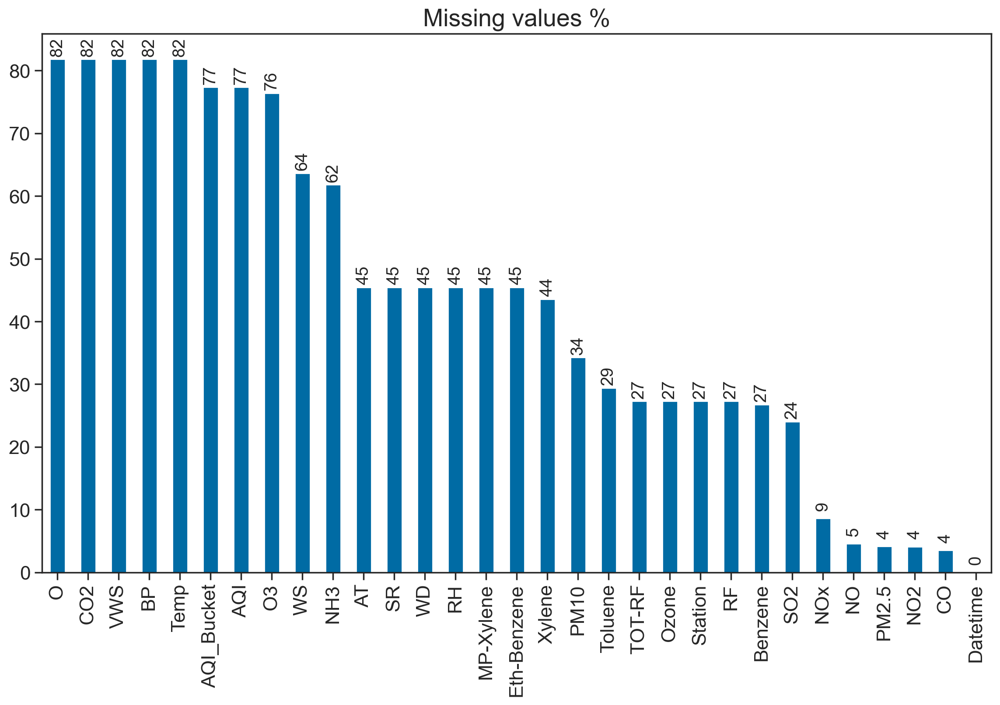

In [105]:
plt.figure(figsize=(14,8))
ax = df_describe_object['Missing %'].sort_values(ascending=False).plot.bar()
plt.title("Missing values %", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

for p in ax.patches:
        ax.annotate(round(p.get_height()),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center',
                    va='center',
                    fontsize=14,
                    rotation=90,
                    xytext=(0, 10),
                    textcoords='offset points')

In [61]:
px.bar(df_describe_object['Missing %'].sort_values(ascending=False),
       text_auto=True)

### 3. Data Cleaning

In [107]:
compiled = pd.read_csv('../../data/preprocessing_data/Gurugram_Hourly_Compiled.csv')
compiled

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17432/1995461245.py:1: DtypeWarning:

Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,25,26,27,30) have mixed types. Specify dtype option on import or set low_memory=False.



,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,3.1,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,3.03,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,3.08,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,NaN,54.74,6.23,10.67,12.6,4.18,0.6,NaN,2.14,...,4.7,NaN,NaN,NaN,135.42,2.95,NaN,70.95,154.0,Moderate
147527,2020-06-30 21:00:00,NaN,54.37,6.3,10.28,11.88,4.03,1.2,NaN,1.87,...,4.29,NaN,NaN,NaN,136.11,3.47,NaN,55.13,154.0,Moderate
147528,2020-06-30 22:00:00,NaN,50.34,6.93,10.36,13.01,6.17,1.0,NaN,2.41,...,4.59,NaN,NaN,NaN,147.32,3.76,NaN,42.60,155.0,Moderate
147529,2020-06-30 23:00:00,NaN,53.23,6.64,10.3,12.75,6.31,0.86,NaN,2.54,...,4.61,NaN,NaN,NaN,163.15,3.36,NaN,35.61,156.0,Moderate


In [108]:
# Convert object to float and string
schema = {
    "Datetime": str,
    "Station": str,
    "PM2.5": np.float64,
    "NO": np.float64,
    "NO2": np.float64,
    "NOx": np.float64,
    "SO2": np.float64,
    "CO": np.float64,
    "Ozone": np.float64,
    "Benzene": np.float64,
    "Toluene": np.float64,
    "Eth-Benzene": np.float64,
    "MP-Xylene": np.float64,
    "O": np.float64,
    "Temp": np.float64,
    "RH": np.float64,
    "WS": np.float64,
    "WD": np.float64,
    "SR": np.float64,
    "BP": np.float64,
    "VWS": np.float64,
    "Xylene": np.float64,
    "AT": np.float64,
    "RF": np.float64,
    "TOT-RF": np.float64,
    "PM10": np.float64,
    "NH3": np.float64,
    "CO2": np.float64,
    "O3": np.float64,
    "AQI": np.float64,
    "AQI_Bucket": str
}
compiled

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,3.1,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,3.03,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,3.08,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,None,None,0.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,NaN,54.74,6.23,10.67,12.6,4.18,0.6,NaN,2.14,...,4.7,NaN,NaN,NaN,135.42,2.95,NaN,70.95,154.0,Moderate
147527,2020-06-30 21:00:00,NaN,54.37,6.3,10.28,11.88,4.03,1.2,NaN,1.87,...,4.29,NaN,NaN,NaN,136.11,3.47,NaN,55.13,154.0,Moderate
147528,2020-06-30 22:00:00,NaN,50.34,6.93,10.36,13.01,6.17,1.0,NaN,2.41,...,4.59,NaN,NaN,NaN,147.32,3.76,NaN,42.60,155.0,Moderate
147529,2020-06-30 23:00:00,NaN,53.23,6.64,10.3,12.75,6.31,0.86,NaN,2.54,...,4.61,NaN,NaN,NaN,163.15,3.36,NaN,35.61,156.0,Moderate


In [109]:
# We have None in columns.
compiled.replace(to_replace=['None'], value=np.nan, inplace=True)
compiled

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,...,3.1,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2,...,3.03,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.6,1.85,12.72,2.02,...,3.08,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,04-03-2020 03:00,Vikas Sadan,67.6,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,04-03-2020 04:00,Vikas Sadan,72.72,319.8,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,NaN,54.74,6.23,10.67,12.6,4.18,0.6,NaN,2.14,...,4.7,NaN,NaN,NaN,135.42,2.95,NaN,70.95,154.0,Moderate
147527,2020-06-30 21:00:00,NaN,54.37,6.3,10.28,11.88,4.03,1.2,NaN,1.87,...,4.29,NaN,NaN,NaN,136.11,3.47,NaN,55.13,154.0,Moderate
147528,2020-06-30 22:00:00,NaN,50.34,6.93,10.36,13.01,6.17,1.0,NaN,2.41,...,4.59,NaN,NaN,NaN,147.32,3.76,NaN,42.60,155.0,Moderate
147529,2020-06-30 23:00:00,NaN,53.23,6.64,10.3,12.75,6.31,0.86,NaN,2.54,...,4.61,NaN,NaN,NaN,163.15,3.36,NaN,35.61,156.0,Moderate


In [110]:
compiled.dtypes
compiled = compiled.astype(schema)
compiled.dtypes

Datetime        object
Station         object
PM2.5           object
NO              object
NO2             object
NOx             object
SO2             object
CO              object
Ozone           object
Benzene         object
Toluene         object
Eth-Benzene     object
MP-Xylene       object
O               object
Temp            object
RH              object
WS              object
WD              object
SR              object
BP              object
VWS             object
Xylene          object
AT              object
RF              object
TOT-RF         float64
PM10            object
NH3             object
CO2            float64
O3             float64
AQI            float64
AQI_Bucket      object
dtype: object

Datetime        object
Station         object
PM2.5          float64
NO             float64
NO2            float64
NOx            float64
SO2            float64
CO             float64
Ozone          float64
Benzene        float64
Toluene        float64
Eth-Benzene    float64
MP-Xylene      float64
O              float64
Temp           float64
RH             float64
WS             float64
WD             float64
SR             float64
BP             float64
VWS            float64
Xylene         float64
AT             float64
RF             float64
TOT-RF         float64
PM10           float64
NH3            float64
CO2            float64
O3             float64
AQI            float64
AQI_Bucket      object
dtype: object

In [111]:
compiled['Station'].value_counts(dropna=False)
compiled['Station'].isna().sum()

nan            40258
Sector 51      26825
Vikas Sadan    26816
NISE           26816
Teri Gram      26816
Name: Station, dtype: int64

0

In [112]:
compiled['Station'].replace(to_replace=['nan'], value="No Station", inplace=True)
compiled

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,...,3.10,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,...,3.03,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,...,3.08,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
3,04-03-2020 03:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
4,04-03-2020 04:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,No Station,54.74,6.23,10.67,12.60,4.18,0.60,NaN,2.14,...,4.70,NaN,NaN,NaN,135.42,2.95,NaN,70.95,154.0,Moderate
147527,2020-06-30 21:00:00,No Station,54.37,6.30,10.28,11.88,4.03,1.20,NaN,1.87,...,4.29,NaN,NaN,NaN,136.11,3.47,NaN,55.13,154.0,Moderate
147528,2020-06-30 22:00:00,No Station,50.34,6.93,10.36,13.01,6.17,1.00,NaN,2.41,...,4.59,NaN,NaN,NaN,147.32,3.76,NaN,42.60,155.0,Moderate
147529,2020-06-30 23:00:00,No Station,53.23,6.64,10.30,12.75,6.31,0.86,NaN,2.54,...,4.61,NaN,NaN,NaN,163.15,3.36,NaN,35.61,156.0,Moderate


In [113]:
compiled['Station'] .unique()

array(['Vikas Sadan', 'Sector 51', 'NISE', 'Teri Gram', 'No Station'],
      dtype=object)

In [129]:
len(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp',
       'RH', 'WS', 'WD', 'SR', 'BP', 'VWS', 'Xylene'])

22

<AxesSubplot: >

Text(0.5, 1.0, 'Total missing values by station')

Text(0.5, 0, 'Column')

Text(0, 0.5, 'Count')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]),
 [Text(0, 0, 'Datetime'),
  Text(1, 0, 'Station'),
  Text(2, 0, 'PM2.5'),
  Text(3, 0, 'NO'),
  Text(4, 0, 'NO2'),
  Text(5, 0, 'NOx'),
  Text(6, 0, 'SO2'),
  Text(7, 0, 'CO'),
  Text(8, 0, 'Ozone'),
  Text(9, 0, 'Benzene'),
  Text(10, 0, 'Toluene'),
  Text(11, 0, 'Eth-Benzene'),
  Text(12, 0, 'MP-Xylene'),
  Text(13, 0, 'O'),
  Text(14, 0, 'Temp'),
  Text(15, 0, 'RH'),
  Text(16, 0, 'WS'),
  Text(17, 0, 'WD'),
  Text(18, 0, 'SR'),
  Text(19, 0, 'BP'),
  Text(20, 0, 'VWS'),
  Text(21, 0, 'Xylene'),
  Text(22, 0, 'AT'),
  Text(23, 0, 'RF'),
  Text(24, 0, 'TOT-RF'),
  Text(25, 0, 'PM10'),
  Text(26, 0, 'NH3'),
  Text(27, 0, 'CO2'),
  Text(28, 0, 'O3'),
  Text(29, 0, 'AQI'),
  Text(30, 0, 'AQI_Bucket')])

(array([     0.,  20000.,  40000.,  60000.,  80000., 100000., 120000.,
        140000., 160000.]),
 [Text(0, 0.0, '0'),
  Text(0, 20000.0, '20000'),
  Text(0, 40000.0, '40000'),
  Text(0, 60000.0, '60000'),
  Text(0, 80000.0, '80000'),
  Text(0, 100000.0, '100000'),
  Text(0, 120000.0, '120000'),
  Text(0, 140000.0, '140000'),
  Text(0, 160000.0, '160000')])

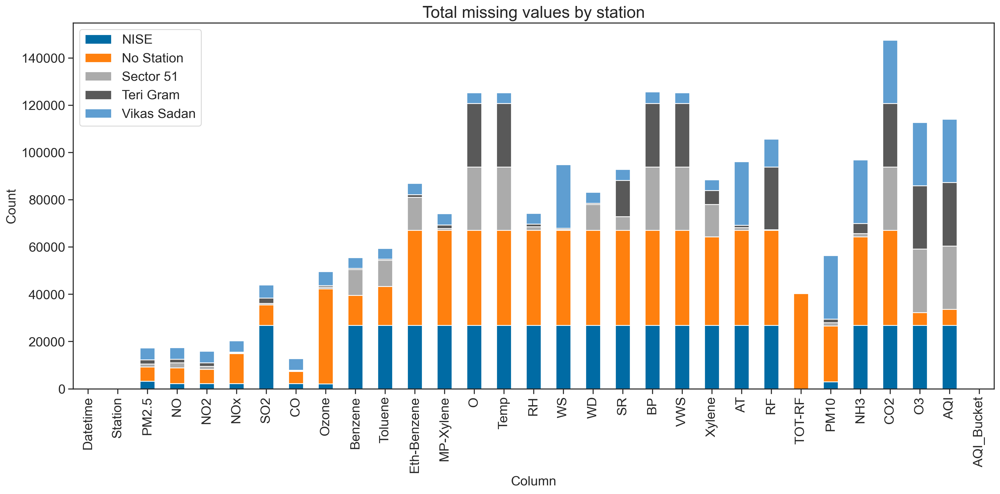

In [152]:
compiled.groupby(['Station']).apply(lambda x: x.isnull().sum() + (x == "None").sum()).T.plot.bar(figsize=(20,8), stacked=True)
plt.title("Total missing values by station", fontsize=20)
plt.xlabel("Column", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.legend(loc='upper left', fontsize=16)

In [114]:
px.bar(compiled.groupby(
    ['Station']).apply(lambda x: x.isnull().sum() + (x == "None").sum() ).T,
       text_auto=True,
       title='Total missing values by station',
       labels={
           "x": "Column",
           "y": "Count"
       })

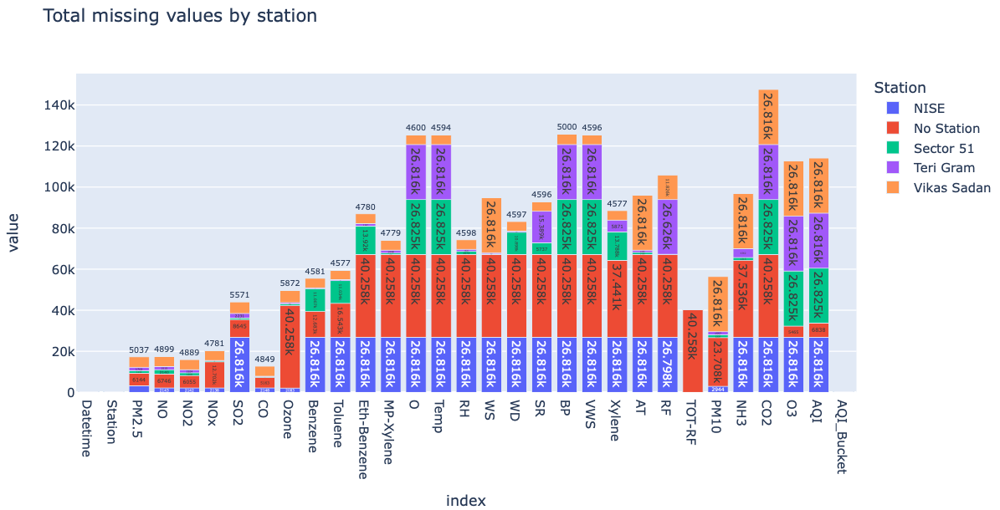

Text(0.5, 1.0, 'Percentage of missing values by station')

Text(0.5, 0, 'Column')

Text(0, 0.5, 'Percentage')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]),
 [Text(0, 0, 'Datetime'),
  Text(1, 0, 'Station'),
  Text(2, 0, 'PM2.5'),
  Text(3, 0, 'NO'),
  Text(4, 0, 'NO2'),
  Text(5, 0, 'NOx'),
  Text(6, 0, 'SO2'),
  Text(7, 0, 'CO'),
  Text(8, 0, 'Ozone'),
  Text(9, 0, 'Benzene'),
  Text(10, 0, 'Toluene'),
  Text(11, 0, 'Eth-Benzene'),
  Text(12, 0, 'MP-Xylene'),
  Text(13, 0, 'O'),
  Text(14, 0, 'Temp'),
  Text(15, 0, 'RH'),
  Text(16, 0, 'WS'),
  Text(17, 0, 'WD'),
  Text(18, 0, 'SR'),
  Text(19, 0, 'BP'),
  Text(20, 0, 'VWS'),
  Text(21, 0, 'Xylene'),
  Text(22, 0, 'AT'),
  Text(23, 0, 'RF'),
  Text(24, 0, 'TOT-RF'),
  Text(25, 0, 'PM10'),
  Text(26, 0, 'NH3'),
  Text(27, 0, 'CO2'),
  Text(28, 0, 'O3'),
  Text(29, 0, 'AQI'),
  Text(30, 0, 'AQI_Bucket')])

(array([  0.,  20.,  40.,  60.,  80., 100., 120.]),
 [Text(0, 0.0, '0'),
  Text(0, 20.0, '20'),
  Text(0, 40.0, '40'),
  Text(0, 60.0, '60'),
  Text(0, 80.0, '80'),
  Text(0, 100.0, '100'),
  Text(0, 120.0, '120')])

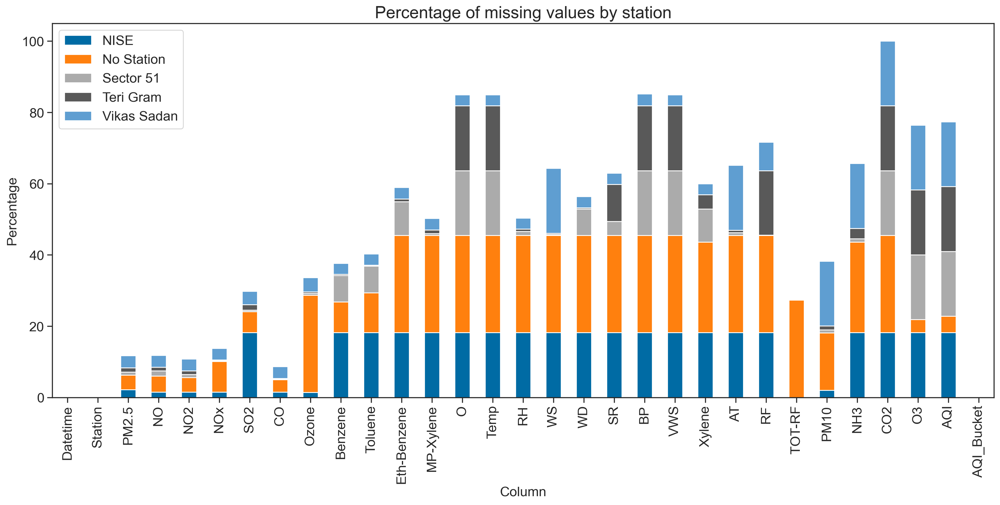

In [155]:
ax = compiled.groupby(['Station']).apply(lambda x: round((
    (x.isnull().sum() + (x == "None").sum()) / compiled.shape[0]) * 100, 2)).T.plot.bar(figsize=(20,8), stacked=True)
plt.title("Percentage of missing values by station", fontsize=20)
plt.xlabel("Column", fontsize=16)
plt.ylabel("Percentage", fontsize=16)

plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.legend(loc='upper left', fontsize=16)

In [156]:
px.bar(compiled.groupby(['Station']).apply(lambda x: round((
    (x.isnull().sum() + (x == "None").sum()) / compiled.shape[0]) * 100, 2)).T,
       text_auto=True,
       title='Percentage of missing values by station',
       labels={
           "x": "Column",
           "y": "Percentage"
       })

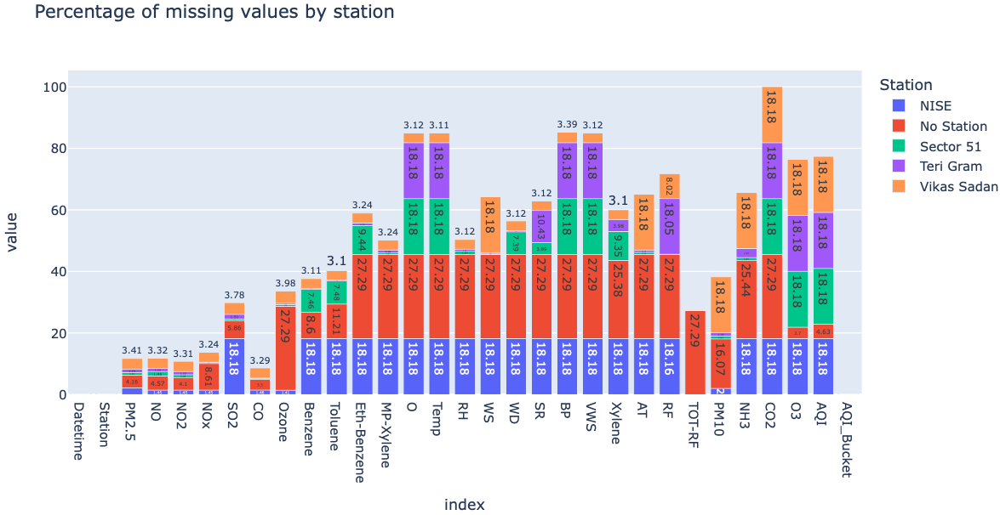

- Columns to take average (fill NISE)
    - SO2
- Columns to remove
    - Benzene,Toulene, Eth-Benzene, MP_Xylene, O, Temp, RH, WS, WD, SR, BP, VWS, Xylene, AT,RF, NH3, CO2, O3
- Columns to compute
    - AQI and bucket

In [157]:
compiled.apply(lambda x : round(((x.isnull().sum() + (x=="None").sum())/compiled.shape[0])*100, 2)).sort_values(ascending=False)

CO2            100.00
BP              85.21
O               84.94
VWS             84.94
Temp            84.94
AQI             77.35
O3              76.42
RF              71.66
NH3             65.64
AT              65.13
WS              64.28
SR              62.90
Xylene          59.98
Eth-Benzene     58.93
WD              56.38
RH              50.34
MP-Xylene       50.20
Toluene         40.27
PM10            38.20
Benzene         37.63
Ozone           33.62
SO2             29.82
TOT-RF          27.29
NOx             13.77
NO              11.82
PM2.5           11.70
NO2             10.79
CO               8.61
Datetime         0.00
Station          0.00
AQI_Bucket       0.00
dtype: float64

In [158]:
# Lets compare NISE with average of other 3 stations

# SO2, MP_Xylene, RH

compiled.groupby(["Station"]).SO2.count()
compiled.groupby(["Station"])["MP-Xylene"].count()
compiled.groupby(["Station"]).RH.count()

Station
NISE               0
No Station     31613
Sector 51      26092
Teri Gram      24585
Vikas Sadan    21245
Name: SO2, dtype: int64

Station
NISE               0
No Station         0
Sector 51      26065
Teri Gram      25368
Vikas Sadan    22037
Name: MP-Xylene, dtype: int64

Station
NISE               0
No Station         0
Sector 51      25252
Teri Gram      25791
Vikas Sadan    22218
Name: RH, dtype: int64

In [159]:
# We see that SO2, MP_Xylene, RH is completely absent in NISE. So we can take average after filling NaNs
# Let us check if NISE is really average of other 3 stations NO, NO2, NOx

compiled.groupby(["Station"])["NO"].mean()
print("NISE NO value", compiled.groupby(["Station"])["NO"].mean()[0])
print("Other stations average NO value", compiled.groupby(["Station"])["NO"].mean()[1:].values.mean())

Station
NISE            9.795104
No Station     17.923547
Sector 51      14.548590
Teri Gram      12.234311
Vikas Sadan    19.851806
Name: NO, dtype: float64

NISE NO value 9.795103554492766
Other stations average NO value 16.139563469563395


In [160]:
compiled.groupby(["Station"])["NO2"].mean()
print("NISE NO2 value", compiled.groupby(["Station"])["NO2"].mean()[0])
print("Other stations average NO2 value", compiled.groupby(["Station"])["NO2"].mean()[1:].values.mean())

Station
NISE           21.655308
No Station     23.117616
Sector 51      18.307624
Teri Gram      16.427935
Vikas Sadan    28.926956
Name: NO2, dtype: float64

NISE NO2 value 21.655308016535624
Other stations average NO2 value 21.695032789631558


In [161]:
compiled.groupby(["Station"])["PM2.5"].mean()
print("NISE PM2.5 value", compiled.groupby(["Station"])["PM2.5"].mean()[0])
print("Other stations average PM2.5 value", compiled.groupby(["Station"])["PM2.5"].mean()[1:].values.mean())

Station
NISE            79.544378
No Station     114.449409
Sector 51      105.474428
Teri Gram       86.103672
Vikas Sadan     93.782973
Name: PM2.5, dtype: float64

NISE PM2.5 value 79.54437785291631
Other stations average PM2.5 value 99.95262038447153


In [162]:
compiled.groupby(["Station"])["NOx"].mean()
print("NISE NOx value", compiled.groupby(["Station"])["NOx"].mean()[0])
print("Other stations average NOx value", compiled.groupby(["Station"])["NOx"].mean()[1:].values.mean())

Station
NISE           30.216896
No Station     30.032255
Sector 51      15.634916
Teri Gram      19.873615
Vikas Sadan    32.722258
Name: NOx, dtype: float64

NISE NOx value 30.216896020747228
Other stations average NOx value 24.565761254063396


In [163]:
# We see the average is a good way to fill NISE station's missing values for 
# SO2. But it should be filled in such a way that, on a day, if SO2 is absent in NISE, that day's
# other 3 station's SO2 average should be filled.

compiled.groupby(["Station"]).SO2.count()
compiled.groupby(["Station"])["MP-Xylene"].count()
compiled.groupby(["Station"]).RH.count()

Station
NISE               0
No Station     31613
Sector 51      26092
Teri Gram      24585
Vikas Sadan    21245
Name: SO2, dtype: int64

Station
NISE               0
No Station         0
Sector 51      26065
Teri Gram      25368
Vikas Sadan    22037
Name: MP-Xylene, dtype: int64

Station
NISE               0
No Station         0
Sector 51      25252
Teri Gram      25791
Vikas Sadan    22218
Name: RH, dtype: int64

In [164]:
# Before filling NISE with mean, we should ensure that other stations should not have any missing values.

In [165]:
compiled[['Station', 'SO2']]
# compiled.groupby(["Station"]).SO2.sum()

,Station,SO2
0,Vikas Sadan,10.50
1,Vikas Sadan,5.64
2,Vikas Sadan,7.60
3,Vikas Sadan,10.53
4,Vikas Sadan,9.98
...,...,...
147526,No Station,4.18
147527,No Station,4.03
147528,No Station,6.17
147529,No Station,6.31


In [166]:
compiled['SO2'].describe()

count    103535.000000
mean          7.818233
std           9.874812
min           0.010000
25%           2.490000
50%           4.960000
75%           9.310000
max         199.370000
Name: SO2, dtype: float64

In [167]:
compiled[compiled['SO2'] > 19.31].sort_values(['SO2'])

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
19410,21-05-2022 18:00,Vikas Sadan,76.40,19.57,16.46,11.93,19.32,0.51,43.33,3.27,...,3.64,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,nan
146460,2020-05-17 10:00:00,No Station,124.93,24.48,29.94,35.05,19.32,0.85,NaN,7.25,...,2.38,NaN,NaN,NaN,191.35,31.42,NaN,147.97,224.0,Poor
23891,24-11-2022 11:00,Vikas Sadan,92.19,18.74,16.06,32.54,19.32,0.78,18.88,2.10,...,0.51,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,nan
27129,17-03-2020 01:00,Sector 51,250.68,12.64,30.74,26.20,19.32,1.10,10.74,8.33,...,25.94,18.06,0.0,0.0,382.46,79.55,NaN,NaN,NaN,nan
132746,2018-10-24 00:00:00,No Station,146.68,136.81,59.31,146.18,19.32,1.40,NaN,11.16,...,NaN,NaN,NaN,NaN,374.83,NaN,NaN,7.84,318.0,Very Poor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28903,29-05-2020 23:00,Sector 51,29.86,NaN,13.95,4.86,192.88,0.46,47.79,2.94,...,3.19,25.35,0.0,0.0,53.95,21.38,NaN,NaN,NaN,nan
28902,29-05-2020 22:00,Sector 51,NaN,NaN,13.23,4.36,193.12,0.48,49.84,2.96,...,3.24,25.52,0.0,0.0,NaN,21.56,NaN,NaN,NaN,nan
28901,29-05-2020 21:00,Sector 51,NaN,0.18,12.98,4.87,194.97,0.53,55.91,3.06,...,3.37,25.09,0.0,0.0,NaN,21.29,NaN,NaN,NaN,nan
28947,31-05-2020 19:00,Sector 51,22.44,NaN,NaN,0.00,196.39,0.60,51.98,0.92,...,1.22,NaN,0.0,0.0,93.51,NaN,NaN,NaN,NaN,nan


In [168]:
compiled[compiled['SO2'] >= 9.31]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,...,3.10,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
3,04-03-2020 03:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
4,04-03-2020 04:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
5,04-03-2020 05:00,Vikas Sadan,75.97,263.58,26.00,224.17,12.04,1.31,5.08,2.00,...,2.95,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
6,04-03-2020 06:00,Vikas Sadan,76.28,222.80,27.10,192.04,12.20,0.07,4.27,2.02,...,2.96,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147512,2020-06-30 06:00:00,No Station,30.48,6.78,9.59,12.32,9.34,0.42,NaN,2.68,...,5.07,NaN,NaN,NaN,112.91,3.53,NaN,33.54,116.0,Moderate
147513,2020-06-30 07:00:00,No Station,31.90,6.88,9.74,12.14,9.85,0.53,NaN,2.67,...,5.12,NaN,NaN,NaN,120.28,3.52,NaN,16.52,115.0,Moderate
147518,2020-06-30 12:00:00,No Station,52.91,5.57,11.47,11.10,12.15,1.27,NaN,2.16,...,4.96,NaN,NaN,NaN,95.70,3.72,NaN,67.36,128.0,Moderate
147521,2020-06-30 15:00:00,No Station,61.14,4.98,12.24,10.83,10.16,0.54,NaN,1.96,...,4.56,NaN,NaN,NaN,79.83,2.98,NaN,113.45,137.0,Moderate


In [169]:
# >75% is 9.31. It is 17.5 % of the data.
(compiled[compiled['SO2'] >= 9.31].shape[0] / compiled.shape[0]) * 100

17.554276728280836

<AxesSubplot: xlabel='SO2'>

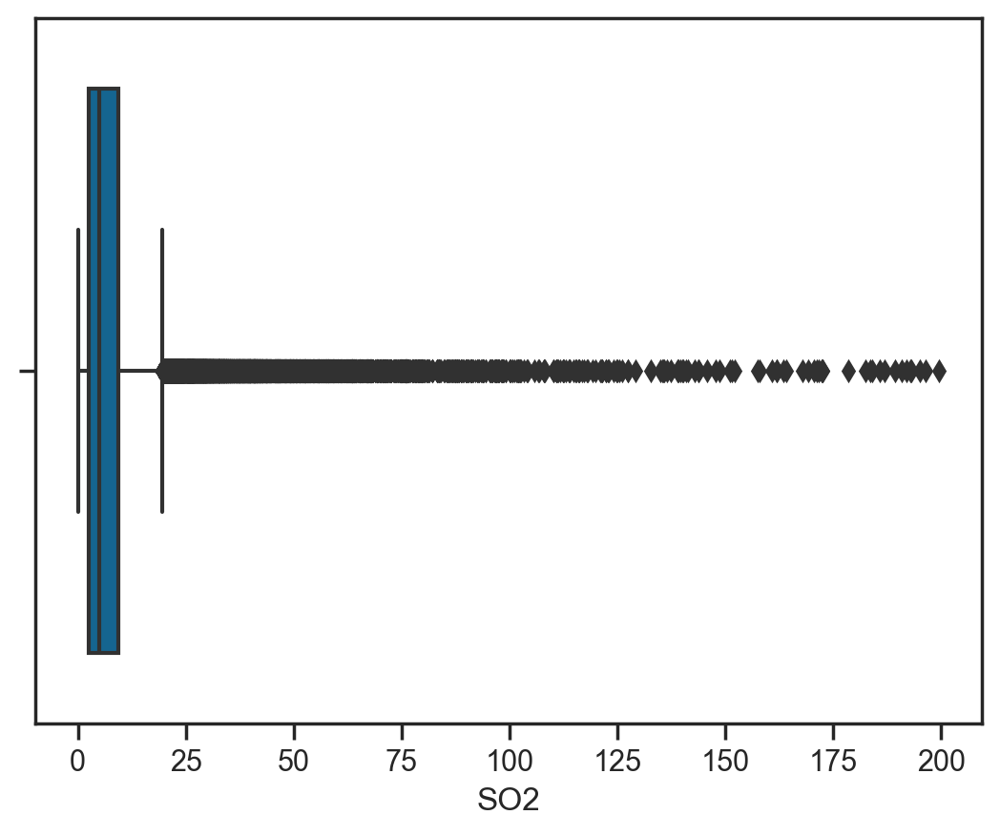

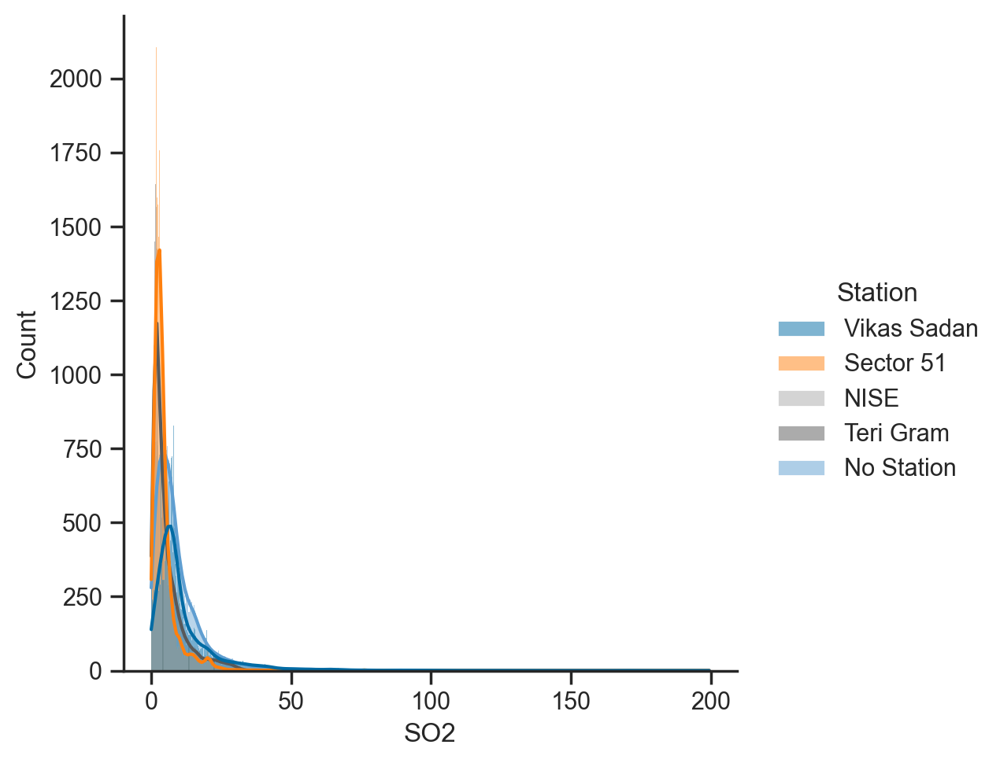

In [170]:
sns.boxplot(data = compiled, x='SO2')
sns.displot(data = compiled, x='SO2', kde=True, hue='Station')

<AxesSubplot: xlabel='SO2'>

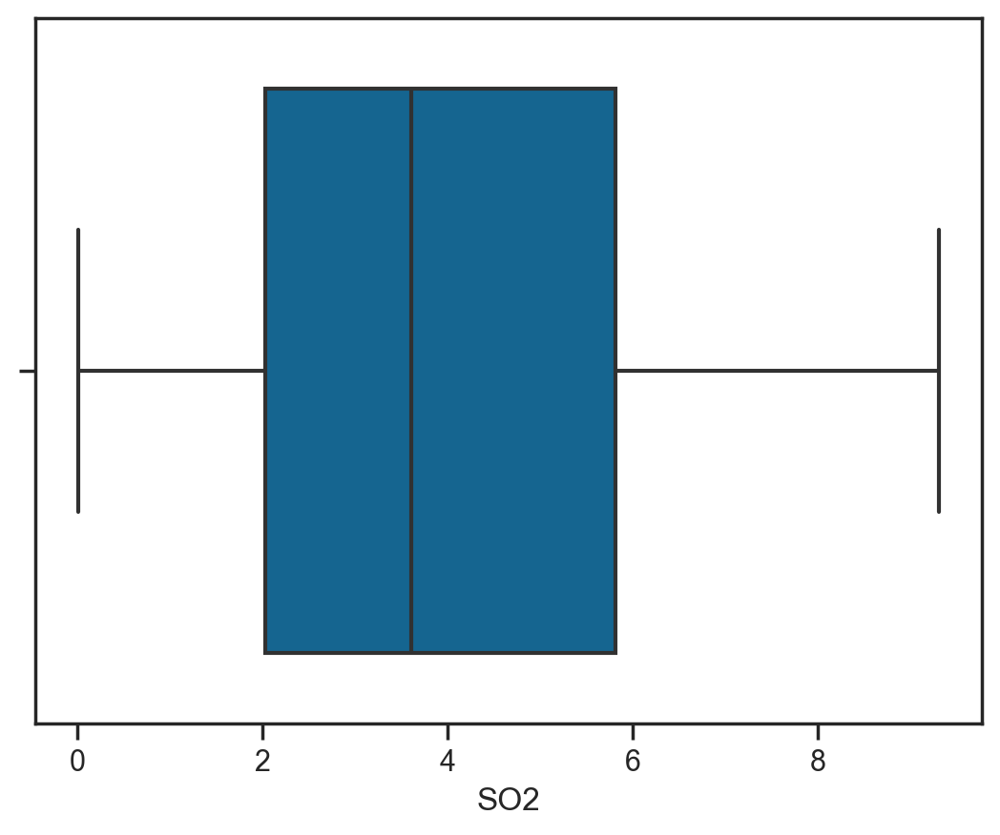

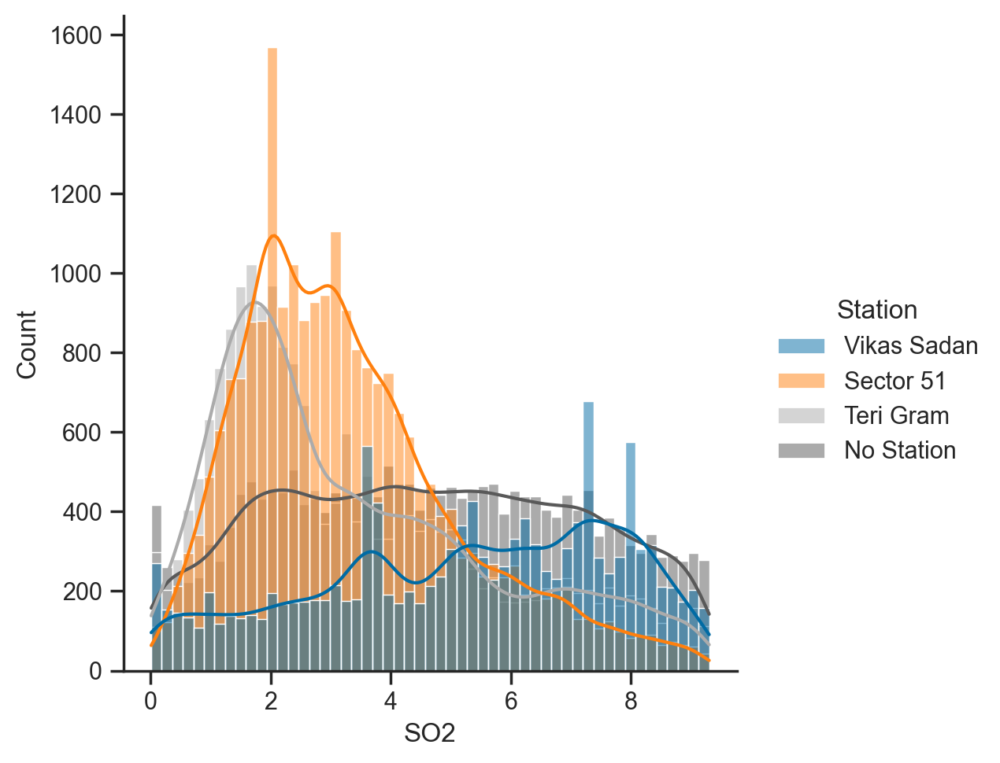

In [171]:
sns.boxplot(data = compiled[compiled['SO2'] < 9.31], x='SO2')
sns.displot(data = compiled[compiled['SO2'] < 9.31], x='SO2', kde=True, hue='Station')

In [149]:
# First fill other 3 stations by bfill or ffill (but it should be done stations wise)
# Example, if on a day Vikas Sadan has missing value, then previous day's in Vikas Sadan should be filled.
# Station should be the same.

In [150]:
compiled[["Station", "SO2"]]

,Station,SO2
0,Vikas Sadan,10.50
1,Vikas Sadan,5.64
2,Vikas Sadan,7.60
3,Vikas Sadan,10.53
4,Vikas Sadan,9.98
...,...,...
147526,No Station,4.18
147527,No Station,4.03
147528,No Station,6.17
147529,No Station,6.31


In [173]:
compiled[compiled['Station'] == "Vikas Sadan"]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,Xylene,AT,RF,TOT-RF,PM10,NH3,CO2,O3,AQI,AQI_Bucket
0,04-03-2020 00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,...,3.10,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
1,04-03-2020 01:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,...,3.03,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
2,04-03-2020 02:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,...,3.08,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
3,04-03-2020 03:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,3.02,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
4,04-03-2020 04:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,...,2.97,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,26-03-2023 03:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,...,12.70,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,nan
26812,26-03-2023 04:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,...,3.51,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,nan
26813,26-03-2023 05:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,...,3.50,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,nan
26814,26-03-2023 06:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,...,3.55,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,nan


In [175]:
temp_vikas_sadan_so2_plot = compiled[compiled['Station'] == "Vikas Sadan"]['SO2']
temp_vikas_sadan_so2_plot


0        10.50
1         5.64
2         7.60
3        10.53
4         9.98
         ...  
26811    41.30
26812    40.56
26813    40.82
26814    39.29
26815      NaN
Name: SO2, Length: 26816, dtype: float64

In [178]:
temp_vikas_sadan_so2_plot.index = (pd.to_datetime(compiled[compiled['Station'] == "Vikas Sadan"]['Datetime'] ))

In [179]:
temp_vikas_sadan_so2_plot

Datetime
2020-04-03 00:00:00    10.50
2020-04-03 01:00:00     5.64
2020-04-03 02:00:00     7.60
2020-04-03 03:00:00    10.53
2020-04-03 04:00:00     9.98
                       ...  
2023-03-26 03:00:00    41.30
2023-03-26 04:00:00    40.56
2023-03-26 05:00:00    40.82
2023-03-26 06:00:00    39.29
2023-03-26 07:00:00      NaN
Name: SO2, Length: 26816, dtype: float64

<Figure size 2400x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='SO2'>

Text(0.5, 1.0, 'Vikas Sadan SO2 data')

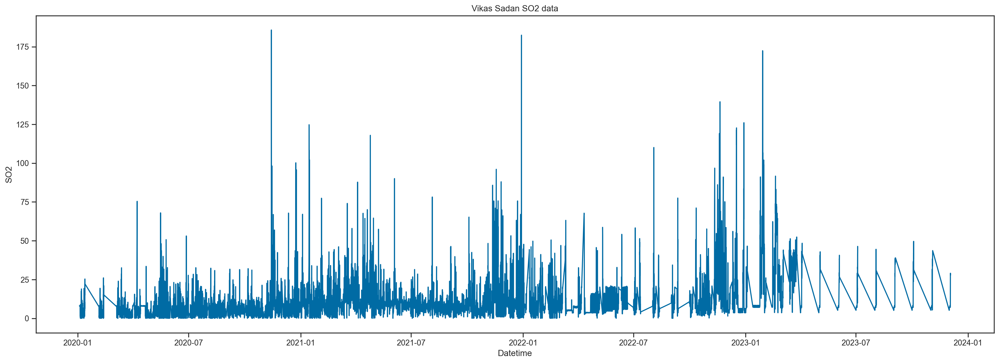

In [181]:
plt.figure(figsize=(24,8))
sns.lineplot(temp_vikas_sadan_so2_plot)
plt.title("Vikas Sadan SO2 data")

In [182]:
from datetime import datetime
# compiled['Datetime'].apply(lambda x : datetime.strptime(x, '%d-%m-%Y %H:%M'))

temp1 = compiled['Datetime'][:107273].apply(lambda x : datetime.strptime(x, '%d-%m-%Y %H:%M'))
temp = compiled['Datetime'][107273:]
temp.apply(lambda x : datetime.strptime(x, '%Y-%m-%d %H:%M:%S'))
temp2 = compiled['Datetime'][107273:].apply(lambda x : datetime.strptime(x, '%Y-%m-%d %H:%M:%S'))
temp3 = pd.concat([temp1, temp2])
compiled['Datetime_2'] = temp3

compiled['Datetime'] = compiled['Datetime_2']

compiled.drop(['Datetime_2'], axis=1,inplace=True)

# We will not use these cols for training our model, just for vis purpose

day =[]
month = []
year = []
week = []
hour = []
for i in range(compiled.shape[0]):
    day.append(compiled['Datetime'][i].day)
    month.append(compiled['Datetime'][i].month)
    year.append(compiled['Datetime'][i].year)
    week.append(compiled['Datetime'][i].week)
    hour.append(compiled['Datetime'][i].hour)
compiled['Day'] = day
compiled['Month'] = month
compiled['Year'] = year
compiled['Week'] = week
compiled['Hour'] = hour


107273   2015-11-27 15:00:00
107274   2015-11-27 16:00:00
107275   2015-11-27 17:00:00
107276   2015-11-27 18:00:00
107277   2015-11-27 19:00:00
                 ...        
147526   2020-06-30 20:00:00
147527   2020-06-30 21:00:00
147528   2020-06-30 22:00:00
147529   2020-06-30 23:00:00
147530   2020-07-01 00:00:00
Name: Datetime, Length: 40258, dtype: datetime64[ns]

In [183]:
# See missing values by date. PLot the barplot day vs missing values

vikas_sadan  = compiled[compiled['Station'] == "Vikas Sadan"]
vikas_sadan

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,0
1,2020-03-04 01:00:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,1
2,2020-03-04 02:00:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,2
3,2020-03-04 03:00:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,3
4,2020-03-04 04:00:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,...,NaN,NaN,NaN,NaN,nan,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,...,NaN,NaN,NaN,NaN,nan,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,...,NaN,NaN,NaN,NaN,nan,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,...,NaN,NaN,NaN,NaN,nan,26,3,2023,12,6


In [184]:
vikas_sadan["SO2"].isnull().sum()
vikas_sadan["SO2"].isna().sum()

5571

5571

In [185]:
vikas_sadan["SO2"].sample(10)
vikas_sadan["SO2"][20488]

26301    40.72
9338     23.17
15985    26.69
21539      NaN
25178     7.32
13348     9.01
7244      6.03
18885    15.09
11152    13.80
17014    12.70
Name: SO2, dtype: float64

nan

In [186]:
# X-axis group (year, month)
# Y aixs count of missing values
vikas_sadan_na = vikas_sadan[vikas_sadan['SO2'].isna()]
vikas_sadan_na
vikas_sadan_na.groupby(by = ['Year',"Month"]).SO2.sum()

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
64,2020-03-06 16:00:00,Vikas Sadan,13.32,7.66,51.92,31.73,NaN,2.90,45.10,2.00,...,NaN,NaN,NaN,NaN,nan,6,3,2020,10,16
97,2020-03-08 01:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,8,3,2020,10,1
100,2020-03-08 04:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,8,3,2020,10,4
127,2020-03-09 07:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,9,3,2020,11,7
137,2020-03-09 17:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,9,3,2020,11,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26775,2023-03-24 15:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,24,3,2023,12,15
26776,2023-03-24 16:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,24,3,2023,12,16
26777,2023-03-24 17:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,24,3,2023,12,17
26783,2023-03-24 23:00:00,Vikas Sadan,37.04,17.30,30.48,50.05,NaN,0.96,44.74,9.16,...,NaN,NaN,NaN,NaN,nan,24,3,2023,12,23


Year  Month
2020  3        0.0
      4        0.0
      5        0.0
      6        0.0
      7        0.0
      8        0.0
      9        0.0
      10       0.0
      11       0.0
      12       0.0
2021  1        0.0
      2        0.0
      3        0.0
      4        0.0
      5        0.0
      6        0.0
      7        0.0
      8        0.0
      9        0.0
      10       0.0
      11       0.0
      12       0.0
2022  1        0.0
      2        0.0
      3        0.0
      4        0.0
      5        0.0
      6        0.0
      7        0.0
      8        0.0
      9        0.0
      10       0.0
      11       0.0
      12       0.0
2023  1        0.0
      2        0.0
      3        0.0
Name: SO2, dtype: float64

In [187]:
vikas_sadan_na.groupby(by = ['Year',"Month"]).count() # NaN is replaced with 0

Datetime  Station  PM2.5  NO  NO2  NOx  SO2  CO  Ozone  Benzene  \
Year Month                                                                    
2020 3            98       98     43  45   45   45    0  45     43       45   
     4            26       26      7   8    8    8    0   6      8        8   
     5           224      224     87  95  100  100    0  93     95       97   
     6           157      157     67  75   77   79    0  75     75       78   
     7           129      129     37  38   45   49    0  48     44       54   
     8            40       40     24  27   28   28    0  27     26       28   
     9            39       39     14  17   17   17    0  17     13       17   
     10           37       37     18  19   19   19    0  19     14       19   
     11           59       59     28  29   30   30    0  31     24       31   
     12           62       62     27  24   19   24    0  27     20       29   
2021 1            40       40     27  26   26   26    0  28     27       29   
     2            35       35     32  33    9   33    0  33     30       33   
     3             6        6      6   6    6    6    0   6      6        6   
     4            22       22      3   7    7    7    0   8      7        8   
     5            96       96     29  19   20   21    0  20     18       33   
     6            34       34      6   7    9    8    0   9      8        9   
     7            92       92     12  12   14   15    0  16     10       16   
     8            95       95     19  21   22   22    0  22     19       23   
     9            57       57     18  23   22   23    0  21     19       23   
     10          156      156     19  18   18   18    0  22     18       22   
     11           93       93     19  19   19   19    0  18     18       19   
     12          160      160     22  24   23   23    0  24     23       23   
2022 1           290      290     58  58   58   58    0  60     60       61   
     2            57       57     21  22   22   22    0  23     20       22   
     3           113      113     22  22   22   22    0  23     22       23   
     4           177      177      1   3    3    3    0   4      2        3   
     5           148      148      0   0    0    0    0   0      0        0   
     6           276      276      7   7    7    7    0   7      7        7   
     7           744      744      0   0    0    0    0   0      0        0   
     8           744      744      0   0    0    0    0   0      0        0   
     9           720      720      0   0    0    0    0   0      0        0   
     10          259      259     38  44   44   44    0  41     36       44   
     11          111      111     55  61   61   61    0  58     59       61   
     12           47       47     41  45   43   45    0  42     42       43   
2023 1             9        9      2   3    3    3    0   4      2        3   
     2            34       34     19  30   30   30    0  21     21       30   
     3            85       85     16  71   71   71    0  13     39       71   

            ...  TOT-RF  PM10  NH3  CO2  O3  AQI  AQI_Bucket  Day  Week  Hour  
Year Month  ...                                                                
2020 3      ...      98     0    0    0   0    0          98   98    98    98  
     4      ...      26     0    0    0   0    0          26   26    26    26  
     5      ...     224     0    0    0   0    0         224  224   224   224  
     6      ...     157     0    0    0   0    0         157  157   157   157  
     7      ...     129     0    0    0   0    0         129  129   129   129  
     8      ...      40     0    0    0   0    0          40   40    40    40  
     9      ...      39     0    0    0   0    0          39   39    39    39  
     10     ...      37     0    0    0   0    0          37   37    37    37  
     11     ...      59     0    0    0   0    0          59   59    59    59  
     12     ...      62     0    0    0   0    0  

In [188]:
vikas_sadan_na["SO2"].isna().sum()

5571

In [189]:
vikas_sadan_na.fillna(1)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
64,2020-03-06 16:00:00,Vikas Sadan,13.32,7.66,51.92,31.73,1.0,2.90,45.10,2.00,...,1.0,1.0,1.0,1.0,nan,6,3,2020,10,16
97,2020-03-08 01:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,8,3,2020,10,1
100,2020-03-08 04:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,8,3,2020,10,4
127,2020-03-09 07:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,9,3,2020,11,7
137,2020-03-09 17:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,9,3,2020,11,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26775,2023-03-24 15:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,24,3,2023,12,15
26776,2023-03-24 16:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,24,3,2023,12,16
26777,2023-03-24 17:00:00,Vikas Sadan,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,...,1.0,1.0,1.0,1.0,nan,24,3,2023,12,17
26783,2023-03-24 23:00:00,Vikas Sadan,37.04,17.30,30.48,50.05,1.0,0.96,44.74,9.16,...,1.0,1.0,1.0,1.0,nan,24,3,2023,12,23


In [190]:
# Temporarily fill NaN with 1 to get the count
vikas_sadan_na.fillna(1).groupby(by = ['Year',"Month"]).count() 

Datetime  Station  PM2.5   NO  NO2  NOx  SO2   CO  Ozone  Benzene  \
Year Month                                                                      
2020 3            98       98     98   98   98   98   98   98     98       98   
     4            26       26     26   26   26   26   26   26     26       26   
     5           224      224    224  224  224  224  224  224    224      224   
     6           157      157    157  157  157  157  157  157    157      157   
     7           129      129    129  129  129  129  129  129    129      129   
     8            40       40     40   40   40   40   40   40     40       40   
     9            39       39     39   39   39   39   39   39     39       39   
     10           37       37     37   37   37   37   37   37     37       37   
     11           59       59     59   59   59   59   59   59     59       59   
     12           62       62     62   62   62   62   62   62     62       62   
2021 1            40       40     40   40   40   40   40   40     40       40   
     2            35       35     35   35   35   35   35   35     35       35   
     3             6        6      6    6    6    6    6    6      6        6   
     4            22       22     22   22   22   22   22   22     22       22   
     5            96       96     96   96   96   96   96   96     96       96   
     6            34       34     34   34   34   34   34   34     34       34   
     7            92       92     92   92   92   92   92   92     92       92   
     8            95       95     95   95   95   95   95   95     95       95   
     9            57       57     57   57   57   57   57   57     57       57   
     10          156      156    156  156  156  156  156  156    156      156   
     11           93       93     93   93   93   93   93   93     93       93   
     12          160      160    160  160  160  160  160  160    160      160   
2022 1           290      290    290  290  290  290  290  290    290      290   
     2            57       57     57   57   57   57   57   57     57       57   
     3           113      113    113  113  113  113  113  113    113      113   
     4           177      177    177  177  177  177  177  177    177      177   
     5           148      148    148  148  148  148  148  148    148      148   
     6           276      276    276  276  276  276  276  276    276      276   
     7           744      744    744  744  744  744  744  744    744      744   
     8           744      744    744  744  744  744  744  744    744      744   
     9           720      720    720  720  720  720  720  720    720      720   
     10          259      259    259  259  259  259  259  259    259      259   
     11          111      111    111  111  111  111  111  111    111      111   
     12           47       47     47   47   47   47   47   47     47       47   
2023 1             9        9      9    9    9    9    9    9      9        9   
     2            34       34     34   34   34   34   34   34     34       34   
     3            85       85     85   85   85   85   85   85     85       85   

            ...  TOT-RF  PM10  NH3  CO2   O3  AQI  AQI_Bucket  Day  Week  Hour  
Year Month  ...                                                                 
2020 3      ...      98    98   98   98   98   98          98   98    98    98  
     4      ...      26    26   26   26   26   26          26   26    26    26  
     5      ...     224   224  224  224  224  224         224  224   224   224  
     6      ...     157   157  157  157  157  157         157  157   157   157  
     7      ...     129   129  129  129  129  129         129  129   129   129  
     8      ...      40    40   40   40   40   40          40   40    40    40  
     9      ...      39    39   39   39   39   39          39   39    39    39  
     10     ...      37    37   37   37   37   37          37   37    37    37  
     11     ...      59    59   59   59   

In [191]:
vikas_sadan_na.groupby(by = ['Year']).count() # NaN is replaced with 0

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,PM10,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Week,Hour
Year,,,,,,,,,,,,,,,,,,,,,
2020,871,871,352,377,388,399,0,388,362,406,...,0,0,0,0,0,871,871,871,871,871
2021,886,886,212,215,195,221,0,227,203,244,...,0,0,0,0,0,886,886,886,886,886
2022,3686,3686,243,262,260,262,0,258,248,264,...,0,0,0,0,0,3686,3686,3686,3686,3686
2023,128,128,37,104,104,104,0,38,62,104,...,0,0,0,0,0,128,128,128,128,128


In [192]:
vikas_sadan_na.fillna(1).groupby(by = ['Year',"Month"]).SO2.count().reset_index() 

,Year,Month,SO2
0,2020,3,98
1,2020,4,26
2,2020,5,224
3,2020,6,157
4,2020,7,129
5,2020,8,40
6,2020,9,39
7,2020,10,37
8,2020,11,59
9,2020,12,62


In [193]:
vikas_sadan_na_so2_count = vikas_sadan_na.fillna(1).groupby(by = ['Year',"Month"]).SO2.count().reset_index()
vikas_sadan_na_so2_count

,Year,Month,SO2
0,2020,3,98
1,2020,4,26
2,2020,5,224
3,2020,6,157
4,2020,7,129
5,2020,8,40
6,2020,9,39
7,2020,10,37
8,2020,11,59
9,2020,12,62


In [194]:
vikas_sadan_na_so2_count["Year_Month"] = vikas_sadan_na_so2_count["Year"].map(str) + ", " + vikas_sadan_na_so2_count["Month"].map(str)
vikas_sadan_na_so2_count

,Year,Month,SO2,Year_Month
0,2020,3,98,"2020, 3"
1,2020,4,26,"2020, 4"
2,2020,5,224,"2020, 5"
3,2020,6,157,"2020, 6"
4,2020,7,129,"2020, 7"
5,2020,8,40,"2020, 8"
6,2020,9,39,"2020, 9"
7,2020,10,37,"2020, 10"
8,2020,11,59,"2020, 11"
9,2020,12,62,"2020, 12"


In [195]:
px.bar(data_frame=vikas_sadan_na_so2_count, x="Year_Month",y="SO2",text_auto=True,
      title="No. of missing values in SO2 in Vikas Sadan (grouped by month and year)")

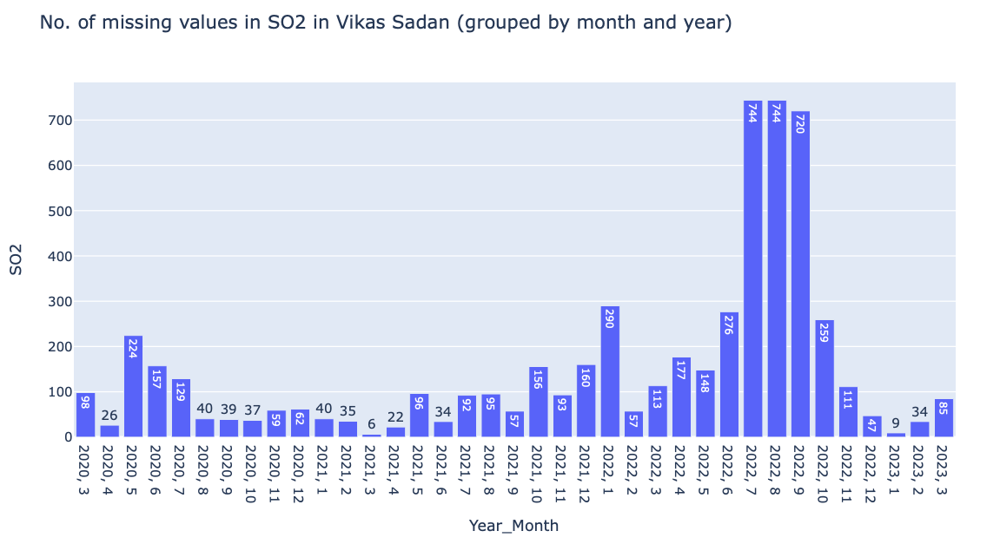

In [203]:
from IPython.display import display, HTML

def helper_1(df, col):
    
    df_na = df[df[col].isna()]
    df_na.fillna(1).groupby(by=['Year', "Month"]).count()
    df_na_col_count = df_na.fillna(1).groupby(
        by=['Year', "Month"])[col].count().reset_index()
    df_na_col_count["Year_Month"] = df_na_col_count["Year"].map(
        str) + ", " + df_na_col_count["Month"].map(str)
    return df_na_col_count

In [204]:
def helper_2(df, col):
    
    df_na = df[df[col].isna()]
    
    df_na.fillna(1).groupby(by=['Year', "Month", "Station"]).count()
    
    df_na_col_count = df_na.fillna(1).groupby(
        by=['Year', "Month", "Station"])[col].count().reset_index()
    
    df_na_col_count["Year_Month"] = df_na_col_count["Year"].map(
        str) + ", " + df_na_col_count["Month"].map(str)

    return df_na_col_count

In [205]:
temp = helper_1(compiled.copy(deep=True), "SO2")
display(temp)

,Year,Month,SO2,Year_Month
0,2015,11,1,"2015, 11"
1,2015,12,372,"2015, 12"
2,2016,1,507,"2016, 1"
3,2016,2,352,"2016, 2"
4,2016,3,464,"2016, 3"
...,...,...,...,...
84,2022,11,974,"2022, 11"
85,2022,12,891,"2022, 12"
86,2023,1,859,"2023, 1"
87,2023,2,806,"2023, 2"


In [206]:
px.bar(data_frame = temp,
       x = "Year_Month",
       y="SO2",
       text_auto=True,
       title="No. of missing values in SO2"
       )

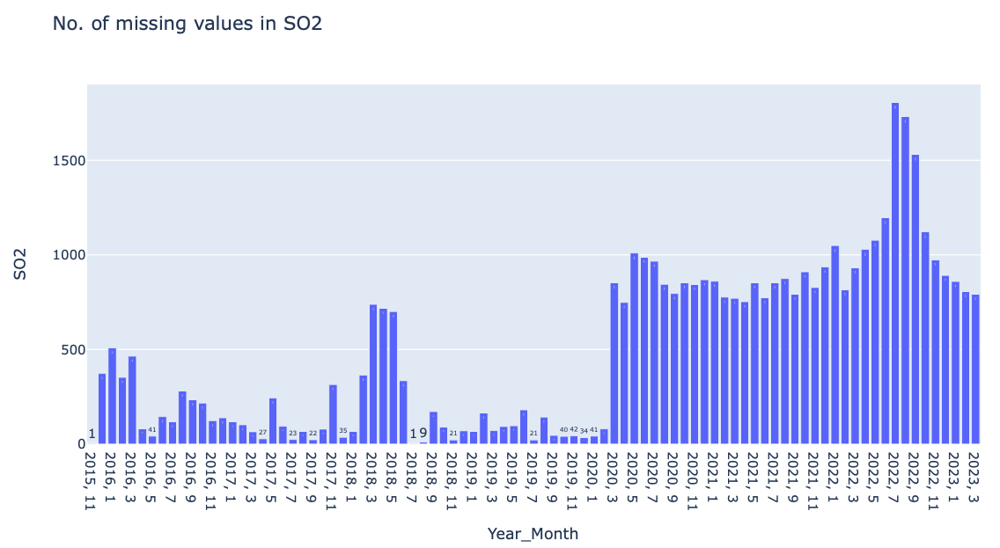

In [208]:
compiled.groupby(['Year','Month','Station'])['SO2'].count().reset_index()

# Not missing values.

px.bar(data_frame = compiled.groupby(['Year','Month','Station'])['SO2'].count().reset_index(),
       x = "Year",
       y="SO2",
       color="Station",
       text_auto=True,
       title="SO2"
       )

,Year,Month,Station,SO2
0,2015,11,No Station,80
1,2015,12,No Station,372
2,2016,1,No Station,237
3,2016,2,No Station,344
4,2016,3,No Station,280
...,...,...,...,...
200,2023,2,Vikas Sadan,638
201,2023,3,NISE,0
202,2023,3,Sector 51,608
203,2023,3,Teri Gram,518


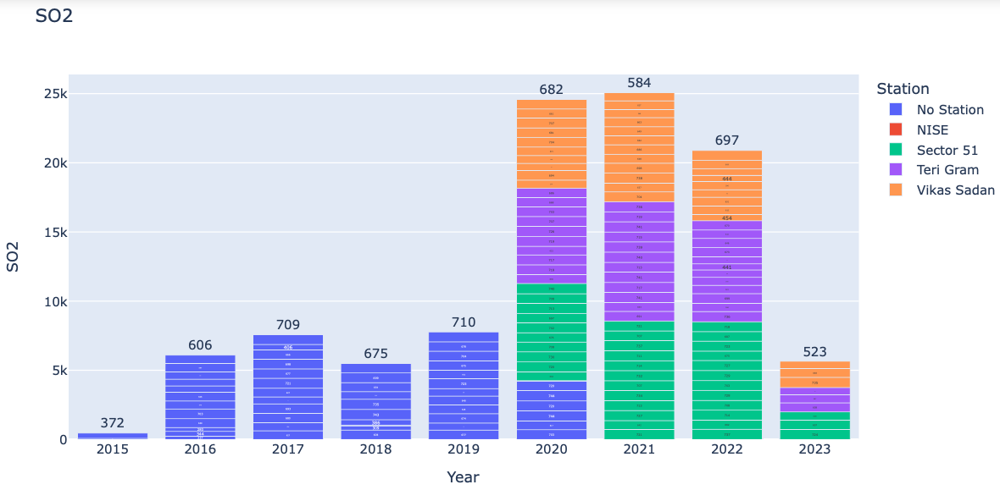

In [209]:
so2_year_month_station = compiled.groupby(['Year','Month','Station'])['SO2'].count().reset_index()
so2_year_month_station

# These are not missing values

,Year,Month,Station,SO2
0,2015,11,No Station,80
1,2015,12,No Station,372
2,2016,1,No Station,237
3,2016,2,No Station,344
4,2016,3,No Station,280
...,...,...,...,...
200,2023,2,Vikas Sadan,638
201,2023,3,NISE,0
202,2023,3,Sector 51,608
203,2023,3,Teri Gram,518


In [234]:
# Create a Plotly color scale
plotly_color_scale = px.colors.qualitative.Plotly

# Extract desired number of colors from the Plotly color scale
plotly_colors = plotly_color_scale

# Create a custom color palette using Plotly colors
custom_colors = plotly_colors
custom_colors

['#636EFA',
 '#EF553B',
 '#00CC96',
 '#AB63FA',
 '#FFA15A',
 '#19D3F3',
 '#FF6692',
 '#B6E880',
 '#FF97FF',
 '#FECB52']

In [210]:
col = "SO2"
px.bar(data_frame = helper_2(compiled.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col
       )

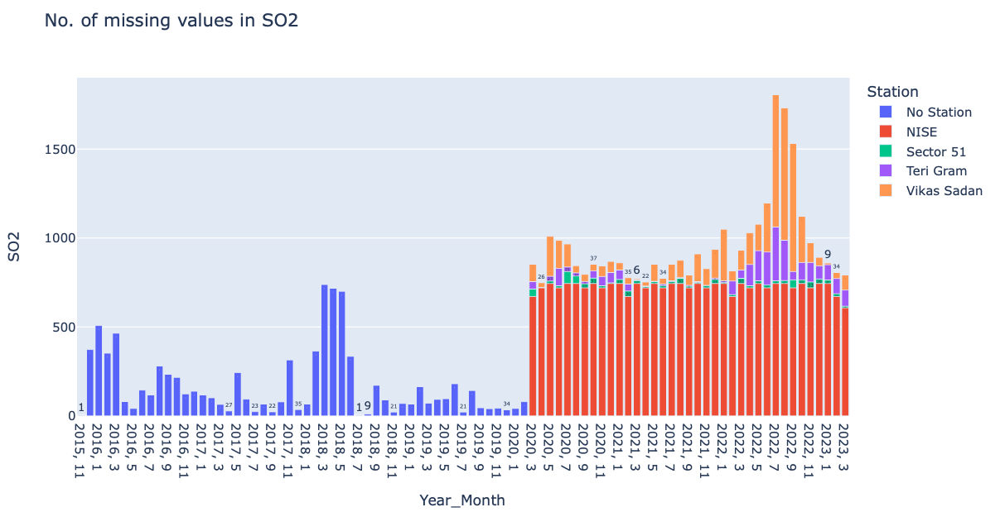

In [211]:
col = "PM10"
px.bar(data_frame = helper_2(compiled.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col
       )

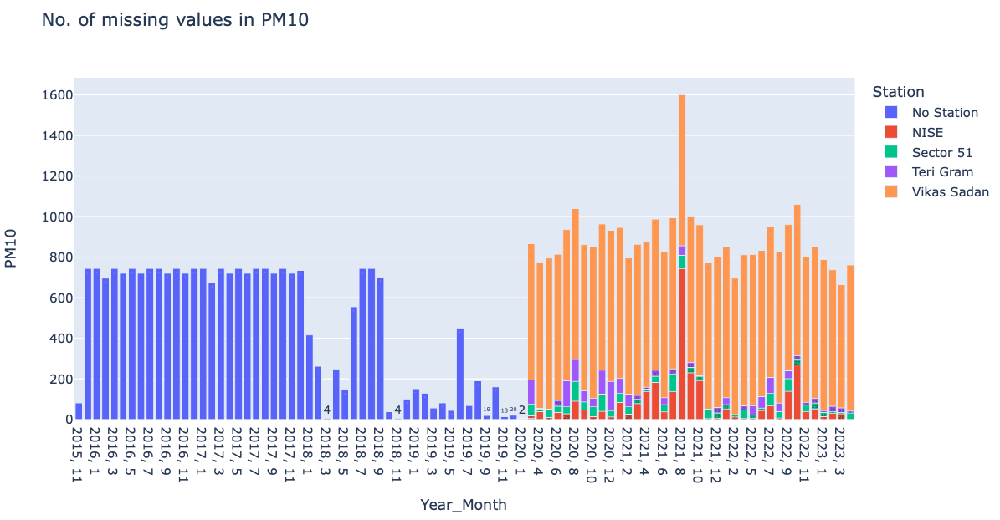

In [214]:
helper_2(compiled.copy(deep=True), col)

,Year,Month,Station,SO2,Year_Month
0,2015,11,No Station,1,"2015, 11"
1,2015,12,No Station,372,"2015, 12"
2,2016,1,No Station,507,"2016, 1"
3,2016,2,No Station,352,"2016, 2"
4,2016,3,No Station,464,"2016, 3"
...,...,...,...,...,...
194,2023,2,Vikas Sadan,34,"2023, 2"
195,2023,3,NISE,608,"2023, 3"
196,2023,3,Sector 51,9,"2023, 3"
197,2023,3,Teri Gram,90,"2023, 3"


Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'PM2.5')

Text(0.5, 1.0, 'Number of missing values in PM2.5')

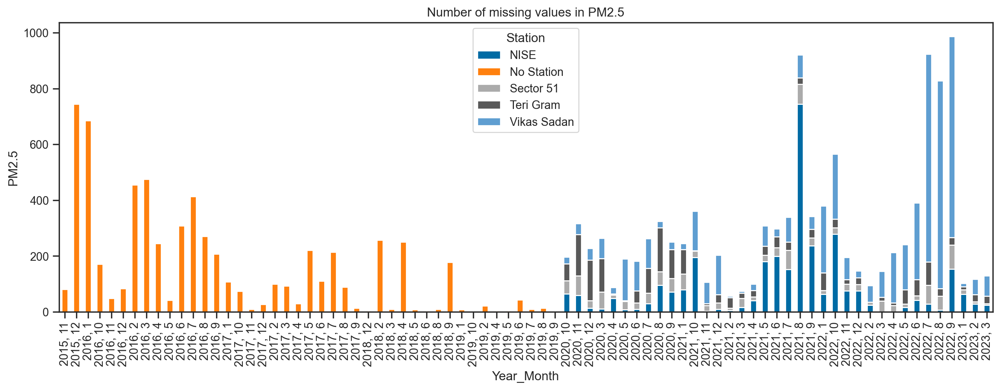

In [224]:
col = 'PM2.5'
temp_df_plot = helper_2(compiled.copy(deep=True), col)
ax = temp_df_plot.groupby(['Year_Month', 'Station'])[col].sum().unstack().plot(kind='bar', stacked=True, figsize=(16, 5))

# Set labels and title
plt.xlabel('Year_Month')
plt.ylabel(col)
plt.title('Number of missing values in ' + col)

# Display the plot
plt.show()



Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'PM2.5')

Text(0.5, 1.0, 'Number of missing values in PM2.5')

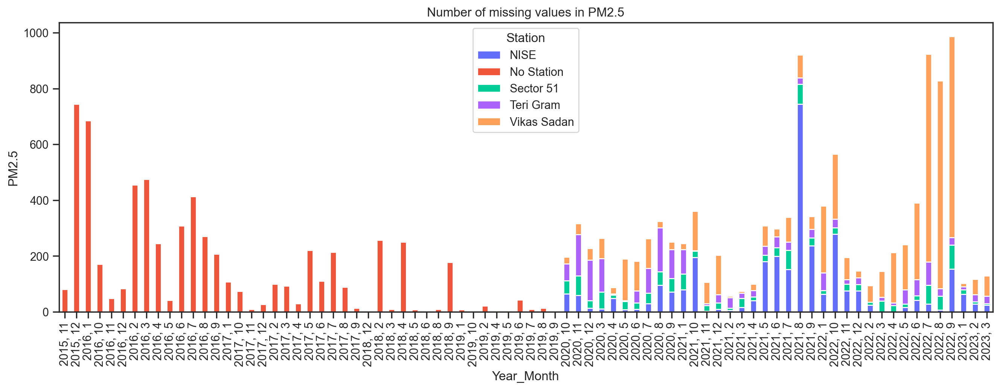

Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'NO')

Text(0.5, 1.0, 'Number of missing values in NO')

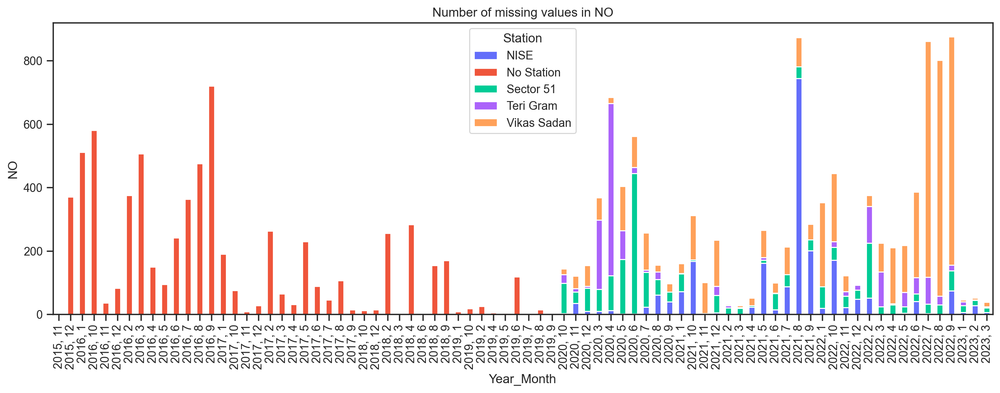

Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'NO2')

Text(0.5, 1.0, 'Number of missing values in NO2')

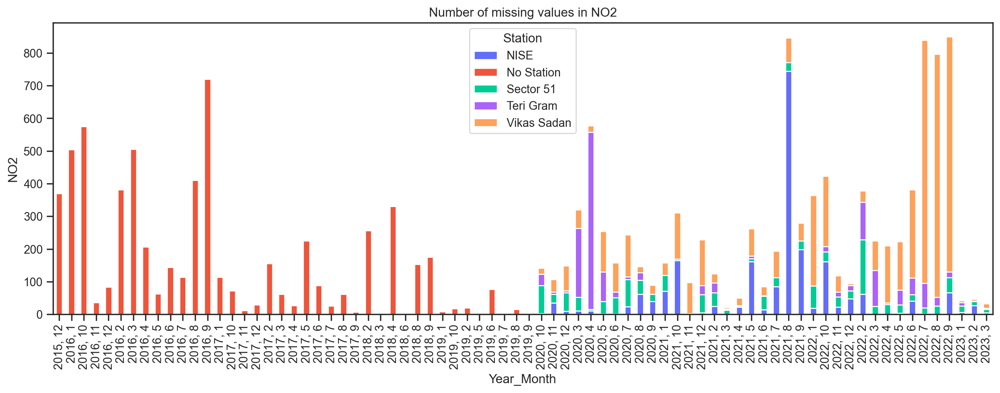

Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'NOx')

Text(0.5, 1.0, 'Number of missing values in NOx')

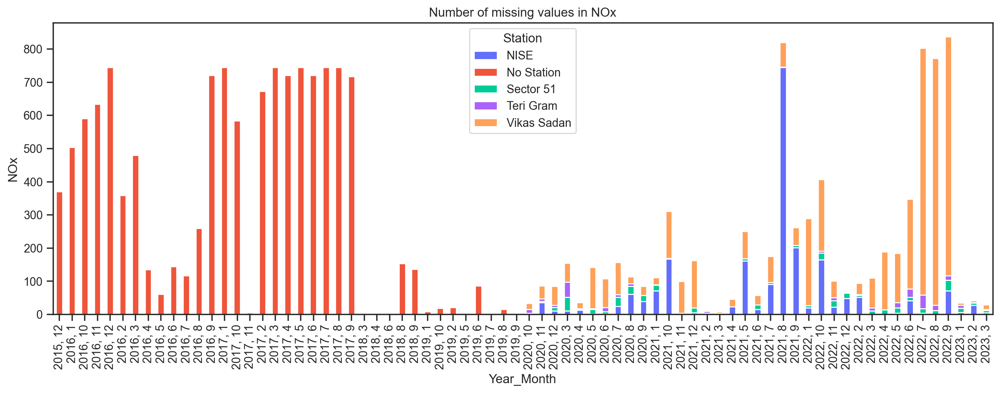

Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'CO')

Text(0.5, 1.0, 'Number of missing values in CO')

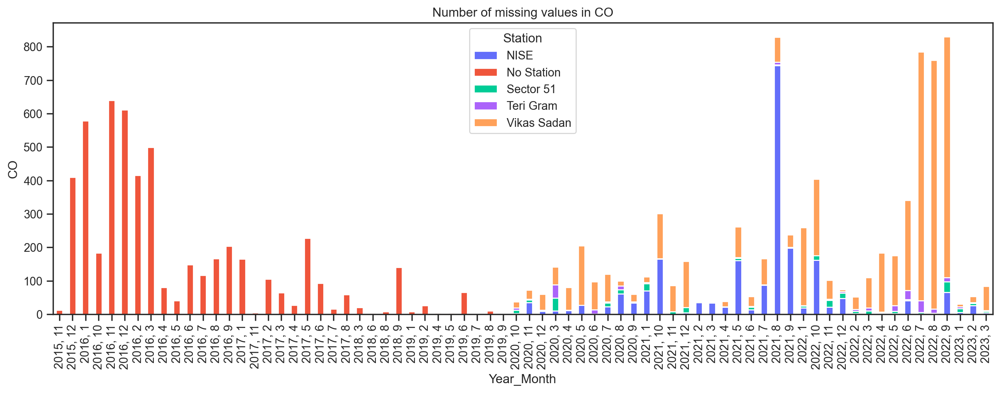

Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'PM10')

Text(0.5, 1.0, 'Number of missing values in PM10')

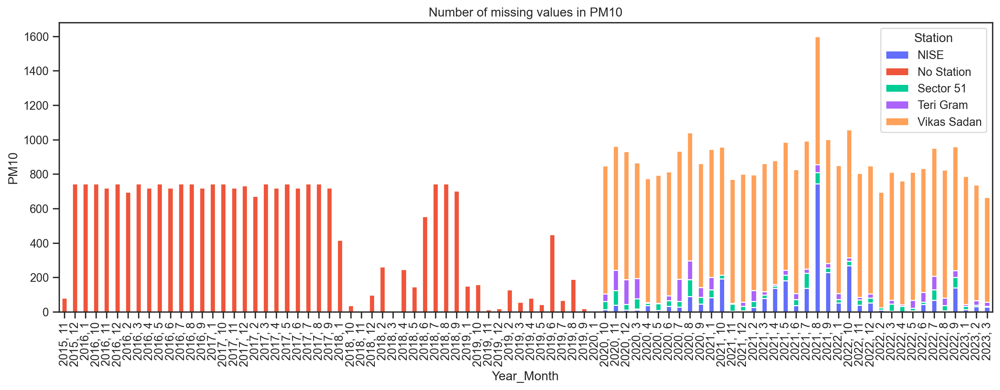

Text(0.5, 0, 'Year_Month')

Text(0, 0.5, 'SO2')

Text(0.5, 1.0, 'Number of missing values in SO2')

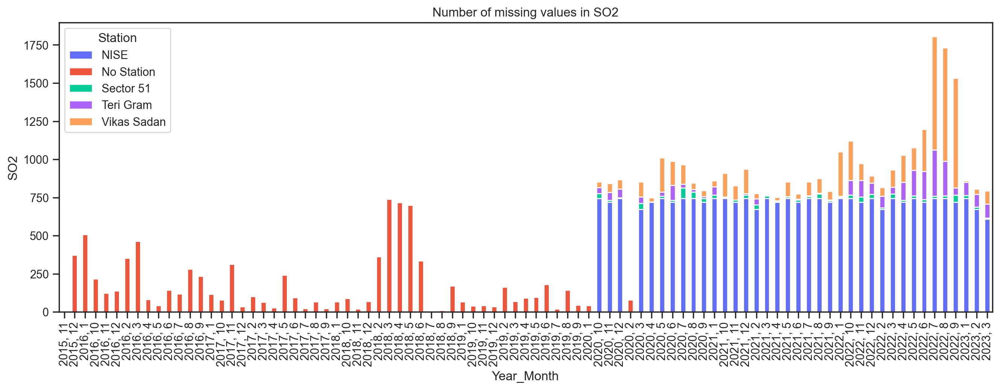

In [235]:
for col in ["PM2.5", "NO", "NO2", "NOx", "CO","PM10", "SO2"]:
    temp_df_plot = helper_2(compiled.copy(deep=True), col)
    ax = temp_df_plot.groupby(['Year_Month', 'Station'])[col].sum().unstack().plot(kind='bar', stacked=True, figsize=(16, 5), color=custom_colors)

    # Set labels and title
    plt.xlabel('Year_Month')
    plt.ylabel(col)
    plt.title('Number of missing values in ' + col)

    # Display the plot
    plt.show()

In [212]:
for col in ["PM2.5", "NO", "NO2", "NOx", "CO","PM10", "SO2"]:
    px.bar(data_frame = helper_2(compiled.copy(deep=True), col),
           x = "Year_Month",
           y = col,
           color="Station",
           text_auto = True,
           title = "No. of missing values in "+ col
           )

In [236]:
compiled.groupby(['Year','Month','Station'])['SO2'].count().reset_index()[-30:]
compiled.groupby(['Year','Month'])['SO2'].count().reset_index()[-10:]

,Year,Month,Station,SO2
175,2022,8,Teri Gram,517
176,2022,8,Vikas Sadan,0
177,2022,9,NISE,0
178,2022,9,Sector 51,675
179,2022,9,Teri Gram,673
180,2022,9,Vikas Sadan,0
181,2022,10,NISE,0
182,2022,10,Sector 51,723
183,2022,10,Teri Gram,646
184,2022,10,Vikas Sadan,485


,Year,Month,SO2
79,2022,6,1683
80,2022,7,1170
81,2022,8,1244
82,2022,9,1348
83,2022,10,1854
84,2022,11,1906
85,2022,12,2085
86,2023,1,2117
87,2023,2,1882
88,2023,3,1649


In [237]:
compiled.groupby(['Year', 'Month'])['PM10'].count().reset_index()

,Year,Month,PM10
0,2015,11,0
1,2015,12,0
2,2016,1,0
3,2016,2,0
4,2016,3,0
...,...,...,...
84,2022,11,2075
85,2022,12,2127
86,2023,1,2188
87,2023,2,1951


In [238]:
compiled.sort_values(['Year'])

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107958,2015-12-26 04:00:00,No Station,NaN,16.67,17.24,17.71,4.05,1.53,NaN,NaN,...,NaN,NaN,3.4,NaN,nan,26,12,2015,52,4
107816,2015-12-20 06:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,20,12,2015,51,6
107817,2015-12-20 07:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,20,12,2015,51,7
107818,2015-12-20 08:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,20,12,2015,51,8
107819,2015-12-20 09:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,20,12,2015,51,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25462,2023-01-28 22:00:00,Vikas Sadan,222.74,16.31,28.29,35.02,169.14,1.30,110.13,6.25,...,NaN,NaN,NaN,NaN,nan,28,1,2023,4,22
25461,2023-01-28 21:00:00,Vikas Sadan,174.74,16.61,28.79,35.22,148.72,2.56,157.35,6.31,...,NaN,NaN,NaN,NaN,nan,28,1,2023,4,21
25460,2023-01-28 20:00:00,Vikas Sadan,160.08,16.43,28.36,34.12,119.96,1.80,95.86,6.27,...,NaN,NaN,NaN,NaN,nan,28,1,2023,4,20
25473,2023-01-29 09:00:00,Vikas Sadan,145.97,23.76,26.68,55.71,106.81,0.99,32.12,7.44,...,NaN,NaN,NaN,NaN,nan,29,1,2023,4,9


In [239]:
compiled[compiled["SO2"].isna()]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
64,2020-03-06 16:00:00,Vikas Sadan,13.32,7.66,51.92,31.73,NaN,2.90,45.1,2.00,...,NaN,NaN,NaN,NaN,nan,6,3,2020,10,16
97,2020-03-08 01:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,8,3,2020,10,1
100,2020-03-08 04:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,8,3,2020,10,4
127,2020-03-09 07:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,9,3,2020,11,7
137,2020-03-09 17:00:00,Vikas Sadan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,nan,9,3,2020,11,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144550,2020-02-27 20:00:00,No Station,75.94,16.15,67.78,53.32,NaN,1.48,NaN,1.93,...,NaN,NaN,24.48,195.0,Moderate,27,2,2020,9,20
144591,2020-02-29 13:00:00,No Station,72.79,7.37,9.25,16.62,NaN,1.39,NaN,NaN,...,NaN,NaN,68.43,120.0,Moderate,29,2,2020,9,13
144592,2020-02-29 14:00:00,No Station,65.91,7.21,8.57,15.78,NaN,1.35,NaN,NaN,...,NaN,NaN,74.62,119.0,Moderate,29,2,2020,9,14
144593,2020-02-29 15:00:00,No Station,69.50,7.35,9.77,17.11,NaN,1.38,NaN,NaN,...,NaN,NaN,76.68,118.0,Moderate,29,2,2020,9,15


In [240]:
# sns.lineplot(data = vikas_sadan[vikas_sadan['SO2'].isna()], x="Datetime", y="SO2")
# Since there are only NaNs it is keyError, there is nothing to plot.

<Figure size 1400x500 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='NO'>

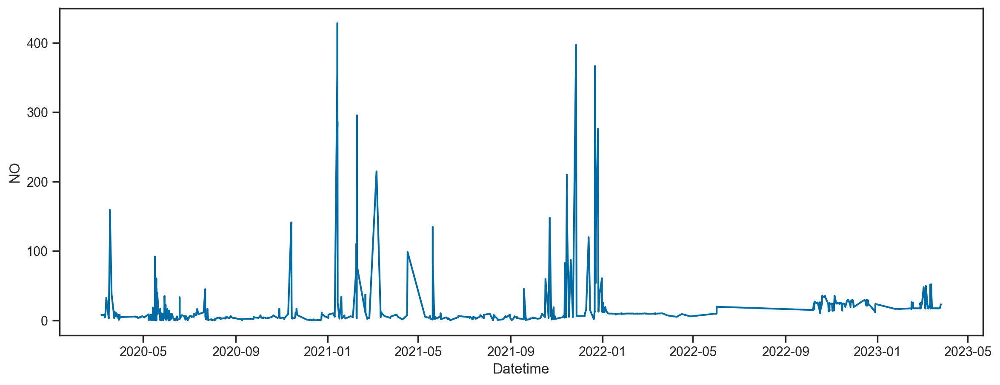

In [241]:
plt.figure(figsize=(14,5))
sns.lineplot(data = vikas_sadan[vikas_sadan['SO2'].isna()], x="Datetime", y="NO")

In [242]:
# Since this is a time series data, use ffill, bfill, linear interpolation for filling NAs
compiled['Datetime'][:107273]
compiled['Datetime'][107273:]

0        2020-03-04 00:00:00
1        2020-03-04 01:00:00
2        2020-03-04 02:00:00
3        2020-03-04 03:00:00
4        2020-03-04 04:00:00
                 ...        
107268   2023-03-26 03:00:00
107269   2023-03-26 04:00:00
107270   2023-03-26 05:00:00
107271   2023-03-26 06:00:00
107272   2023-03-26 07:00:00
Name: Datetime, Length: 107273, dtype: datetime64[ns]

107273   2015-11-27 15:00:00
107274   2015-11-27 16:00:00
107275   2015-11-27 17:00:00
107276   2015-11-27 18:00:00
107277   2015-11-27 19:00:00
                 ...        
147526   2020-06-30 20:00:00
147527   2020-06-30 21:00:00
147528   2020-06-30 22:00:00
147529   2020-06-30 23:00:00
147530   2020-07-01 00:00:00
Name: Datetime, Length: 40258, dtype: datetime64[ns]

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='SO2'>

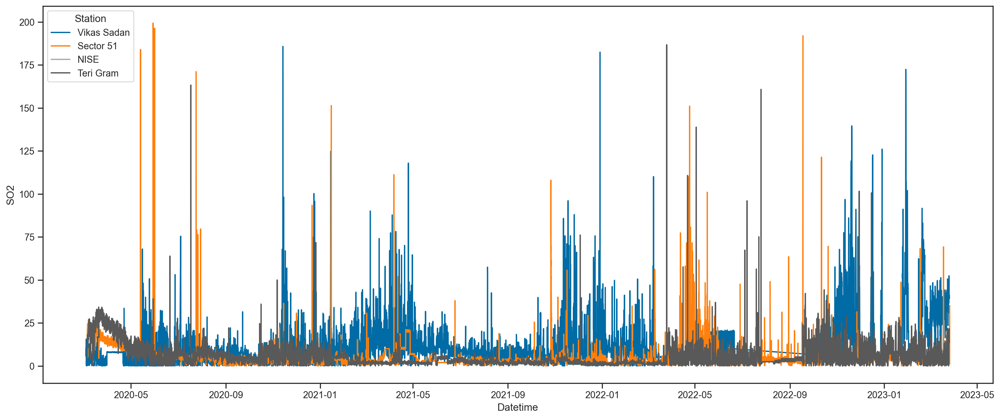

In [243]:
plt.figure(figsize=(20,8))
sns.lineplot(data=compiled[:107273], x="Datetime", y="SO2", hue="Station")

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='SO2'>

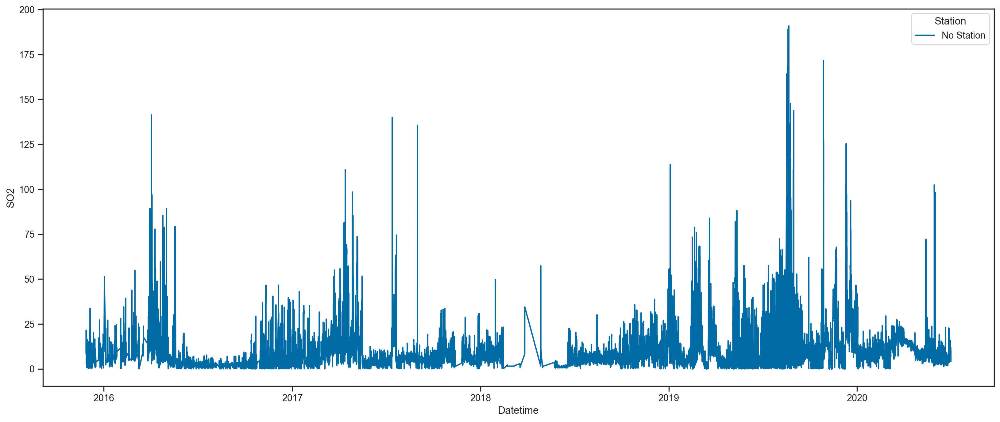

In [244]:
plt.figure(figsize=(20,8))
sns.lineplot(data=compiled[107273:], x="Datetime", y="SO2", hue="Station")

<AxesSubplot: ylabel='SO2'>

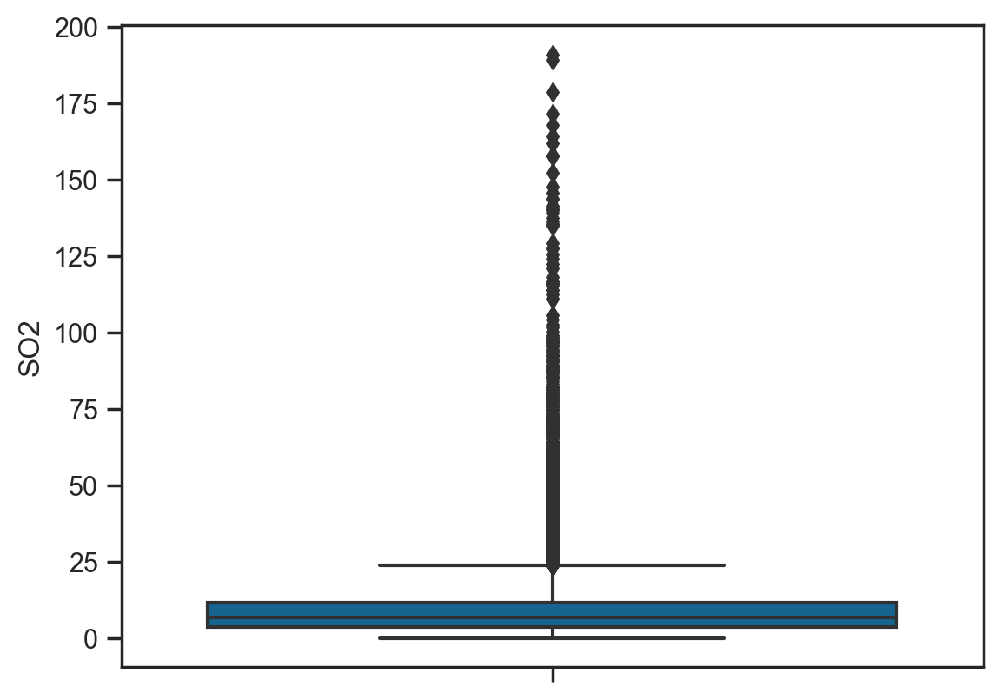

In [245]:
sns.boxplot(data=compiled[107273:],y="SO2")

<AxesSubplot: ylabel='SO2'>

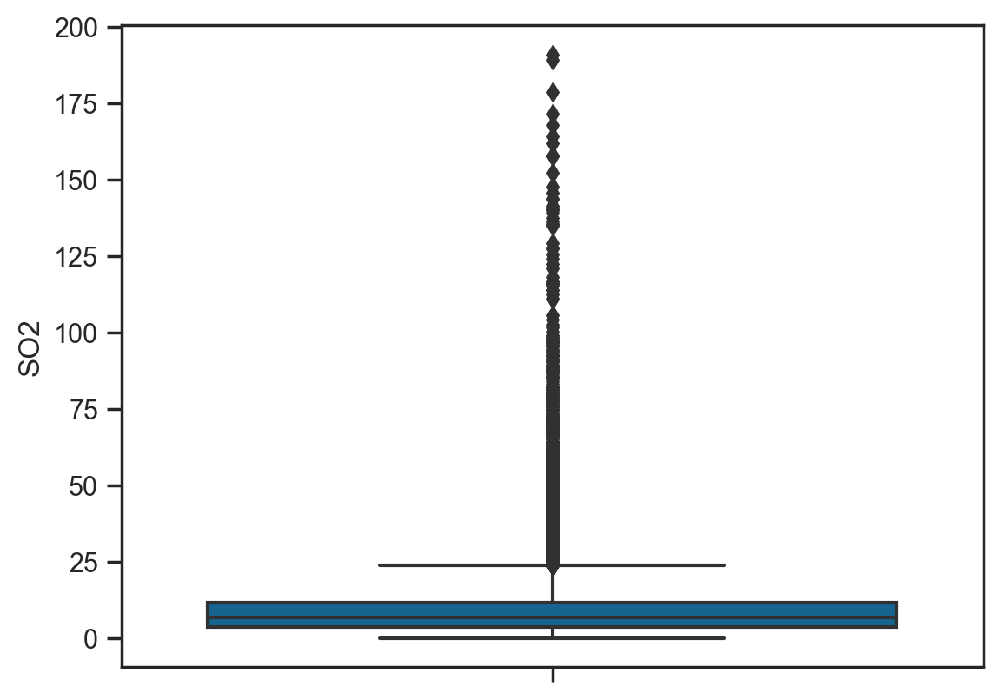

In [246]:
sns.boxplot(data=compiled[107273:],y="SO2")

<AxesSubplot: title={'center': 'SO2'}, xlabel='[Station]'>

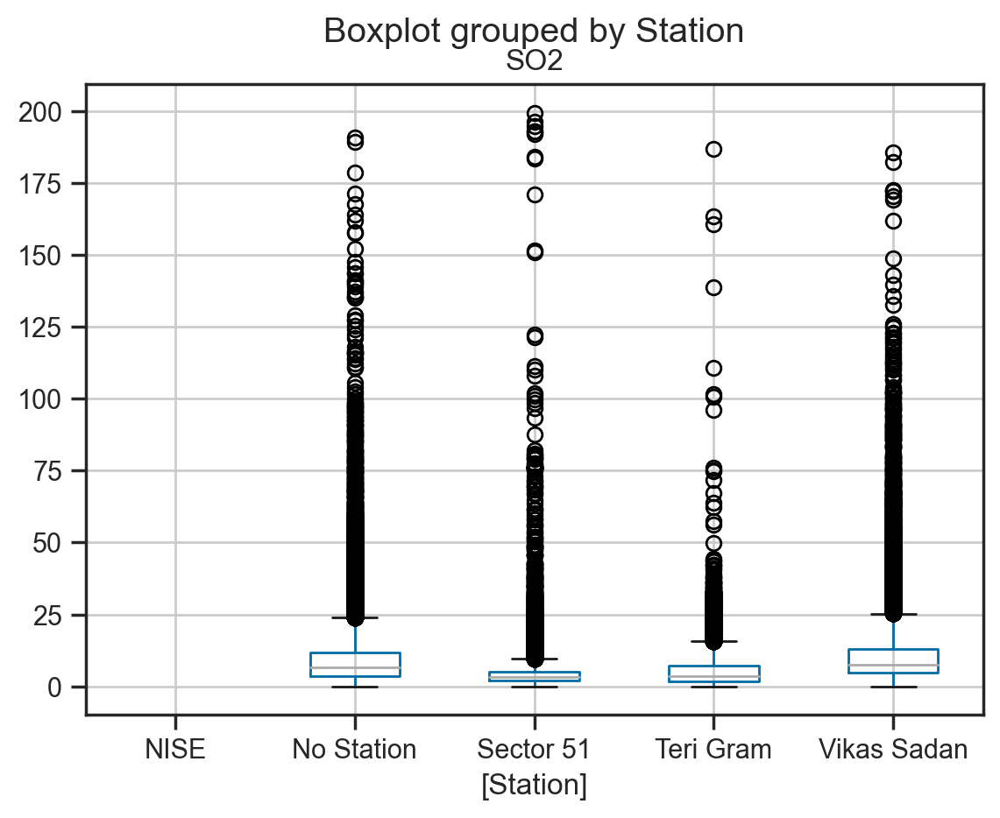

In [247]:
compiled.boxplot(column='SO2', by=['Station'])

In [248]:
# Let's drop >40% columns
temp = compiled.apply(lambda x : round(((x.isnull().sum() + (x=="None").sum())/compiled.shape[0])*100, 2))
temp[temp>40].index

Index(['Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp', 'RH', 'WS', 'WD',
       'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'NH3', 'CO2', 'O3', 'AQI'],
      dtype='object')

In [249]:
compiled.columns.difference(set(['Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp', 'RH', 'WS', 'WD',
       'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'NH3', 'CO2', 'O3']))

# set(['AQI', 'AQI_Bucket', 'Benzene', 'CO', 'Datetime', 'NO', 'NO2', 'NOx', 'Ozone', 'PM10', 'PM2.5', 'SO2', 'Station', 'TOT-RF']).add(set(['Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp', 'RH', 'WS', 'WD','SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'NH3', 'CO2', 'O3']))


# compiled.drop(columns = ['Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp', 'RH', 'WS', 'WD',
#        'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'NH3', 'CO2', 'O3'], inplace=True)
compiled

Index(['AQI', 'AQI_Bucket', 'Benzene', 'CO', 'Datetime', 'Day', 'Hour',
       'Month', 'NO', 'NO2', 'NOx', 'Ozone', 'PM10', 'PM2.5', 'SO2', 'Station',
       'TOT-RF', 'Week', 'Year'],
      dtype='object')

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,...,NH3,CO2,O3,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,0
1,2020-03-04 01:00:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,1
2,2020-03-04 02:00:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,2
3,2020-03-04 03:00:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,3
4,2020-03-04 04:00:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,...,NaN,NaN,NaN,NaN,nan,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,No Station,54.74,6.23,10.67,12.60,4.18,0.60,NaN,2.14,...,2.95,NaN,70.95,154.0,Moderate,30,6,2020,27,20
147527,2020-06-30 21:00:00,No Station,54.37,6.30,10.28,11.88,4.03,1.20,NaN,1.87,...,3.47,NaN,55.13,154.0,Moderate,30,6,2020,27,21
147528,2020-06-30 22:00:00,No Station,50.34,6.93,10.36,13.01,6.17,1.00,NaN,2.41,...,3.76,NaN,42.60,155.0,Moderate,30,6,2020,27,22
147529,2020-06-30 23:00:00,No Station,53.23,6.64,10.30,12.75,6.31,0.86,NaN,2.54,...,3.36,NaN,35.61,156.0,Moderate,30,6,2020,27,23


In [250]:
compiled.groupby(['Station']).apply(lambda x : ((x.isnull().sum() + (x=="None").sum())/compiled.shape[0])*100 ).T

Station,NISE,No Station,Sector 51,Teri Gram,Vikas Sadan
Datetime,0.000000,0.000000,0.000000,0.000000,0.000000
Station,0.000000,0.000000,0.000000,0.000000,0.000000
PM2.5,2.139211,4.164548,0.825589,1.153656,3.414198
NO,1.452576,4.572598,1.450543,1.026903,3.320658
NO2,1.451898,4.104222,0.886593,1.033003,3.313880
NOx,1.449187,8.609716,0.288075,0.182335,3.240675
SO2,18.176519,5.859785,0.496845,1.512225,3.776156
CO,1.455965,3.499603,0.210803,0.157933,3.286767
Ozone,1.411907,27.287824,0.487355,0.452108,3.980180
Benzene,18.176519,8.596837,7.460805,0.289431,3.105110


In [251]:
px.bar(compiled.groupby(['Station']).apply(lambda x : round(((x.isnull().sum() + (x=="None").sum())/compiled.shape[0])*100, 2) ).T, text_auto=True)

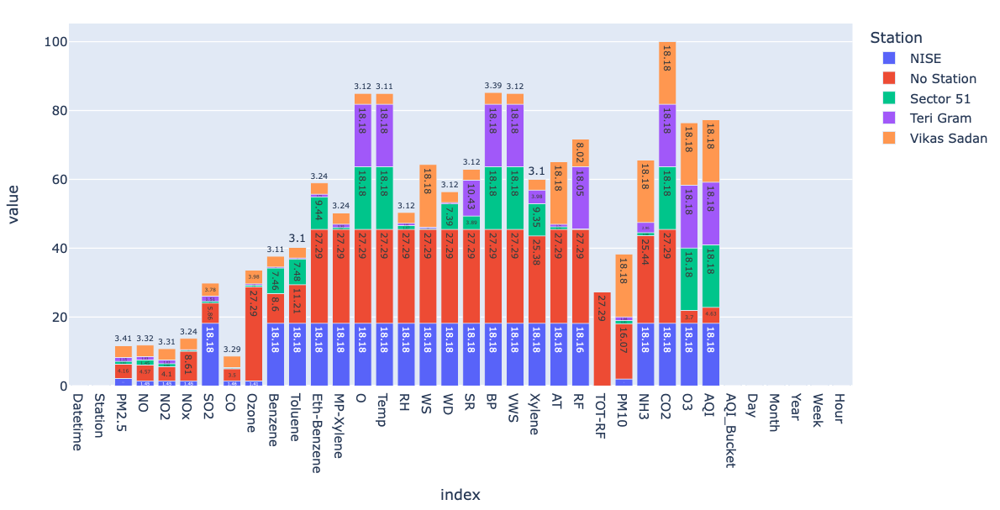

In [252]:
# AQI and bucket can be computed
['Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp', 'RH', 'WS', 'WD',
       'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'NH3', 'CO2', 'O3']
compiled.columns

['Toluene',
 'Eth-Benzene',
 'MP-Xylene',
 'O',
 'Temp',
 'RH',
 'WS',
 'WD',
 'SR',
 'BP',
 'VWS',
 'Xylene',
 'AT',
 'RF',
 'NH3',
 'CO2',
 'O3']

Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp',
       'RH', 'WS', 'WD', 'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'TOT-RF',
       'PM10', 'NH3', 'CO2', 'O3', 'AQI', 'AQI_Bucket', 'Day', 'Month', 'Year',
       'Week', 'Hour'],
      dtype='object')

## Removing columns where missing % is >40

In [253]:
compiled.drop(['Toluene', 'Eth-Benzene', 'MP-Xylene', 'O', 'Temp', 'RH', 'WS', 'WD', 'SR', 'BP', 'VWS', 'Xylene', 'AT', 'RF', 'NH3', 'CO2', 'O3'], axis = 1, inplace=True)

In [254]:
compiled["AQI_Bucket"].value_counts()

nan             114111
Moderate         10271
Very Poor         8489
Poor              6326
Satisfactory      5552
Severe            2180
Good               602
Name: AQI_Bucket, dtype: int64

In [255]:
compiled["AQI"].value_counts(dropna=False)

NaN      114111
100.0       171
92.0        171
76.0        169
142.0       168
          ...  
747.0         1
728.0         1
581.0         1
640.0         1
580.0         1
Name: AQI, Length: 679, dtype: int64

In [256]:
px.bar(compiled.groupby(['Station']).apply(lambda x : round(((x.isnull().sum() + (x=="nan").sum())/compiled.shape[0])*100, 2) ).T, text_auto=True)

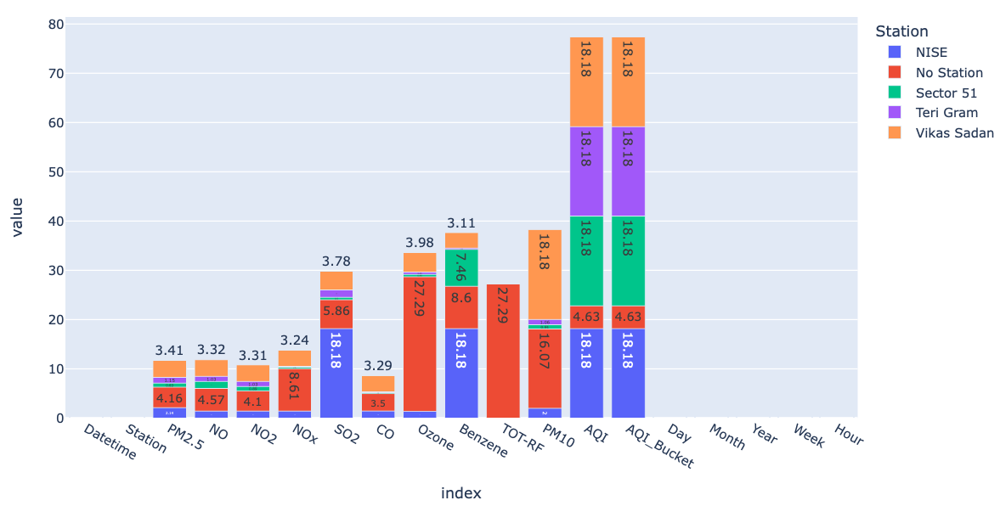

## Exploring PM2.5

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

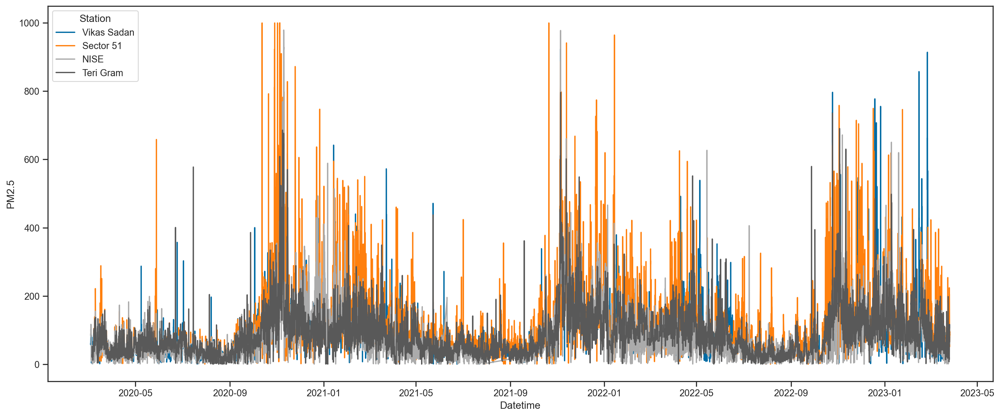

In [257]:
plt.figure(figsize=(20,8))
sns.lineplot(data=compiled[:107273], x="Datetime", y="PM2.5", hue="Station")

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

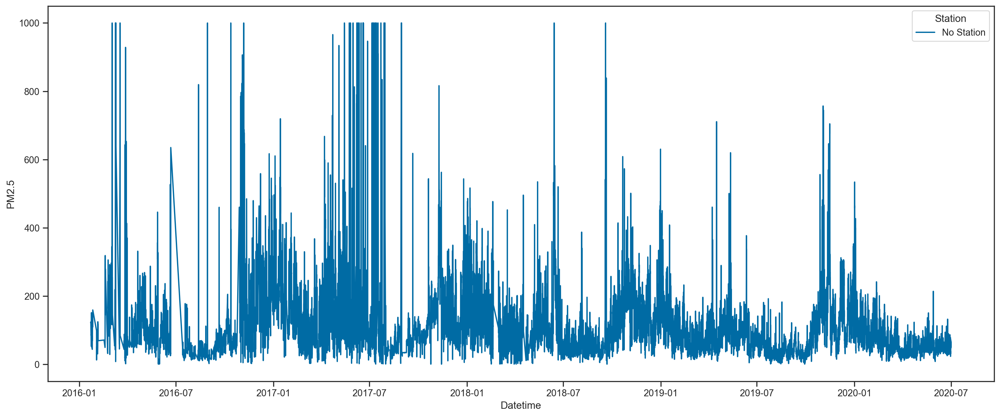

In [258]:
plt.figure(figsize=(20,8))
sns.lineplot(data=compiled[107273:], x="Datetime", y="PM2.5", hue="Station")

In [259]:
col = "PM2.5"
px.bar(data_frame = helper_2(compiled.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col
       )

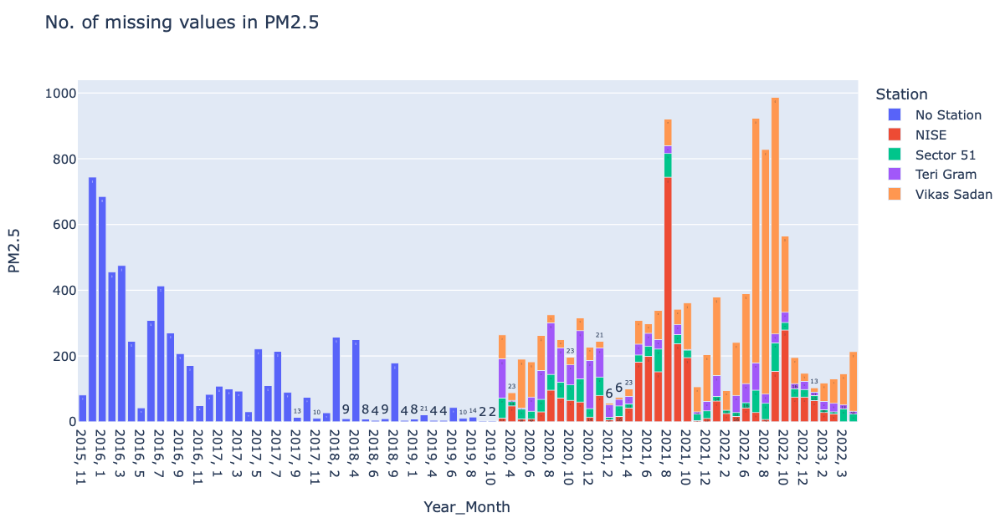

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

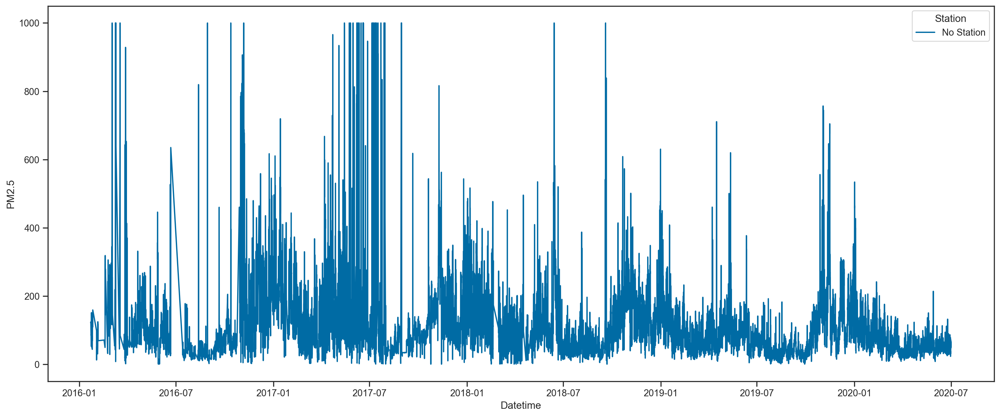

In [260]:
# Let's look year wise

plt.figure(figsize=(20,8))
sns.lineplot(data=compiled[107273:], x="Datetime", y="PM2.5", hue="Station")

In [261]:
compiled.groupby(["Year"]).count()

# Since datetime has no missing values, we can consider it.

year_wise_count = compiled.groupby(["Year"])["Datetime"].count()
year_wise_count

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Week,Hour
Year,,,,,,,,,,,,,,,,,,
2015,825,825,0,454,455,455,452,403,0,0,0,0,0,825,825,825,825,825
2016,8784,8784,5381,4647,5043,4041,6087,5098,0,1108,0,0,5113,8784,8784,8784,8784,8784
2017,8760,8760,7671,7613,7881,1623,7577,7997,0,7924,0,10,7393,8760,8760,8760,8760,8760
2018,8760,8760,8041,7865,7840,8463,5481,8588,0,6056,0,4799,7921,8760,8760,8760,8760,8760
2019,8760,8760,8652,8564,8615,8605,7767,8640,0,8209,0,7380,8624,8760,8760,8760,8760,8760
2020,33457,33457,31157,30511,31274,32461,24572,32483,27123,25322,29088,24625,4369,33457,33457,33457,33457,33457
2021,35040,35040,31685,32390,32383,32727,25066,32717,32398,22682,35040,23613,0,35040,35040,35040,35040,35040
2022,35040,35040,29932,30073,30139,30840,20885,30964,30579,14719,35040,24827,0,35040,35040,35040,35040,35040
2023,8105,8105,7755,7971,7983,8001,5648,7937,7832,5997,8105,5915,0,8105,8105,8105,8105,8105


Year
2015      825
2016     8784
2017     8760
2018     8760
2019     8760
2020    33457
2021    35040
2022    35040
2023     8105
Name: Datetime, dtype: int64

In [262]:
compiled[compiled['Year'] == 2015]
compiled[compiled['Year'] == 2016]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,NaN,NaN,12.50,5.85,NaN,0.08,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,NaN,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,NaN,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,NaN,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,NaN,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108093,2015-12-31 19:00:00,No Station,NaN,10.36,12.07,13.12,3.68,2.05,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,19
108094,2015-12-31 20:00:00,No Station,NaN,11.22,21.07,13.74,4.07,1.37,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,20
108095,2015-12-31 21:00:00,No Station,NaN,15.37,13.01,16.17,8.63,1.39,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,21
108096,2015-12-31 22:00:00,No Station,NaN,5.17,15.99,11.18,11.13,1.54,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,22


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
108098,2016-01-01 00:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,0
108099,2016-01-01 01:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,1
108100,2016-01-01 02:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,2
108101,2016-01-01 03:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,3
108102,2016-01-01 04:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116877,2016-12-31 19:00:00,No Station,183.79,7.47,10.49,NaN,3.88,22.74,NaN,2.67,NaN,NaN,379.0,Very Poor,31,12,2016,52,19
116878,2016-12-31 20:00:00,No Station,201.53,7.86,10.24,NaN,2.36,27.72,NaN,2.89,NaN,NaN,379.0,Very Poor,31,12,2016,52,20
116879,2016-12-31 21:00:00,No Station,233.52,7.47,10.24,NaN,3.41,35.21,NaN,1.89,NaN,NaN,407.0,Severe,31,12,2016,52,21
116880,2016-12-31 22:00:00,No Station,268.24,7.47,10.27,NaN,3.96,34.39,NaN,4.22,NaN,NaN,407.0,Severe,31,12,2016,52,22


In [263]:
abs(compiled[compiled['Year'] == 2015].index[0] - compiled[compiled['Year'] == 2016].index[0])
year_wise_count[2015]

825

825

### 2015 - PM2.5

In [264]:
compiled_2015 = compiled[compiled['Year'] == 2015]
# compiled_2015.index[0]
compiled_2015
compiled_2015.columns

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,NaN,NaN,12.50,5.85,NaN,0.08,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,NaN,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,NaN,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,NaN,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,NaN,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108093,2015-12-31 19:00:00,No Station,NaN,10.36,12.07,13.12,3.68,2.05,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,19
108094,2015-12-31 20:00:00,No Station,NaN,11.22,21.07,13.74,4.07,1.37,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,20
108095,2015-12-31 21:00:00,No Station,NaN,15.37,13.01,16.17,8.63,1.39,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,21
108096,2015-12-31 22:00:00,No Station,NaN,5.17,15.99,11.18,11.13,1.54,NaN,NaN,NaN,NaN,NaN,nan,31,12,2015,53,22


Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'TOT-RF', 'PM10', 'AQI', 'AQI_Bucket', 'Day',
       'Month', 'Year', 'Week', 'Hour'],
      dtype='object')

In [205]:
# plt.figure(figsize=(20, 8))
# sns.lineplot(data=compiled_2015, x="Datetime", y="PM2.5", hue="Station")

# Getting error because in 2015, PM2.5 has all missing values or no values (refer to year_wise_count)

In [268]:
col = "PM2.5"
px.bar(data_frame = helper_2(compiled_2015.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col +" in 2015"
       )

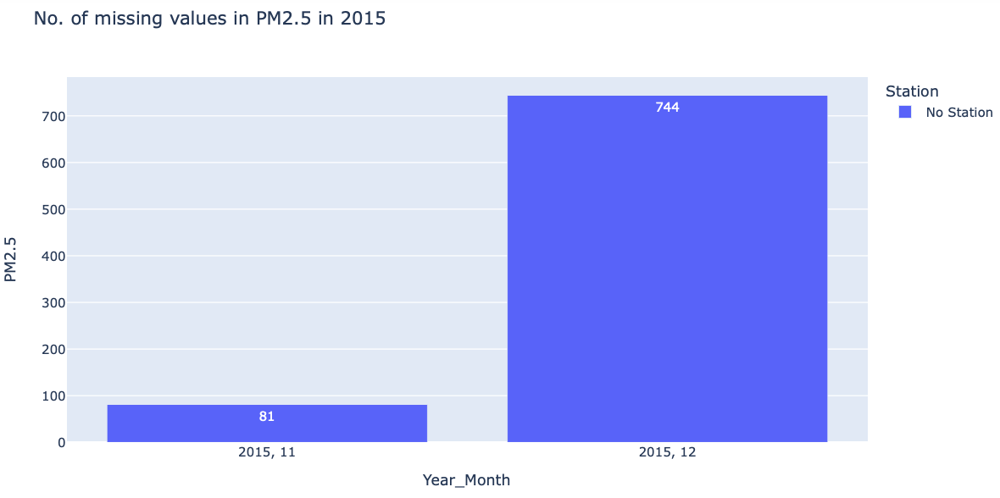

### PM2.5 - 2016

In [266]:
compiled_2016 = compiled[compiled['Year'] == 2016]
compiled_2016
compiled_2016.columns

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
108098,2016-01-01 00:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,0
108099,2016-01-01 01:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,1
108100,2016-01-01 02:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,2
108101,2016-01-01 03:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,3
108102,2016-01-01 04:00:00,No Station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,1,1,2016,53,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116877,2016-12-31 19:00:00,No Station,183.79,7.47,10.49,NaN,3.88,22.74,NaN,2.67,NaN,NaN,379.0,Very Poor,31,12,2016,52,19
116878,2016-12-31 20:00:00,No Station,201.53,7.86,10.24,NaN,2.36,27.72,NaN,2.89,NaN,NaN,379.0,Very Poor,31,12,2016,52,20
116879,2016-12-31 21:00:00,No Station,233.52,7.47,10.24,NaN,3.41,35.21,NaN,1.89,NaN,NaN,407.0,Severe,31,12,2016,52,21
116880,2016-12-31 22:00:00,No Station,268.24,7.47,10.27,NaN,3.96,34.39,NaN,4.22,NaN,NaN,407.0,Severe,31,12,2016,52,22


Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'TOT-RF', 'PM10', 'AQI', 'AQI_Bucket', 'Day',
       'Month', 'Year', 'Week', 'Hour'],
      dtype='object')

In [269]:
col = "PM2.5"
px.bar(data_frame = helper_2(compiled_2016.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col + " in 2016"
       )

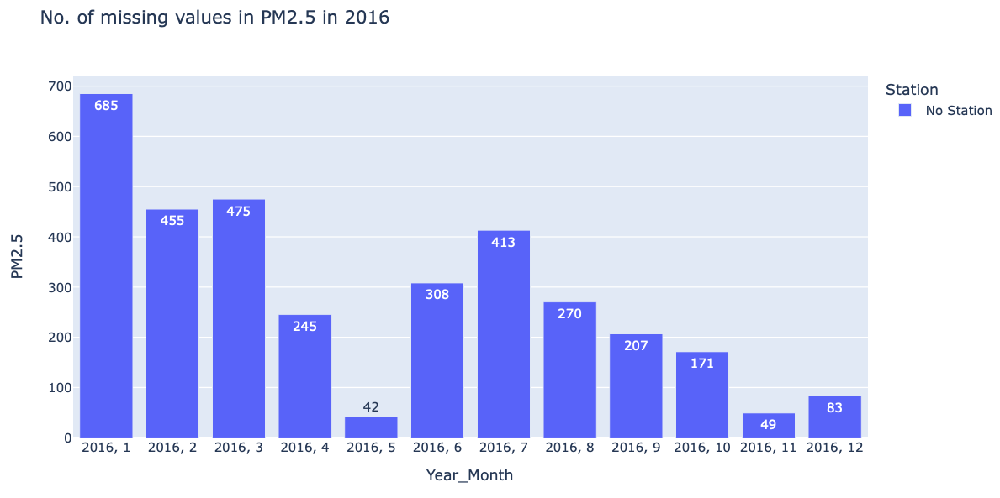

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

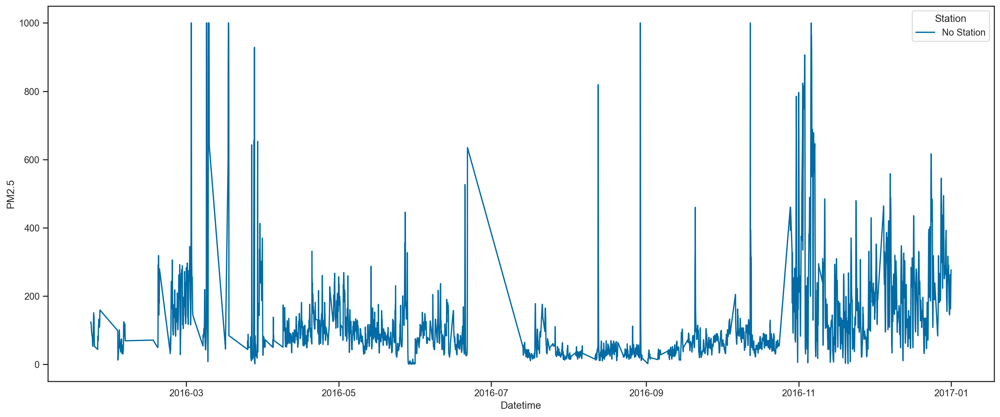

In [270]:
plt.figure(figsize=(20, 8))
sns.lineplot(data=compiled_2016, x="Datetime", y="PM2.5", hue="Station", markers=['o']) 

# Seaborn fills missing values
# There are no gaps in between for mising values

# Getting error because in 2015, PM2.5 has all missing values or no values (refer to year_wise_count)

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

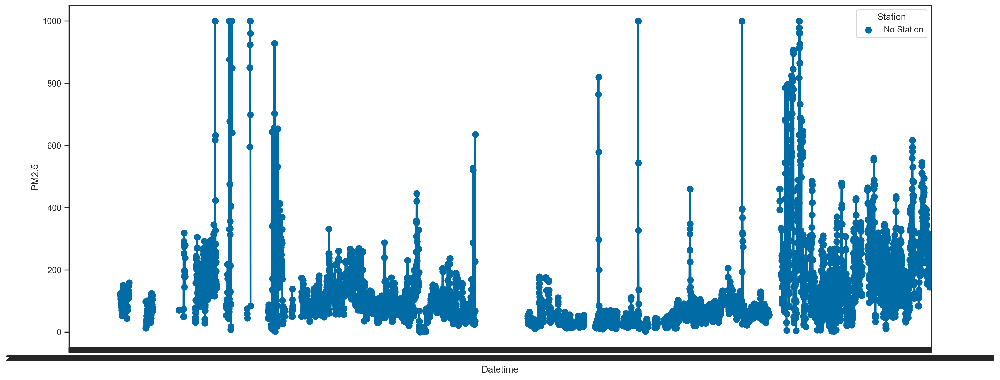

In [271]:
plt.figure(figsize=(20, 8))
sns.pointplot(data=compiled_2016, x="Datetime", y="PM2.5", hue="Station") 

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

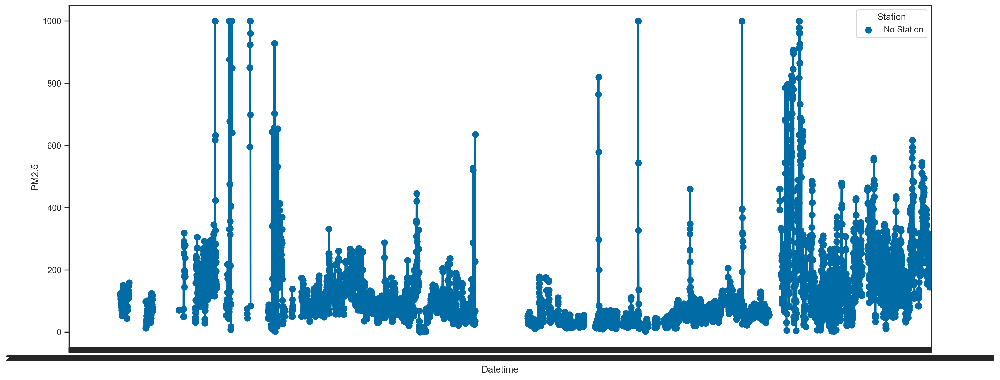

In [211]:
plt.figure(figsize=(20, 8))
sns.pointplot(data=compiled_2016, x="Datetime", y="PM2.5", hue="Station", dodge=True) 

#### Total data points in the graph
- Each day has 24 data points
- Each year has 365 days
- Total data points = 365 * 24 = 8760

In [272]:
px.line(data_frame=compiled_2016, x="Datetime", y="PM2.5")

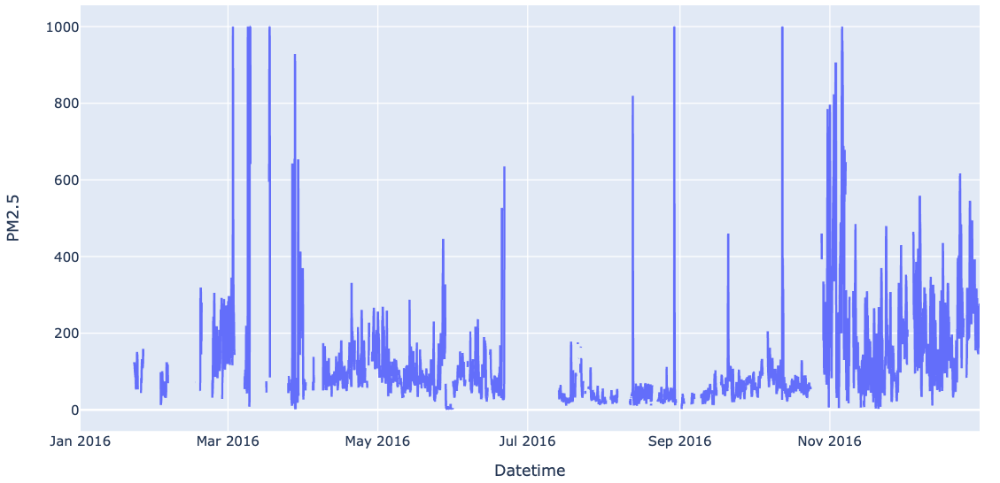

In [273]:
px.line(data_frame=compiled_2016, x="Datetime", y="PM2.5", color="Station")

In [274]:
px.line(data_frame=compiled_2016.bfill(), x="Datetime", y="PM2.5")

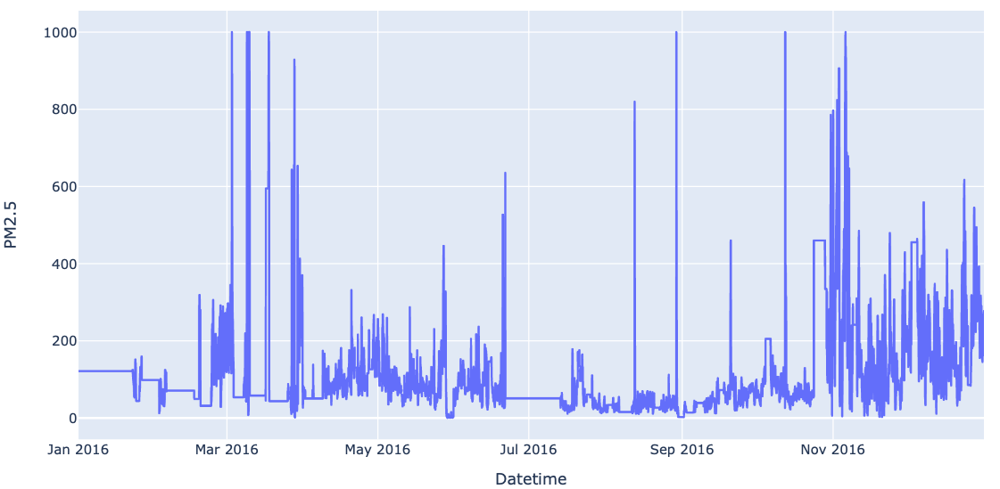

### PM2.5 - 2022

In [276]:
compiled_2022 = compiled[compiled['Year'] == 2022]
compiled_2022
compiled_2022.columns

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
16032,2022-01-01 00:00:00,Vikas Sadan,269.20,346.11,70.77,305.94,16.88,2.23,21.21,4.01,0.0,NaN,NaN,nan,1,1,2022,52,0
16033,2022-01-01 01:00:00,Vikas Sadan,295.80,188.91,58.07,173.53,15.57,1.47,62.39,4.01,0.0,NaN,NaN,nan,1,1,2022,52,1
16034,2022-01-01 02:00:00,Vikas Sadan,279.52,233.19,45.33,202.29,18.98,1.91,8.98,3.99,0.0,NaN,NaN,nan,1,1,2022,52,2
16035,2022-01-01 03:00:00,Vikas Sadan,252.35,167.72,46.35,150.44,10.58,1.28,5.71,3.97,0.0,NaN,NaN,nan,1,1,2022,52,3
16036,2022-01-01 04:00:00,Vikas Sadan,212.05,114.69,45.33,107.49,8.38,1.29,22.10,4.02,0.0,NaN,NaN,nan,1,1,2022,52,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105244,2022-12-31 19:00:00,Teri Gram,85.25,9.74,24.48,20.60,9.14,0.63,10.70,6.40,0.0,172.40,NaN,nan,31,12,2022,52,19
105245,2022-12-31 20:00:00,Teri Gram,83.28,10.68,24.78,21.51,2.45,0.71,11.32,6.46,0.0,141.30,NaN,nan,31,12,2022,52,20
105246,2022-12-31 21:00:00,Teri Gram,80.98,19.30,24.28,28.16,1.88,0.78,10.65,6.43,0.0,155.15,NaN,nan,31,12,2022,52,21
105247,2022-12-31 22:00:00,Teri Gram,84.42,19.52,20.30,26.27,0.76,0.82,10.11,6.49,0.0,164.50,NaN,nan,31,12,2022,52,22


Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'TOT-RF', 'PM10', 'AQI', 'AQI_Bucket', 'Day',
       'Month', 'Year', 'Week', 'Hour'],
      dtype='object')

In [277]:
col = "PM2.5"
px.bar(data_frame = helper_2(compiled_2022.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col + " in 2022"
       )

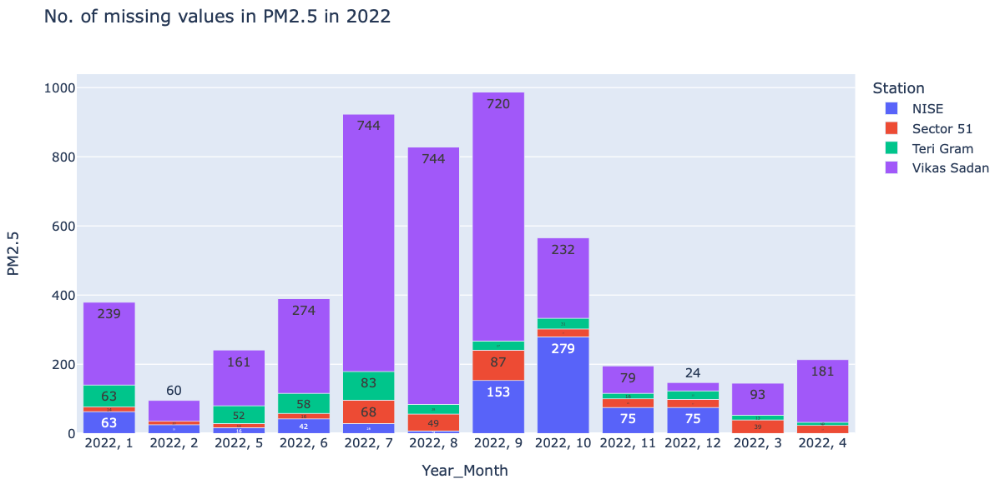

In [279]:
px.line(data_frame=compiled_2022.bfill(), x="Datetime", y="PM2.5", color="Station")

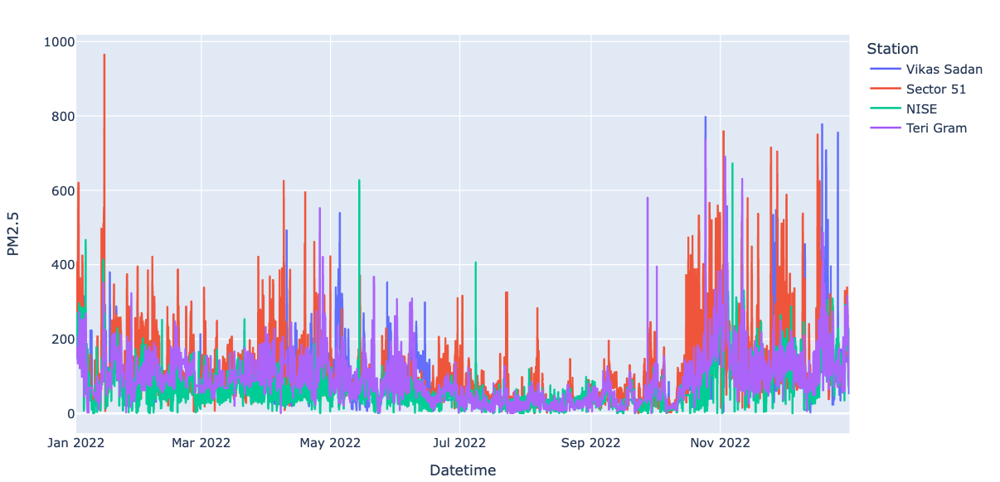

### PM2.5 - 2023

In [280]:
compiled_2023 = compiled[compiled['Year'] == 2023]
compiled_2023
compiled_2023.columns

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
24792,2023-01-01 00:00:00,Vikas Sadan,88.38,12.02,21.48,41.77,3.69,0.92,92.40,2.35,0.0,NaN,NaN,nan,1,1,2023,52,0
24793,2023-01-01 01:00:00,Vikas Sadan,77.93,12.16,22.59,42.79,3.62,1.26,80.43,2.38,0.0,NaN,NaN,nan,1,1,2023,52,1
24794,2023-01-01 02:00:00,Vikas Sadan,78.16,11.55,21.59,39.42,3.73,0.86,132.42,2.25,0.0,NaN,NaN,nan,1,1,2023,52,2
24795,2023-01-01 03:00:00,Vikas Sadan,84.96,11.45,20.96,39.82,3.69,1.28,164.41,2.23,0.0,NaN,NaN,nan,1,1,2023,52,3
24796,2023-01-01 04:00:00,Vikas Sadan,78.38,11.84,21.06,41.66,3.62,0.91,158.67,3.86,0.0,NaN,NaN,nan,1,1,2023,52,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107268,2023-03-26 03:00:00,Teri Gram,64.75,16.85,6.92,17.12,18.19,0.90,NaN,6.65,0.0,266.52,NaN,nan,26,3,2023,12,3
107269,2023-03-26 04:00:00,Teri Gram,88.17,18.63,6.10,18.12,14.92,0.77,23.53,7.52,0.0,285.07,NaN,nan,26,3,2023,12,4
107270,2023-03-26 05:00:00,Teri Gram,116.45,14.24,5.93,14.52,13.69,0.72,23.54,7.92,0.0,278.62,NaN,nan,26,3,2023,12,5
107271,2023-03-26 06:00:00,Teri Gram,105.82,12.70,6.06,13.35,14.45,0.66,23.56,7.39,0.0,266.82,NaN,nan,26,3,2023,12,6


Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'TOT-RF', 'PM10', 'AQI', 'AQI_Bucket', 'Day',
       'Month', 'Year', 'Week', 'Hour'],
      dtype='object')

In [281]:
col = "PM2.5"
px.bar(data_frame = helper_2(compiled_2023.copy(deep=True), col),
       x = "Year_Month",
       y = col,
       color="Station",
       text_auto = True,
       title = "No. of missing values in "+ col + " in 2023"
       )

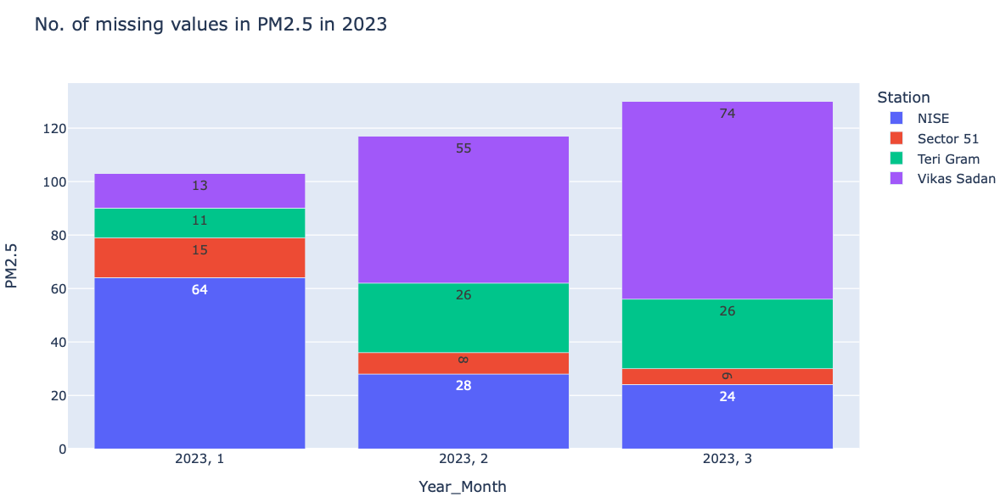

In [282]:
px.line(data_frame=compiled_2023, x="Datetime", y="PM2.5")

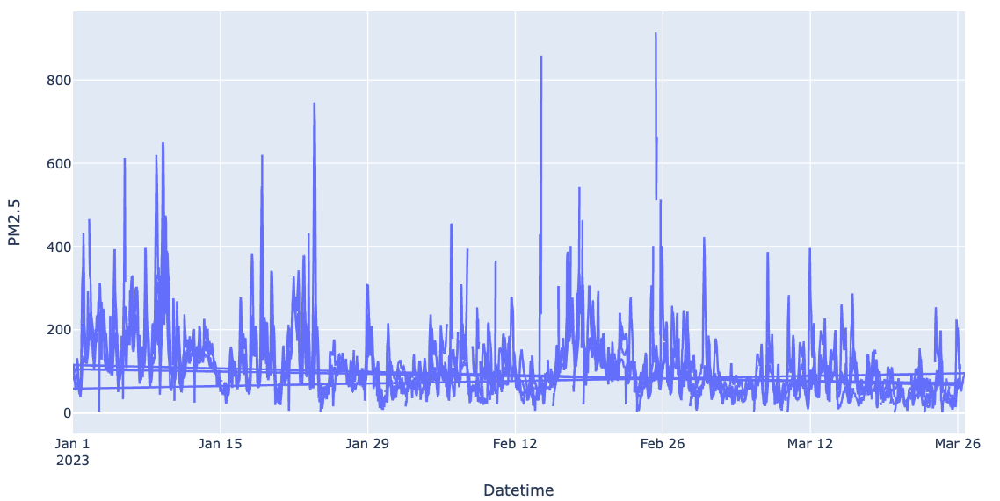

In [283]:
px.line(data_frame=compiled_2023, x="Datetime", y="PM2.5", color="Station")

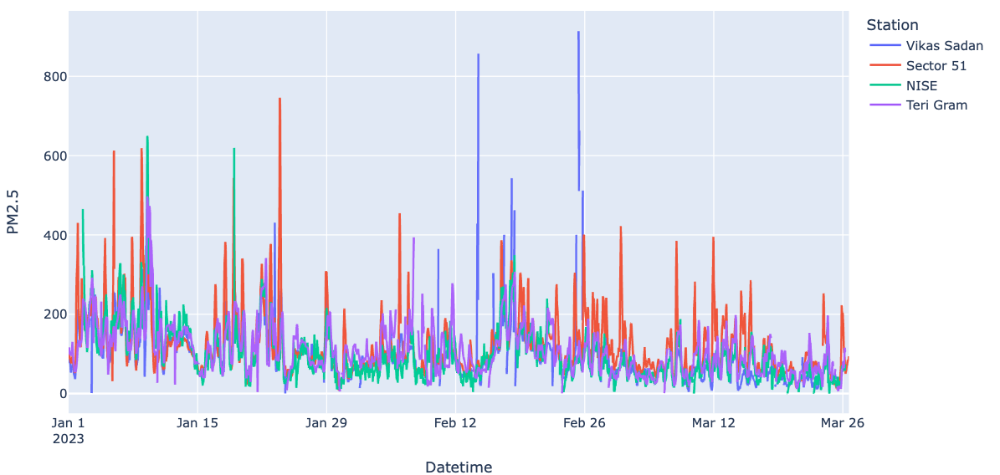

### Filling NA using bfill station wise from Jan 26 to Feb 3 2023

In [284]:
# Jan 26, 2023
compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 1) & (compiled['Day'] == 26) ].sort_values(['Datetime'])
compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 1) & (compiled['Day'] == 26) ].index[0]
# compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 1) & (compiled['Day'] == 26) ]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
25392,2023-01-26 00:00:00,Vikas Sadan,103.59,15.27,32.21,46.12,36.74,0.98,32.42,5.35,0.0,NaN,NaN,nan,26,1,2023,4,0
105849,2023-01-26 00:00:00,Teri Gram,115.95,3.53,5.87,5.90,0.93,0.77,4.46,5.25,0.0,234.93,NaN,nan,26,1,2023,4,0
79033,2023-01-26 00:00:00,NISE,93.06,4.76,20.71,25.47,NaN,1.39,7.72,NaN,0.0,139.57,NaN,nan,26,1,2023,4,0
52208,2023-01-26 00:00:00,Sector 51,104.20,11.84,26.91,23.49,0.68,0.88,8.78,9.56,0.0,192.97,NaN,nan,26,1,2023,4,0
25393,2023-01-26 01:00:00,Vikas Sadan,100.00,15.22,32.13,45.72,33.28,0.84,31.12,5.32,0.0,NaN,NaN,nan,26,1,2023,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25414,2023-01-26 22:00:00,Vikas Sadan,102.85,16.13,27.98,36.57,42.60,1.55,38.95,6.21,0.0,NaN,NaN,nan,26,1,2023,4,22
52231,2023-01-26 23:00:00,Sector 51,112.40,3.66,28.54,17.85,1.29,0.80,28.60,7.65,0.0,208.13,NaN,nan,26,1,2023,4,23
25415,2023-01-26 23:00:00,Vikas Sadan,93.37,16.53,28.34,35.73,36.00,0.88,41.01,6.29,0.0,NaN,NaN,nan,26,1,2023,4,23
79056,2023-01-26 23:00:00,NISE,97.26,3.28,16.56,19.84,NaN,0.82,33.58,NaN,0.0,112.96,NaN,nan,26,1,2023,4,23


25392

In [285]:
# First 30 values

temp = compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 2)].sort_values(['Station', 'Datetime'])
# temp.sample(30)
temp

temp["PM2.5"].isna().sum()
temp["PM2.5"].value_counts(dropna=False)
temp["PM2.5"].value_counts(dropna=False).index[0]
np.nan
temp[temp["PM2.5"] == temp["PM2.5"].value_counts(dropna=False).index[0]]


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
79177,2023-02-01 00:00:00,NISE,100.54,3.61,15.37,18.99,NaN,0.36,22.18,NaN,0.0,138.52,NaN,nan,1,2,2023,5,0
79178,2023-02-01 01:00:00,NISE,69.94,3.63,15.20,18.82,NaN,0.34,25.22,NaN,0.0,122.15,NaN,nan,1,2,2023,5,1
79179,2023-02-01 02:00:00,NISE,61.33,3.57,14.66,18.23,NaN,0.32,26.54,NaN,0.0,112.52,NaN,nan,1,2,2023,5,2
79180,2023-02-01 03:00:00,NISE,79.12,3.39,14.64,18.03,NaN,0.31,27.37,NaN,0.0,94.61,NaN,nan,1,2,2023,5,3
79181,2023-02-01 04:00:00,NISE,45.12,3.50,14.26,17.75,NaN,0.30,30.54,NaN,0.0,79.42,NaN,nan,1,2,2023,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26203,2023-02-28 19:00:00,Vikas Sadan,51.96,17.34,30.16,47.45,23.31,0.09,32.35,8.79,0.0,NaN,NaN,nan,28,2,2023,9,19
26204,2023-02-28 20:00:00,Vikas Sadan,54.99,17.41,30.34,48.42,23.01,0.42,35.43,9.02,0.0,NaN,NaN,nan,28,2,2023,9,20
26205,2023-02-28 21:00:00,Vikas Sadan,51.93,17.23,30.07,47.14,23.61,0.46,35.41,8.72,0.0,NaN,NaN,nan,28,2,2023,9,21
26206,2023-02-28 22:00:00,Vikas Sadan,55.07,17.18,30.21,47.69,26.84,0.39,43.09,8.21,0.0,NaN,NaN,nan,28,2,2023,9,22


117

NaN       117
80.12       3
72.95       3
54.00       3
118.07      3
         ... 
158.20      1
70.17       1
75.07       1
77.30       1
53.45       1
Name: PM2.5, Length: 2335, dtype: int64

nan

nan

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour


In [286]:
temp[temp["PM2.5"].isna()].sort_values(['Station', 'Datetime'])[30:60]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
52476,2023-02-06 04:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,6,2,2023,6,4
52477,2023-02-06 05:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,6,2,2023,6,5
52778,2023-02-18 18:00:00,Sector 51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,18,2,2023,7,18
52799,2023-02-19 15:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,19,2,2023,7,15
52893,2023-02-23 13:00:00,Sector 51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,23,2,2023,8,13
52915,2023-02-24 11:00:00,Sector 51,NaN,0.54,28.55,15.35,2.25,0.55,36.27,NaN,0.0,NaN,NaN,nan,24,2,2023,8,11
106102,2023-02-05 13:00:00,Teri Gram,NaN,4.50,6.59,6.25,14.30,0.56,9.66,4.90,0.0,NaN,NaN,nan,5,2,2023,5,13
106103,2023-02-05 14:00:00,Teri Gram,NaN,4.04,6.47,5.82,14.21,0.52,10.53,8.24,0.0,NaN,NaN,nan,5,2,2023,5,14
106104,2023-02-05 15:00:00,Teri Gram,NaN,3.80,5.76,5.25,14.02,0.47,10.65,1.83,0.0,NaN,NaN,nan,5,2,2023,5,15
106127,2023-02-06 14:00:00,Teri Gram,NaN,3.80,6.22,5.49,15.88,0.56,11.42,4.15,0.0,NaN,NaN,nan,6,2,2023,6,14


In [287]:
temp[temp["PM2.5"].isna()].sort_values(['Station', 'Datetime'])[28:50]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
52474,2023-02-06 02:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,6,2,2023,6,2
52475,2023-02-06 03:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,6,2,2023,6,3
52476,2023-02-06 04:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,6,2,2023,6,4
52477,2023-02-06 05:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,6,2,2023,6,5
52778,2023-02-18 18:00:00,Sector 51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,18,2,2023,7,18
52799,2023-02-19 15:00:00,Sector 51,NaN,NaN,NaN,0.00,NaN,0.00,NaN,0.00,0.0,NaN,NaN,nan,19,2,2023,7,15
52893,2023-02-23 13:00:00,Sector 51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,23,2,2023,8,13
52915,2023-02-24 11:00:00,Sector 51,NaN,0.54,28.55,15.35,2.25,0.55,36.27,NaN,0.0,NaN,NaN,nan,24,2,2023,8,11
106102,2023-02-05 13:00:00,Teri Gram,NaN,4.50,6.59,6.25,14.30,0.56,9.66,4.90,0.0,NaN,NaN,nan,5,2,2023,5,13
106103,2023-02-05 14:00:00,Teri Gram,NaN,4.04,6.47,5.82,14.21,0.52,10.53,8.24,0.0,NaN,NaN,nan,5,2,2023,5,14


In [288]:
temp[temp["PM2.5"].isna()].sort_values(['Datetime'])['Station'].unique()

array(['Vikas Sadan', 'Teri Gram', 'Sector 51', 'NISE'], dtype=object)

In [289]:
temp[temp["PM2.5"].isna()].sample(30)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
25927,2023-02-17 07:00:00,Vikas Sadan,NaN,16.24,30.36,47.46,8.88,1.62,35.78,8.22,0.0,NaN,NaN,nan,17,2,2023,7,7
106151,2023-02-07 14:00:00,Teri Gram,NaN,5.92,5.63,6.89,10.39,0.59,10.20,4.15,0.0,NaN,NaN,nan,7,2,2023,6,14
79686,2023-02-22 05:00:00,NISE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,22,2,2023,8,5
79703,2023-02-22 22:00:00,NISE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,22,2,2023,8,22
79705,2023-02-23 00:00:00,NISE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,23,2,2023,8,0
106341,2023-02-15 12:00:00,Teri Gram,NaN,0.58,2.83,3.36,NaN,0.52,22.53,4.18,0.0,NaN,NaN,nan,15,2,2023,7,12
79692,2023-02-22 11:00:00,NISE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,nan,22,2,2023,8,11
106152,2023-02-07 15:00:00,Teri Gram,NaN,5.16,5.38,6.14,10.42,0.51,9.97,4.15,0.0,NaN,NaN,nan,7,2,2023,6,15
106176,2023-02-08 15:00:00,Teri Gram,NaN,3.63,5.81,5.15,14.77,0.39,11.22,4.19,0.0,NaN,NaN,nan,8,2,2023,6,15
106365,2023-02-16 12:00:00,Teri Gram,NaN,11.92,20.57,20.31,3.39,0.85,21.64,4.19,0.0,NaN,NaN,nan,16,2,2023,7,12


In [290]:
temp.loc[26132,"PM2.5"]
repr(temp.loc[26132,"PM2.5"])
temp.loc[26132,"PM2.5"].dtype
repr(temp.loc[26132,"PM2.5"]) == repr(np.nan) #WORKS :))

nan

'nan'

dtype('float64')

True

In [291]:
# Feb 3, 2023
compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 2) & (compiled['Day'] == 3) ].sort_values(['Datetime'])
compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 2) & (compiled['Day'] == 3) ].index[0]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
25584,2023-02-03 00:00:00,Vikas Sadan,86.95,16.23,30.24,46.24,7.31,0.56,41.89,6.21,0.0,NaN,NaN,nan,3,2,2023,5,0
106041,2023-02-03 00:00:00,Teri Gram,80.95,2.62,5.83,4.34,11.91,0.50,10.04,7.83,0.0,170.60,NaN,nan,3,2,2023,5,0
79225,2023-02-03 00:00:00,NISE,30.90,3.03,16.80,19.83,NaN,0.37,49.79,NaN,0.0,101.29,NaN,nan,3,2,2023,5,0
52400,2023-02-03 00:00:00,Sector 51,108.62,7.36,33.23,23.30,3.68,0.84,8.70,7.97,0.0,201.08,NaN,nan,3,2,2023,5,0
25585,2023-02-03 01:00:00,Vikas Sadan,81.08,16.26,30.38,47.88,7.29,1.11,43.15,6.24,0.0,NaN,NaN,nan,3,2,2023,5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25606,2023-02-03 22:00:00,Vikas Sadan,140.44,17.19,29.73,46.95,7.15,2.71,52.98,8.41,0.0,NaN,NaN,nan,3,2,2023,5,22
52423,2023-02-03 23:00:00,Sector 51,236.10,64.89,36.20,70.95,4.13,1.81,30.13,13.24,0.0,437.00,NaN,nan,3,2,2023,5,23
25607,2023-02-03 23:00:00,Vikas Sadan,162.26,17.28,31.10,47.32,7.24,0.46,47.87,8.45,0.0,NaN,NaN,nan,3,2,2023,5,23
79248,2023-02-03 23:00:00,NISE,111.26,8.54,24.21,32.76,NaN,1.02,0.47,NaN,0.0,170.73,NaN,nan,3,2,2023,5,23


25584

In [292]:
compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 1) ].sort_values(['Datetime'])[30:60]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
51615,2023-01-01 07:00:00,Sector 51,77.25,16.01,25.52,26.17,2.35,0.79,26.56,3.57,0.0,143.10,NaN,nan,1,1,2023,52,7
105256,2023-01-01 07:00:00,Teri Gram,100.80,67.78,10.93,60.07,17.85,0.89,10.02,7.19,0.0,177.35,NaN,nan,1,1,2023,52,7
78441,2023-01-01 08:00:00,NISE,NaN,9.50,27.94,37.42,NaN,0.48,3.74,NaN,0.0,111.33,NaN,nan,1,1,2023,52,8
51616,2023-01-01 08:00:00,Sector 51,80.80,17.08,28.54,28.61,5.07,0.81,21.85,3.35,0.0,149.65,NaN,nan,1,1,2023,52,8
24800,2023-01-01 08:00:00,Vikas Sadan,64.77,23.43,20.35,63.06,5.09,0.98,10.39,6.19,0.0,NaN,NaN,nan,1,1,2023,52,8
105257,2023-01-01 08:00:00,Teri Gram,107.53,59.19,11.26,53.35,19.51,0.84,9.79,6.12,0.0,166.65,NaN,nan,1,1,2023,52,8
78442,2023-01-01 09:00:00,NISE,NaN,12.78,41.89,54.68,NaN,0.57,9.32,NaN,0.0,157.17,NaN,nan,1,1,2023,52,9
51617,2023-01-01 09:00:00,Sector 51,94.38,14.58,29.90,26.79,6.28,0.84,29.81,3.52,0.0,174.75,NaN,nan,1,1,2023,52,9
24801,2023-01-01 09:00:00,Vikas Sadan,64.72,23.49,20.36,61.99,5.18,1.10,12.76,6.20,0.0,NaN,NaN,nan,1,1,2023,52,9
105258,2023-01-01 09:00:00,Teri Gram,109.80,52.21,17.31,50.91,19.93,0.85,10.44,6.12,0.0,215.48,NaN,nan,1,1,2023,52,9


In [293]:
compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 2) & (compiled['Day'] == 3) ].sort_values(['Station','Datetime'])[60:]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
106053,2023-02-03 12:00:00,Teri Gram,102.30,5.94,7.27,7.76,8.53,0.60,9.52,6.33,0.0,237.47,NaN,nan,3,2,2023,5,12
106054,2023-02-03 13:00:00,Teri Gram,94.72,5.11,6.92,6.91,8.06,0.57,10.24,6.01,0.0,198.47,NaN,nan,3,2,2023,5,13
106055,2023-02-03 14:00:00,Teri Gram,85.47,4.54,6.78,6.37,7.75,0.54,11.19,5.90,0.0,160.55,NaN,nan,3,2,2023,5,14
106056,2023-02-03 15:00:00,Teri Gram,82.08,3.42,6.23,5.19,7.76,0.47,10.77,5.57,0.0,169.12,NaN,nan,3,2,2023,5,15
106057,2023-02-03 16:00:00,Teri Gram,69.75,2.67,6.71,4.84,4.23,0.47,10.64,4.63,0.0,142.28,NaN,nan,3,2,2023,5,16
106058,2023-02-03 17:00:00,Teri Gram,70.28,2.44,6.46,4.53,3.95,0.48,10.59,4.55,0.0,150.72,NaN,nan,3,2,2023,5,17
106059,2023-02-03 18:00:00,Teri Gram,65.42,2.49,6.99,4.85,3.79,0.52,10.52,4.60,0.0,152.35,NaN,nan,3,2,2023,5,18
106060,2023-02-03 19:00:00,Teri Gram,59.05,5.21,7.37,7.23,3.90,0.83,10.24,4.63,0.0,192.07,NaN,nan,3,2,2023,5,19
106061,2023-02-03 20:00:00,Teri Gram,92.05,8.38,7.58,9.88,9.08,0.98,9.86,4.96,0.0,327.65,NaN,nan,3,2,2023,5,20
106062,2023-02-03 21:00:00,Teri Gram,152.22,9.56,6.95,10.50,9.64,1.00,10.09,5.24,0.0,409.85,NaN,nan,3,2,2023,5,21


In [294]:
x = compiled[ (compiled['Year'] == 2023) & (compiled['Month'] == 2) & (compiled['Day'] == 28) ].sort_values(['Station','Datetime'])
x[x["PM2.5"].isna()]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
106653,2023-02-28 12:00:00,Teri Gram,NaN,13.89,14.05,18.48,NaN,0.69,25.67,7.29,0.0,NaN,NaN,nan,28,2,2023,9,12
106654,2023-02-28 13:00:00,Teri Gram,NaN,11.56,11.07,15.05,0.47,0.61,24.63,6.61,0.0,163.05,NaN,nan,28,2,2023,9,13
26195,2023-02-28 11:00:00,Vikas Sadan,NaN,47.67,41.16,55.93,16.76,1.81,65.62,5.72,0.0,NaN,NaN,nan,28,2,2023,9,11
26196,2023-02-28 12:00:00,Vikas Sadan,NaN,17.35,30.27,47.43,11.85,4.93,49.60,5.79,0.0,NaN,NaN,nan,28,2,2023,9,12


In [295]:
y = x[40:80]
y["PM2.5"].bfill(inplace=True)
y

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17432/2576939870.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53016,2023-02-28 16:00:00,Sector 51,96.70,4.20,28.10,16.45,3.08,0.54,57.37,10.99,0.0,179.10,NaN,nan,28,2,2023,9,16
53017,2023-02-28 17:00:00,Sector 51,105.72,5.09,28.89,17.58,3.25,0.50,29.73,10.50,0.0,195.72,NaN,nan,28,2,2023,9,17
53018,2023-02-28 18:00:00,Sector 51,96.40,5.52,30.57,18.60,3.16,0.49,27.86,9.73,0.0,178.55,NaN,nan,28,2,2023,9,18
53019,2023-02-28 19:00:00,Sector 51,104.45,5.97,30.49,19.12,3.22,0.50,29.91,9.54,0.0,193.52,NaN,nan,28,2,2023,9,19
53020,2023-02-28 20:00:00,Sector 51,106.23,7.82,29.36,20.00,1.96,0.51,28.52,10.04,0.0,196.75,NaN,nan,28,2,2023,9,20
53021,2023-02-28 21:00:00,Sector 51,115.35,11.02,28.66,21.80,1.80,0.55,25.37,9.88,0.0,213.65,NaN,nan,28,2,2023,9,21
53022,2023-02-28 22:00:00,Sector 51,138.03,12.84,28.09,23.37,1.64,0.56,24.53,9.54,0.0,255.60,NaN,nan,28,2,2023,9,22
53023,2023-02-28 23:00:00,Sector 51,137.13,13.54,27.78,23.76,1.83,0.57,22.37,8.98,0.0,253.93,NaN,nan,28,2,2023,9,23
106641,2023-02-28 00:00:00,Teri Gram,103.27,21.74,11.94,23.67,7.78,0.85,24.69,9.91,0.0,283.30,NaN,nan,28,2,2023,9,0
106642,2023-02-28 01:00:00,Teri Gram,99.43,22.47,10.53,23.52,8.42,0.86,25.83,10.87,0.0,248.38,NaN,nan,28,2,2023,9,1


## 17th April - Filling NaN

In [296]:
compiled_ffill = compiled.copy()
compiled_ffill.sort_values(['Station','Datetime'], inplace=True)
compiled_ffill.columns
# compiled_ffill.ffill(inplace=True)
compiled_ffill.isna().sum()
compiled_ffill.shape

Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'TOT-RF', 'PM10', 'AQI', 'AQI_Bucket', 'Day',
       'Month', 'Year', 'Week', 'Hour'],
      dtype='object')

Datetime           0
Station            0
PM2.5          17257
NO             17443
NO2            15918
NOx            20315
SO2            43996
CO             12704
Ozone          49599
Benzene        55514
TOT-RF         40258
PM10           56362
AQI           114111
AQI_Bucket         0
Day                0
Month              0
Year               0
Week               0
Hour               0
dtype: int64

(147531, 19)

- Important features [['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO', 'PM10']] 
### Missing value imputation strategy (based on % of missing values by station.png )
- PM2.5
    - Station-wise do bfill or ffill
- NO
    - Station-wise do bfill or ffill
- NO2
    - Station-wise do bfill or ffill
- NOx
    - Station-wise do bfill or ffill
- SO2
    - Except NISE, do station-wise bfill or ffill
    - Now, for NISE, take average of other stations on that day and impute. (Dont impute mean of all values in the column, for each day, wherever there is missing SO2, go to other stations on that day and take average.)
    - To do this, first check with other columns if NISE is avg of other stations. (Checked it, works)
    - If average of other 3 stations does not work, then take all non-NaNs in SO2, check with collinearity with other stations, whichever has high correlation, take that station.
- CO
    - Station-wise do bfill or ffill
- PM10
    - Except No Station & Vikas Sadan, do station-wise bfill or ffill
    - Follow similar approach like SO2.

In [297]:
px.line(data_frame=compiled_ffill, x="Datetime", y="PM2.5")

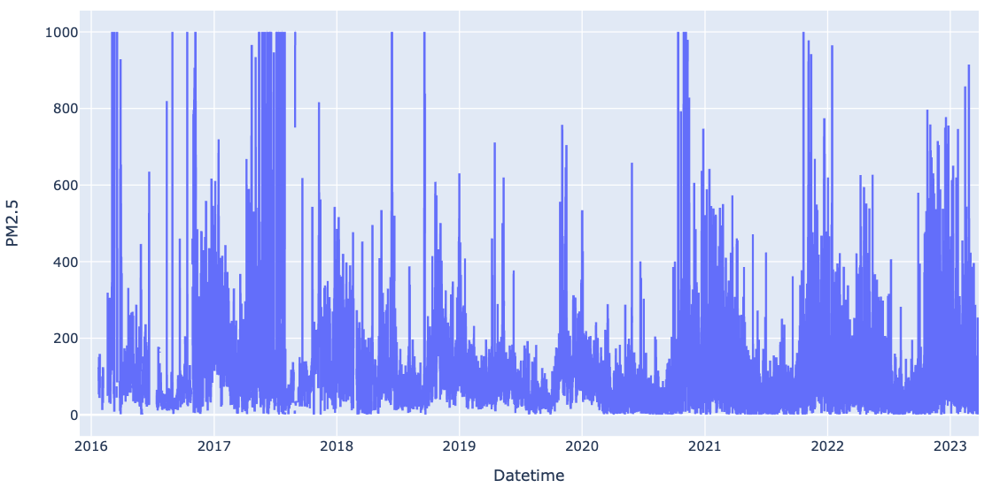

In [298]:
# compiled_ffill
compiled_ffill["PM2.5"].ffill(inplace=True)
px.line(data_frame=compiled_ffill, x="Datetime", y="PM2.5")

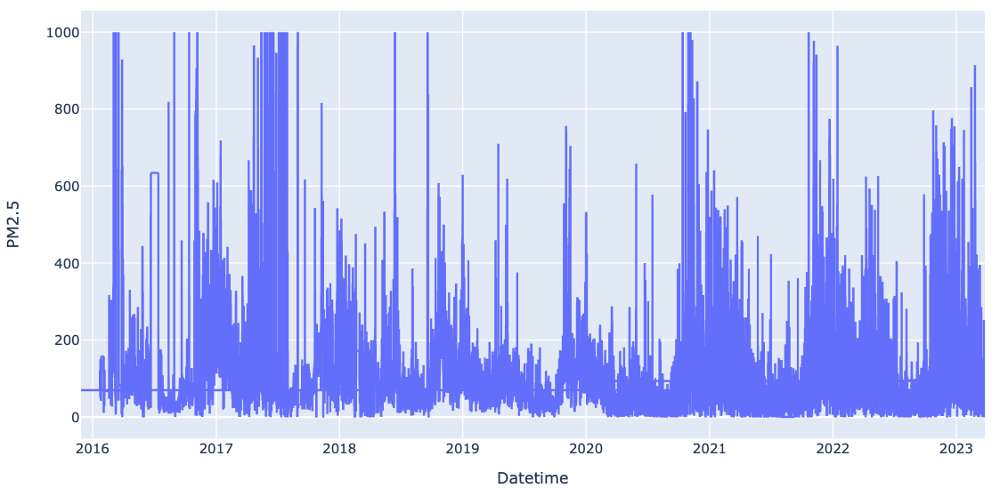

In [239]:
plt.close()

In [299]:
# Find a row where all columns are not missing
compiled[~compiled.isnull().any(axis=1)]
# none

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour


In [300]:
compiled_ffill["NO"].ffill(inplace=True)
compiled_ffill["NO2"].ffill(inplace=True)
compiled_ffill["NOx"].ffill(inplace=True)
compiled_ffill["CO"].ffill(inplace=True)

In [301]:
(compiled_ffill['Station'] != 'NISE').sum()
(compiled_ffill['Station'] == 'NISE').sum()

120715

26816

In [302]:
compiled_ffill[compiled_ffill['Station'] != 'NISE']

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,71.08,8.88,12.50,5.85,NaN,0.08,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,71.08,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,71.08,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,71.08,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,71.08,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,nan,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,nan,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,nan,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,nan,26,3,2023,12,6


In [303]:
# Both 1st row and last row are NaNs so bfill and ffill has issue

compiled_ffill.loc[26815,"SO2"] = compiled_ffill.loc[26814,"SO2"]
compiled_ffill.loc[26815,"SO2"] 

39.29

In [304]:
compiled_ffill.loc[107273,"SO2"] = compiled_ffill.loc[107274,"SO2"]

In [305]:
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"]

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

In [306]:
compiled_ffill[compiled_ffill['SO2'].isnull()]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,nan,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,nan,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,nan,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,nan,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,nan,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26774,2023-03-24 14:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,nan,24,3,2023,12,14
26775,2023-03-24 15:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,nan,24,3,2023,12,15
26776,2023-03-24 16:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,nan,24,3,2023,12,16
26777,2023-03-24 17:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,nan,24,3,2023,12,17


In [307]:
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',:]
# .bfill(inplace=True)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,71.08,8.88,12.50,5.85,8.38,0.08,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,71.08,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,71.08,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,71.08,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,71.08,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,nan,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,nan,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,nan,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,nan,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,nan,26,3,2023,12,6


In [308]:
# compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"] = compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"].bfill(inplace=True)
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"]
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"].bfill()

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64